# T cells analysis
## Xiaonan Wang
## 07Aug2020

Analysis of 6 CAR T-cell samples:
- C4: Unsti
- D4: Unsti
- E4: Unsti
- F4: Sti
- G4: Sti
- H4: Sti

In [1]:
#%matplotlib nbagg
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
import pandas as pd
import anndata
import smqpp
import re
import seaborn as sns
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)

from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap.from_list(name='gene_cmap', colors=['lightgrey', 'thistle', 'red', 'darkred']) 

sc.settings.set_figure_params(dpi=80, color_map='viridis', vector_friendly=False,  dpi_save=300)
sc.logging.print_versions()

/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


scanpy==1.5.0 anndata==0.7.1 numpy==1.18.2 scipy==1.4.1 pandas==1.0.3 scikit-learn==0.22.2.post1 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1 leidenalg==0.7.0


In [ ]:
import sys
sys.path.append('./source_code/')
from CarT_source_code import *

In [2]:
print(sns.__version__)
print(smqpp.__version__)

0.10.0
0.1.1


# Read in Files

In [2]:
h5_dir = '/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Lab_Members/Fernando/Autolus_paper/Fernando_TenX_SLX_11472_SLX_12473/SLX_12473_combined/fastq/'
fn = ['C4', 'D4', 'E4', 'F4', 'G4', 'H4']
Donor = ['Donor1', 'Donor2', 'Donor3', 'Donor1', 'Donor2', 'Donor3']
Condition = ['Unstimulated', 'Unstimulated', 'Unstimulated', 'Stimulated', 'Stimulated', 'Stimulated']

In [5]:
adata = []
for fidx in range(len(fn)):
    adata.append(ReadinFiles_Tcells(h5_dir, fn[fidx], Donor[fidx], Condition[fidx]))

... writing an h5ad cache file to speedup reading next time


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... writing an h5ad cache file to speedup reading next time


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... writing an h5ad cache file to speedup reading next time


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... writing an h5ad cache file to speedup reading next time


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... writing an h5ad cache file to speedup reading next time


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... writing an h5ad cache file to speedup reading next time


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [6]:
# Combine data sets
adata = anndata.AnnData.concatenate(*adata)

In [7]:
print(adata.shape)
print(adata.obs['batch'].value_counts().sort_index())

(40523, 32738)
0    5853
1    6115
2    6874
3    7212
4    7371
5    7098
Name: batch, dtype: int64


In [9]:
adata.obs['Sample'] = adata.obs['Condition'].astype(str)+'_'+adata.obs['Donor'].astype(str)
adata.obs['Sample'] = adata.obs['Sample'].astype('category')
adata.obs['Sample'].cat.categories

Index(['Stimulate_Donor3', 'Stimulated_Donor1', 'Stimulated_Donor2',
       'Unstimulated_Donor1', 'Unstimulated_Donor2', 'Unstimulated_Donor3'],
      dtype='object')

In [10]:
adata.obs['Sample'] = adata.obs['Sample'].cat.rename_categories(['Sti3', 'Sti1', 'Sti2', 'Unsti1', 'Unsti2', 'Unsti3'])
adata.obs['Sample'] = adata.obs['Sample'].cat.reorder_categories(['Unsti1', 'Unsti2', 'Unsti3', 'Sti1', 'Sti2', 'Sti3'])

# Quality Control

normalizing counts per cell
    finished (0:00:01)


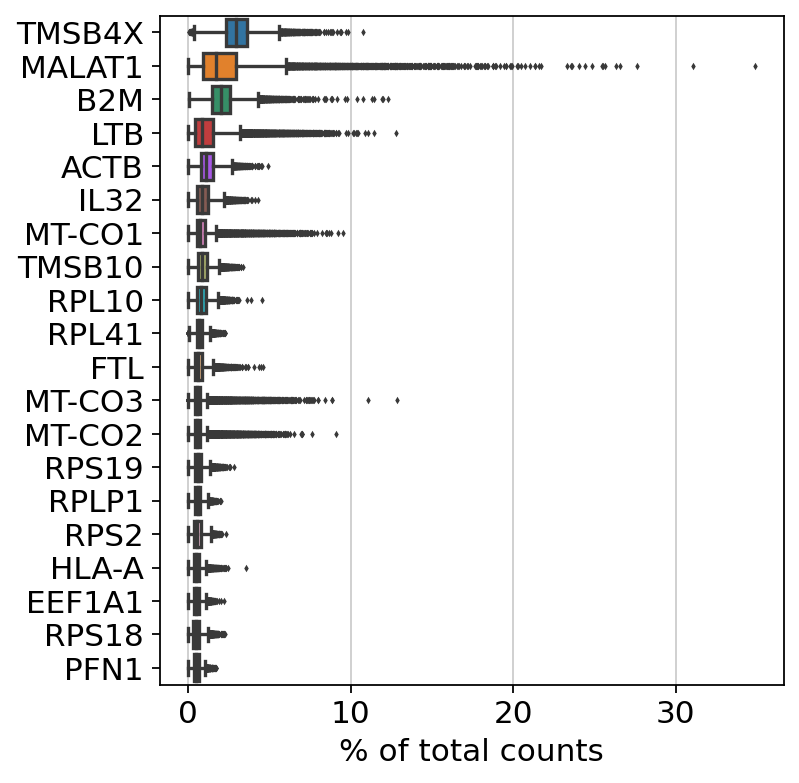

In [15]:
# looks fine here as expected
# All ribosomal protein genes and house keeping genes
sc.pl.highest_expr_genes(adata, n_top=20)

In [16]:
adata.var['mt'] = adata.var_names.str.startswith('MT-') 

In [17]:
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

In [18]:
adata.obs.head(3)

,Barcode,Condition,Donor,Vector,batch,Sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt
AAACCTGAGATCCTGT-1-0,AAACCTGAGATCCTGT-1,Unstimulated,Donor1,0.0,0,Unsti1,2213,7.702556,8039.0,8.992185,39.084463,51.984078,62.370942,74.822739,339.0,5.828946,4.216943
AAACCTGAGCTGCGAA-1-0,AAACCTGAGCTGCGAA-1,Unstimulated,Donor1,2.0,0,Unsti1,2136,7.667158,7070.0,8.863757,35.176803,46.859972,57.637907,72.008487,210.0,5.351858,2.970297
AAACCTGAGGGAGTAA-1-0,AAACCTGAGGGAGTAA-1,Unstimulated,Donor1,2.0,0,Unsti1,1982,7.592366,6354.0,8.756997,38.196412,47.025496,57.286749,72.348127,213.0,5.365976,3.352219


In [19]:
adata.var.head(3)

,Ensembl Name,Gene Name,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
MIR1302-10,ENSG00000243485,MIR1302-10,False,0,0.0,0.0,100.0,0.0,0.0
FAM138A,ENSG00000237613,FAM138A,False,0,0.0,0.0,100.0,0.0,0.0
OR4F5,ENSG00000186092,OR4F5,False,0,0.0,0.0,100.0,0.0,0.0


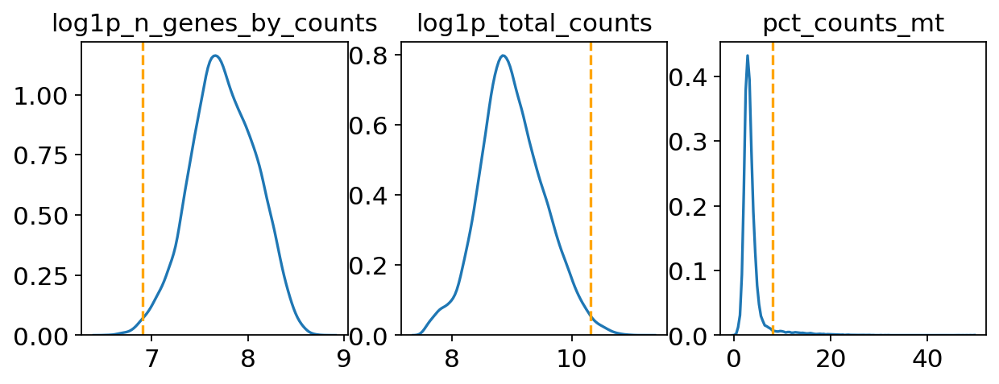

In [26]:
fig,ax = plt.subplots(1,3, figsize=(9,3))
sns.kdeplot(adata.obs['log1p_n_genes_by_counts'], ax=ax[0])
ax[0].grid(False)
ax[0].get_legend().remove()
ax[0].set_title('log1p_n_genes_by_counts')
ax[0].axvline(np.log1p(1000), c='orange', linestyle='--')
sns.kdeplot(adata.obs['log1p_total_counts'], ax=ax[1])
ax[1].grid(False)
ax[1].get_legend().remove()
ax[1].set_title('log1p_total_counts')
ax[1].axvline(np.log1p(30000), c='orange', linestyle='--')
sns.kdeplot(adata.obs['pct_counts_mt'], ax=ax[2])
ax[2].grid(False)
ax[2].get_legend().remove()
ax[2].set_title('pct_counts_mt')
ax[2].axvline(8, c='orange', linestyle='--')

In [27]:
# filter cells and genes here based on user preference
sc.pp.filter_cells(adata, min_genes=1000)
sc.pp.filter_genes(adata, min_cells=1)

filtered out 282 cells that have less than 1000 genes expressed
filtered out 10937 genes that are detected in less than 1 cells


In [28]:
print(adata.shape)
print(adata.obs['Sample'].value_counts().sort_index())

(40241, 21801)
Unsti1    5686
Unsti2    6101
Unsti3    6841
Sti1      7150
Sti2      7370
Sti3      7093
Name: Sample, dtype: int64


In [29]:
# further QC with high mit percentage and n_counts
adata = adata[(adata.obs['pct_counts_mt'] < 8) & (adata.obs['total_counts'] <= 30000), :].copy()

In [30]:
print(adata.shape)
print(adata.obs['Sample'].value_counts().sort_index())

(37898, 21801)
Unsti1    5223
Unsti2    5305
Unsti3    6635
Sti1      6937
Sti2      7037
Sti3      6761
Name: Sample, dtype: int64


In [31]:
adata.write('./write/Tcells_raw_afterQC.h5ad')

... storing 'Barcode' as categorical
... storing 'Condition' as categorical
... storing 'Donor' as categorical
... storing 'Gene Name' as categorical


# Normalisation

In [32]:
# normalisation
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [33]:
# log counts
sc.pp.log1p(adata)

In [34]:
adata.raw = adata

In [35]:
adata.write('./write/Tcells_lognorm_afterQC.h5ad')

# Cell Cycle Assignment

In [3]:
adata = sc.read('./write/Tcells_lognorm_afterQC.h5ad')

In [4]:
# Scaling must be done before scoring
sc.pp.scale(adata)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [38]:
cell_cycle_genes = [x.strip().title() for x in open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/regev_lab_cell_cycle_genes.txt')]
print(len(cell_cycle_genes))
cell_cycle_genes = [x.upper() for x in cell_cycle_genes]

97


In [39]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
print('Number of s_genes: '+str(len(s_genes)))
print('Number of g2m_genes: '+str(len(g2m_genes)))
print('Total number of cell cycle genes: '+str(len(cell_cycle_genes)))

Number of s_genes: 43
Number of g2m_genes: 54
Total number of cell cycle genes: 97


In [40]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes, use_raw=False)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    557 total control genes are used. (0:00:10)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    812 total control genes are used. (0:00:06)
-->     'phase', cell cycle phase (adata.obs)


In [41]:
adata.obs['phase'].value_counts().sort_index()

G1     21543
G2M     6693
S       9662
Name: phase, dtype: int64

In [42]:
# save cell cycle assignments
adata.obs[['phase', 'S_score', 'G2M_score']].to_csv('Tcells_cell_cycle_results.txt')

# Select Highly Variable Genes

In [63]:
adata = sc.read('./write/Tcells_lognorm_afterQC.h5ad')

In [64]:
cell_cycle_results = pd.read_csv('Tcells_cell_cycle_results.txt', index_col=0)
adata.obs = pd.concat([adata.obs, cell_cycle_results], axis=1)

In [13]:
RPscore = pd.read_csv('Tcells_RPscore.csv', index_col=0)
adata.obs['RPscore'] = RPscore

In [46]:
adata.obs.head(3)

,Barcode,Condition,Donor,Vector,batch,Sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,...,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_genes,n_counts,phase,S_score,G2M_score
AAACCTGAGATCCTGT-1-0,AAACCTGAGATCCTGT-1,Unstimulated,Donor1,0.0,0,Unsti1,2213,7.702556,8039.0,8.992185,...,62.370942,74.822739,339.0,5.828946,4.216943,2213,8039.0,G1,-0.453926,-0.412195
AAACCTGAGCTGCGAA-1-0,AAACCTGAGCTGCGAA-1,Unstimulated,Donor1,2.0,0,Unsti1,2136,7.667158,7070.0,8.863757,...,57.637907,72.008487,210.0,5.351858,2.970297,2136,7070.0,G1,-0.377568,-0.254620
AAACCTGAGGGAGTAA-1-0,AAACCTGAGGGAGTAA-1,Unstimulated,Donor1,2.0,0,Unsti1,1982,7.592366,6354.0,8.756997,...,57.286749,72.348127,213.0,5.365976,3.352219,1982,6354.0,G1,-0.314517,-0.188438


In [66]:
# find highly variable genes
# parameters are mainly selected depends on user preference
sc.pp.highly_variable_genes(
    adata, min_mean=0.02, max_mean=3, min_disp=0.5, batch_key='batch', inplace=True)

extracting highly variable genes


... storing 'phase' as categorical


    finished (0:00:50)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


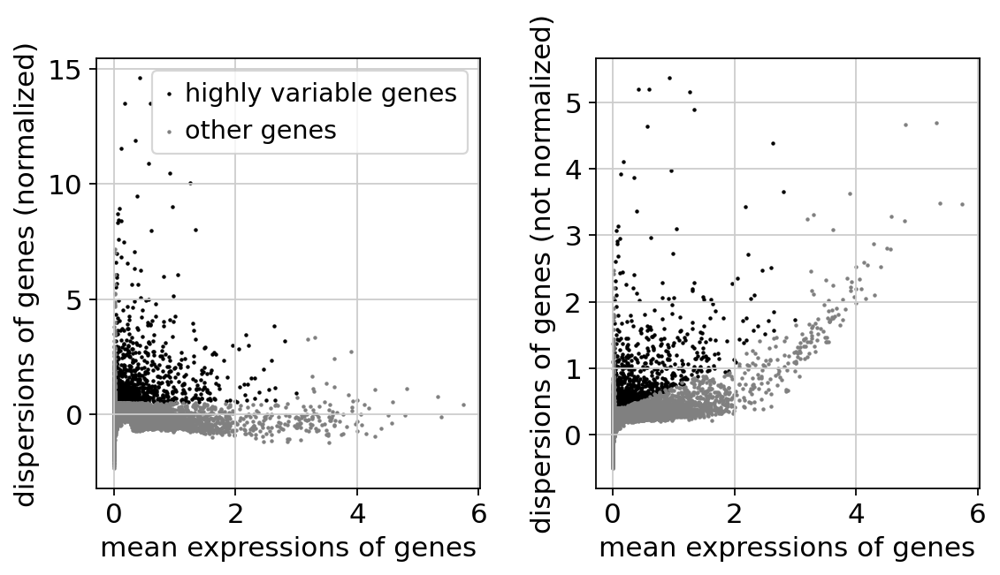

In [67]:
sc.pl.highly_variable_genes(adata)

In [68]:
print(np.sum(adata.var.highly_variable))

1104


In [69]:
adata = adata[:, adata.var.highly_variable]

In [70]:
adata.shape

(37898, 1104)

In [71]:
adata.write('./write/Tcells_lognorm_HVG_afterQC.h5ad')

In [52]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:29)


In [53]:
# scale for pca
sc.pp.scale(adata)

In [54]:
print(adata.shape)
print(adata.obs['Sample'].value_counts().sort_index())

(37898, 1104)
Unsti1    5223
Unsti2    5305
Unsti3    6635
Sti1      6937
Sti2      7037
Sti3      6761
Name: Sample, dtype: int64


# Visualisation

In [55]:
# first try pca
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)


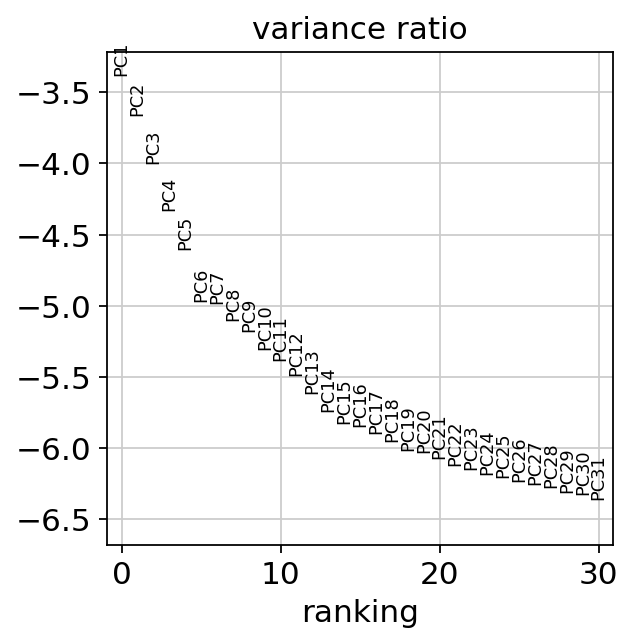

In [56]:
sc.pl.pca_variance_ratio(adata, log=True)

In [57]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.tsne(adata)
sc.tl.draw_graph(adata)
sc.tl.diffmap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:27)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:01)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:05:49)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:07:56)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.98618925 0.98250425 0.975684   0.973366   0.9639171
     0.9553574  0.94837785 0.9436988  0.9323904  0.93063706 0.927227
     0.9233722  0.9219085  0.918202  ]
    finished: added
    'X_diffmap', diffmap coordinates (a

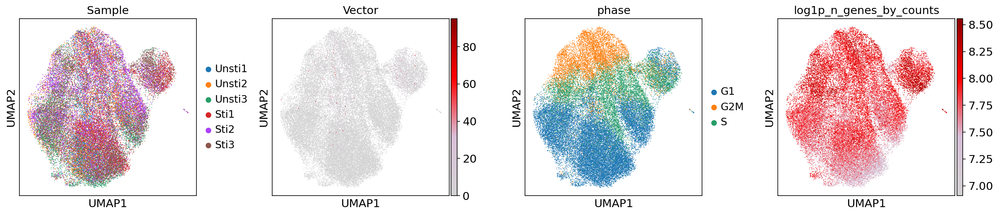

In [60]:
sc.pl.umap(adata, color=['Sample','Vector', 'phase', 'log1p_n_genes_by_counts'], color_map=cmap, wspace=0.3)

In [61]:
adata.shape

(37898, 1104)

In [62]:
adata.write('./write/Tcells_processed.h5ad')

# Regress out cell cycle as well

In [148]:
adata = sc.read('./write/Tcells_lognorm_HVG_afterQC.h5ad')

In [149]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt', 'G2M_score', 'S_score', 'n_genes_by_counts'])

regressing out ['total_counts', 'pct_counts_mt', 'G2M_score', 'S_score', 'n_genes_by_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:39)


In [150]:
# scale for pca
sc.pp.scale(adata)

In [151]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.tsne(adata)
sc.tl.draw_graph(adata)
sc.tl.diffmap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:15)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:02)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:05:59)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:08:10)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.98415035 0.97510934 0.9729096  0.9610384  0.9466358
     0.9377177  0.933583   0.9300114  0.9230972  0.92081255 0.9190596
     0.9181

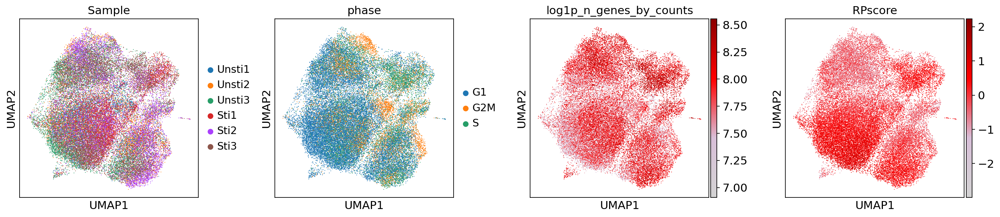

In [14]:
sc.pl.umap(adata, color=['Sample', 'phase', 'log1p_n_genes_by_counts', 'RPscore'], color_map=cmap, wspace=0.3)

In [153]:
adata.obs['logVector'] = np.log1p(adata.obs['Vector'])

In [ ]:
adata.obs['Vec_binary'] = adata.obs['Vector'].values > 0
adata.obs['Vec_binary'] = adata.obs['Vec_binary'].astype('category')
adata.obs['Vec_binary'].cat.categories
adata.obs['Vec_binary'] = adata.obs['Vec_binary'].cat.rename_categories(['Vec-', 'Vec+'])
adata.uns['Vec_binary_colors'] = ['#d3d3d3', '#FF0000']

In [154]:
cd48ratio = (adata.raw[:,'CD4'].X.toarray().flatten()+0.1)/(np.mean(adata.raw[:,['CD8A','CD8B']].X.toarray(),axis=1)+0.1)
cd48ratio = np.log2(cd48ratio)
cd48ratio[cd48ratio > 1] = 1
cd48ratio[cd48ratio < -1] = -1
adata.obs['CD4/CD8'] = cd48ratio

In [4]:
adata.obs['CD8_Assign'] = np.mean(adata.raw[:, ['CD8A', 'CD8B']].X.toarray(), axis=1) > 0
adata.obs['CD8_Assign'] = adata.obs['CD8_Assign'].astype('category')

In [5]:
adata.obs['CD8_Assign'].cat.categories

Index([False, True], dtype='object')

In [7]:
adata.obs['CD8_Assign'] = adata.obs['CD8_Assign'].cat.rename_categories(['CD8-', 'CD8+'])
adata.obs['CD8_Assign'] = adata.obs['CD8_Assign'].cat.reorder_categories(['CD8+', 'CD8-'])
adata.uns['CD8_Assign_colors'] = ['#ff0000', '#0000ff']

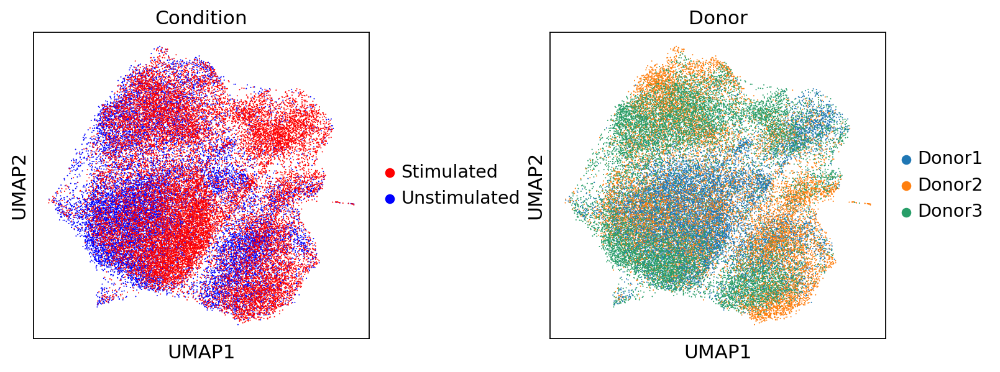

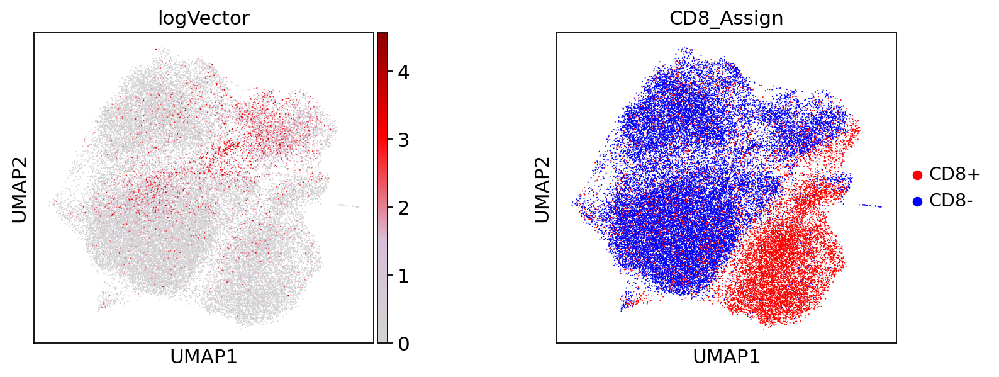

In [8]:
sc.pl.umap(adata, color=['Condition', 'Donor'], color_map=cmap, wspace=0.4)
sc.pl.umap(adata, color=['logVector', 'CD8_Assign'], color_map=cmap, wspace=0.4)

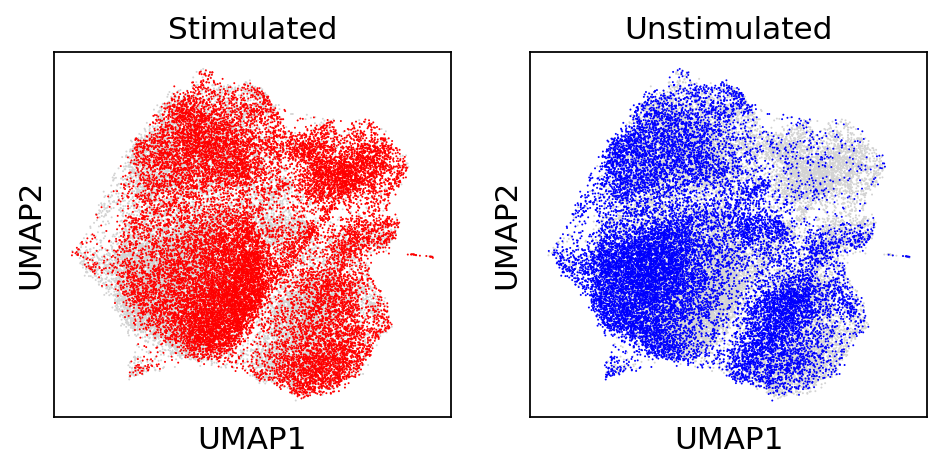

In [23]:
fig, ax = plt.subplots(1,2, figsize=(7,3))
for i in range(len(np.unique(adata.obs['Condition']))):
    sc.pl.umap(adata, color='Condition', groups=np.unique(adata.obs['Condition'])[i], ax=ax[i], legend_loc=None, show=False, title=np.unique(adata.obs['Condition'])[i])

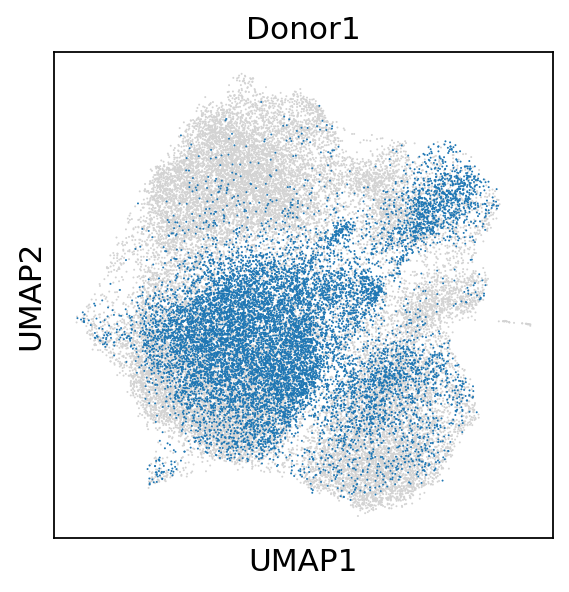

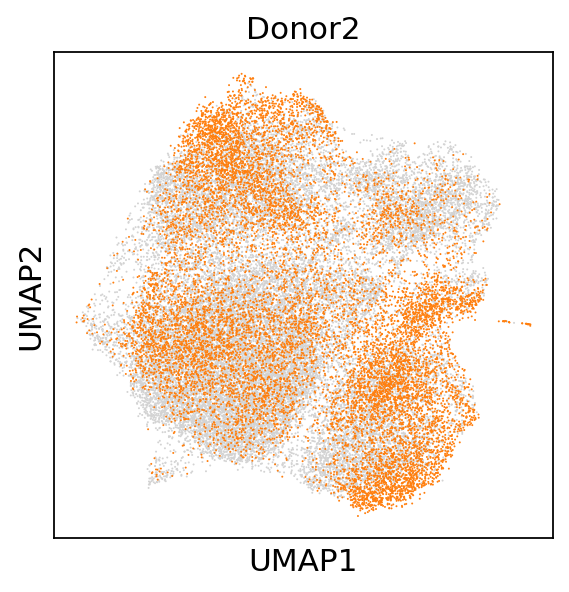

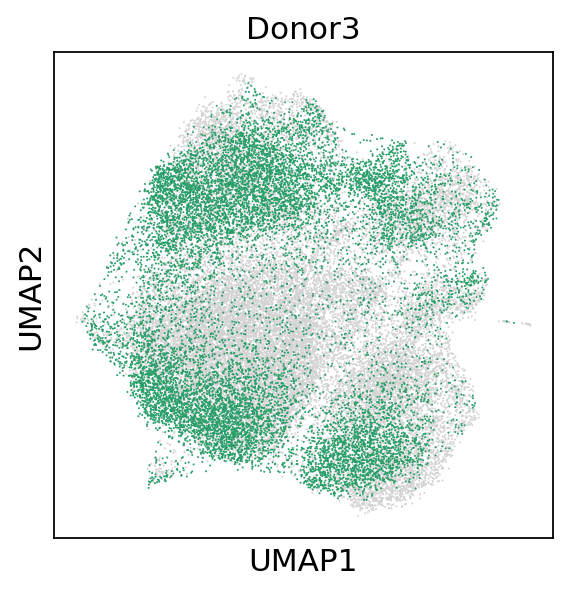

In [32]:
#fig, ax = plt.subplots(1,3, figsize=(10,3))
for i in range(len(np.unique(adata.obs['Donor']))):
    sc.pl.umap(adata, color='Donor', groups=np.unique(adata.obs['Donor'])[i], legend_loc=None, title=np.unique(adata.obs['Donor'])[i], save='_Tcells_Donor_'+np.unique(adata.obs['Donor'])[i])

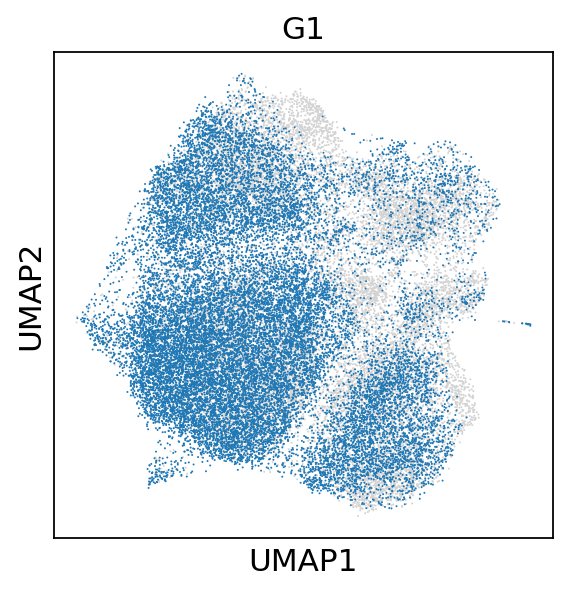

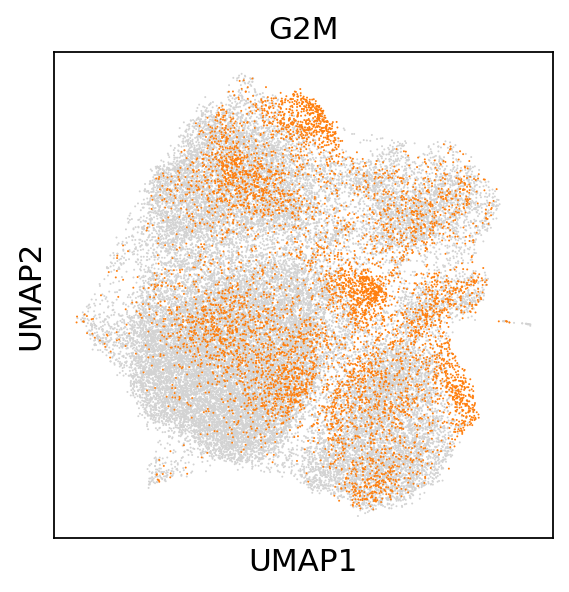

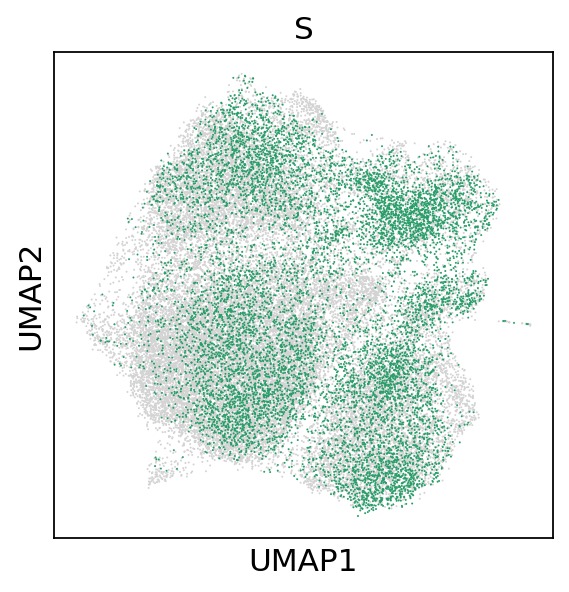

In [31]:
#fig, ax = plt.subplots(1,3, figsize=(10,3))
for i in range(len(np.unique(adata.obs['phase']))):
    sc.pl.umap(adata, color='phase', groups=np.unique(adata.obs['phase'])[i], legend_loc=None, title=np.unique(adata.obs['phase'])[i], save='_Tcells_phase_'+np.unique(adata.obs['phase'])[i])

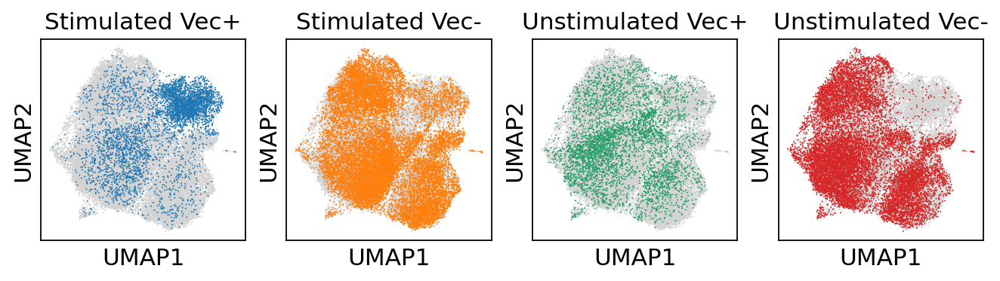

In [21]:
fig, ax = plt.subplots(1,4, figsize=(10,2.2))
for i in range(len(np.unique(adata.obs['Sub_con']))):
    sc.pl.umap(adata, color='Sub_con', groups=np.unique(adata.obs['Sub_con'])[i], ax=ax[i], legend_loc=None, show=False, title=np.unique(adata.obs['Sub_con'])[i])

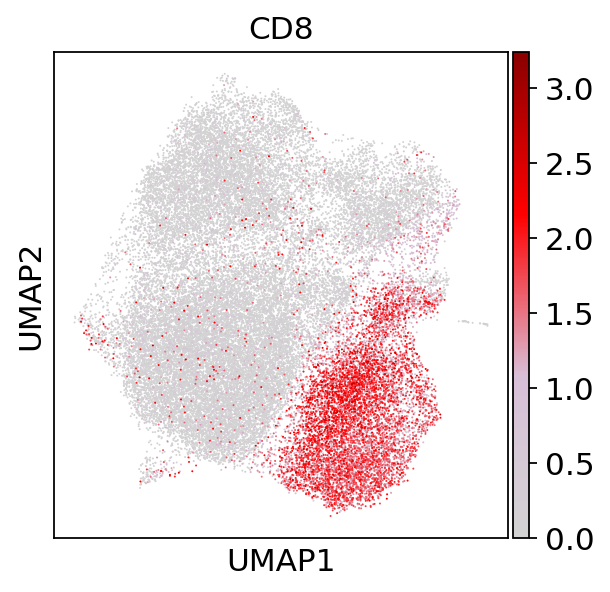

In [74]:
adata.obs['CD8'] = np.mean(adata.raw[:, ['CD8A', 'CD8B']].X.toarray(), axis=1)
sc.pl.umap(adata, color=['CD8'], color_map=cmap, save='_Tcells_CD8.pdf')

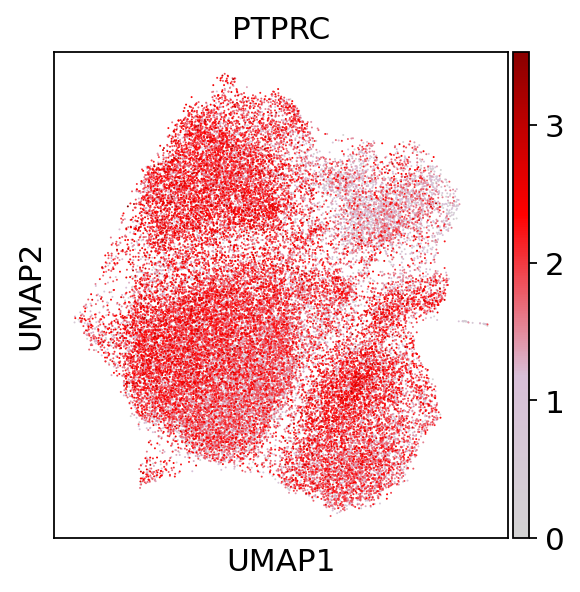

In [75]:
sc.pl.umap(adata, color=['PTPRC'], color_map=cmap, save='_Tcells_ptprc.pdf')

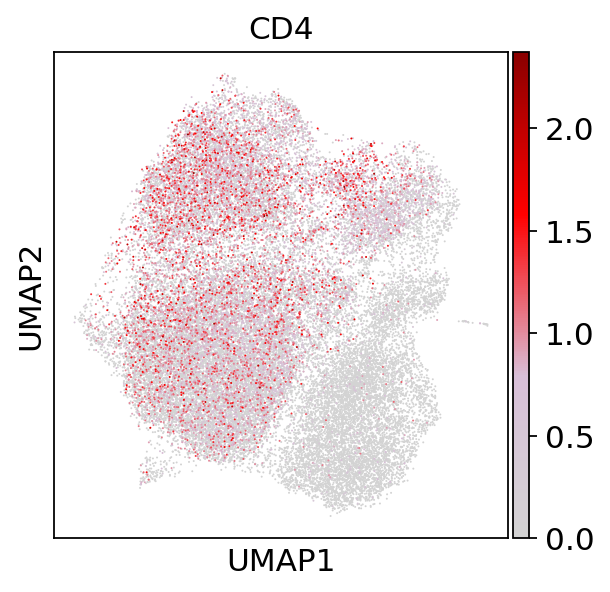

In [76]:
sc.pl.umap(adata, color=['CD4'], color_map=cmap, save='_Tcells_CD4.pdf')

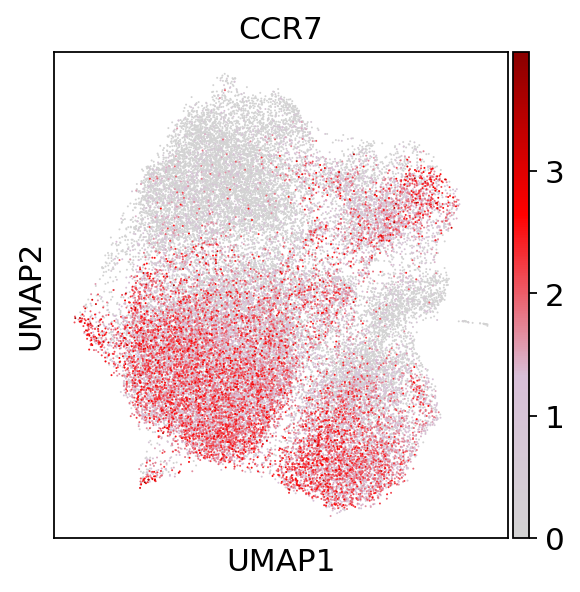

In [77]:
sc.pl.umap(adata, color=['CCR7'], color_map=cmap, save='_Tcells_CCR7.pdf')

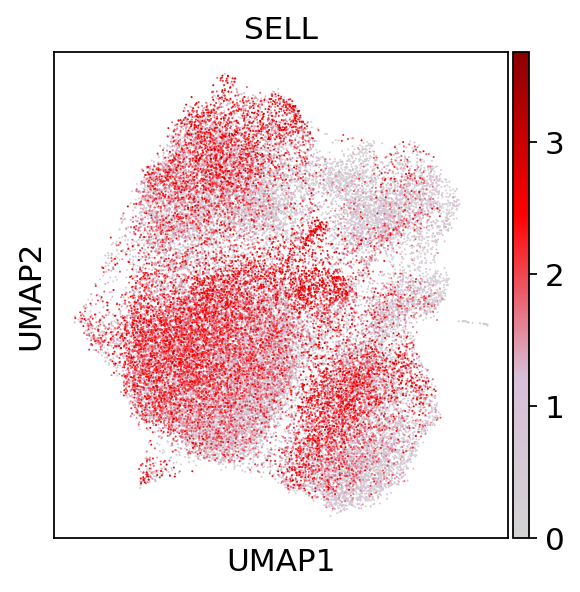

In [78]:
sc.pl.umap(adata, color=['SELL'], color_map=cmap, save='_Tcells_SELL.pdf')

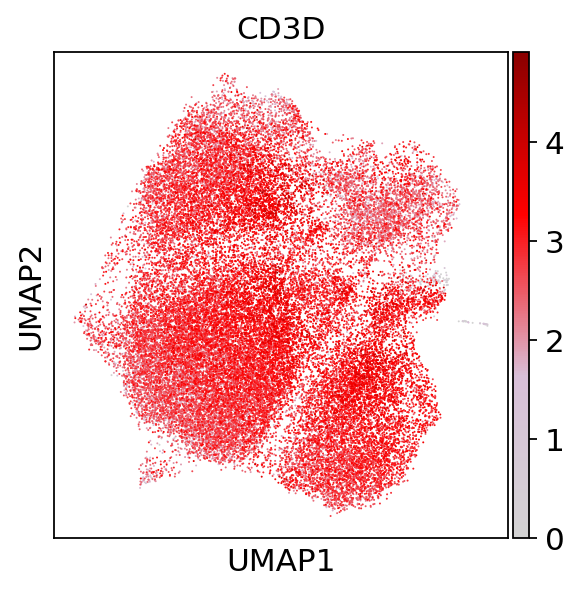

In [5]:
sc.pl.umap(adata, color=['CD3D'], color_map=cmap, save='_Tcells_CD3D.pdf')

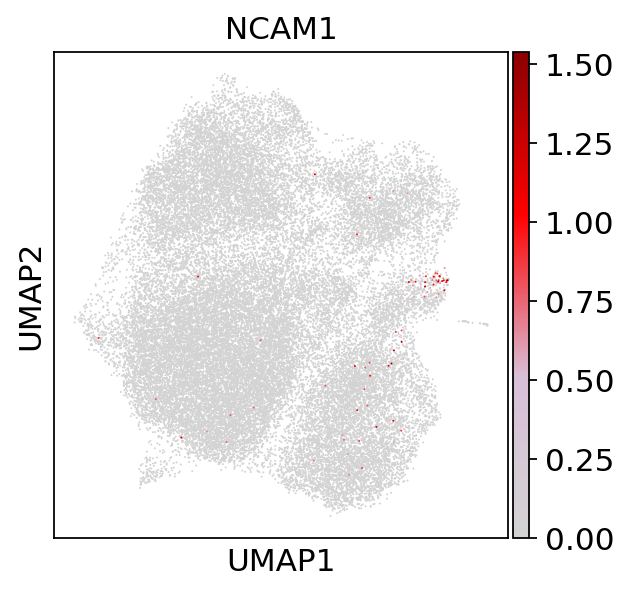

In [6]:
sc.pl.umap(adata, color=['NCAM1'], color_map=cmap, save='_Tcells_NCAM1.pdf')

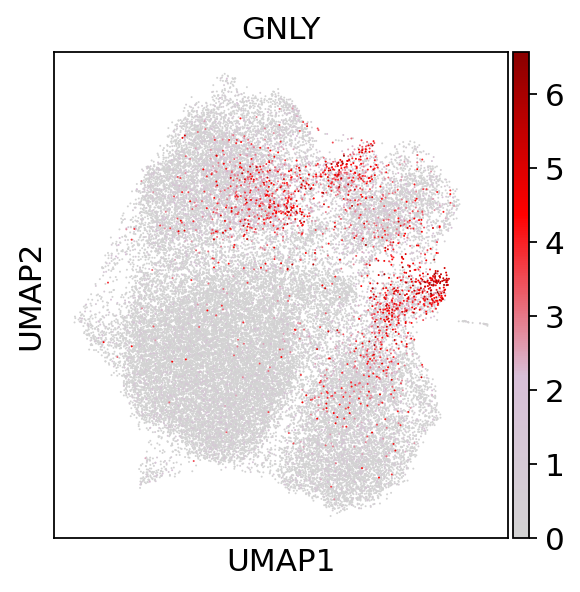

In [7]:
sc.pl.umap(adata, color=['GNLY'], color_map=cmap, save='_Tcells_GNLY.pdf')

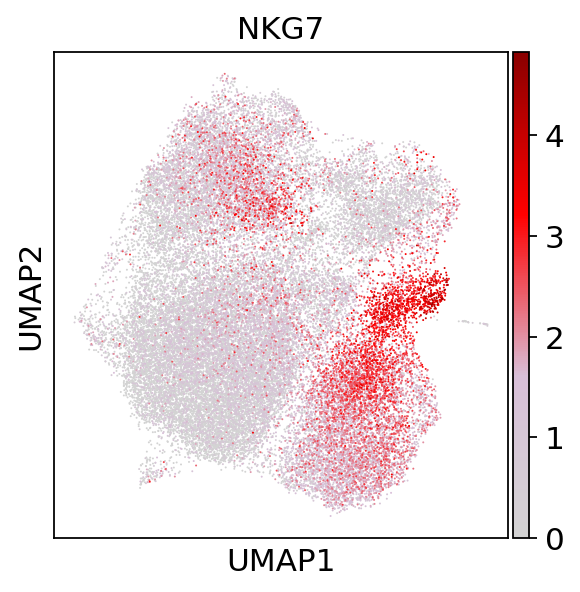

In [8]:
sc.pl.umap(adata, color=['NKG7'], color_map=cmap, save='_Tcells_NKG7.pdf')

In [143]:
adata.write('./write/Tcells_processed_regressedout.h5ad')

# Check vector

In [4]:
adata= sc.read('./write/Tcells_processed_regressedout.h5ad')

In [11]:
display(pd.crosstab(adata.obs['Vec_binary'], adata.obs['Condition'], margins=True))
display(pd.crosstab(adata.obs['Vec_binary'], adata.obs['Condition'], margins=True, normalize=True)*100)

Condition,Stimulated,Unstimulated,All
Vec_binary,,,
Vec-,16517,12847,29364
Vec+,4218,4316,8534
All,20735,17163,37898


Condition,Stimulated,Unstimulated,All
Vec_binary,,,
Vec-,43.582775,33.898886,77.481661
Vec+,11.129875,11.388464,22.518339
All,54.712650,45.287350,100.000000


In [15]:
adata.obs['Sub_con1'] = adata.obs['Donor'].astype(str)+'_'+adata.obs['Condition'].astype(str)

In [16]:
adata.obs['Sub_con1'] = adata.obs['Sub_con1'].astype('category')
adata.obs['Sub_con1'].cat.categories

Index(['Donor1_Stimulated', 'Donor1_Unstimulated', 'Donor2_Stimulated',
       'Donor2_Unstimulated', 'Donor3_Stimulated', 'Donor3_Unstimulated'],
      dtype='object')

In [17]:
adata.obs['Sub_con1'] = adata.obs['Sub_con1'].cat.rename_categories(['Donor1 +Antigen', 'Donor1 -Antigen', 'Donor2 +Antigen', 'Donor2 -Antigen', 'Donor3 +Antigen', 'Donor3 -Antigen'])

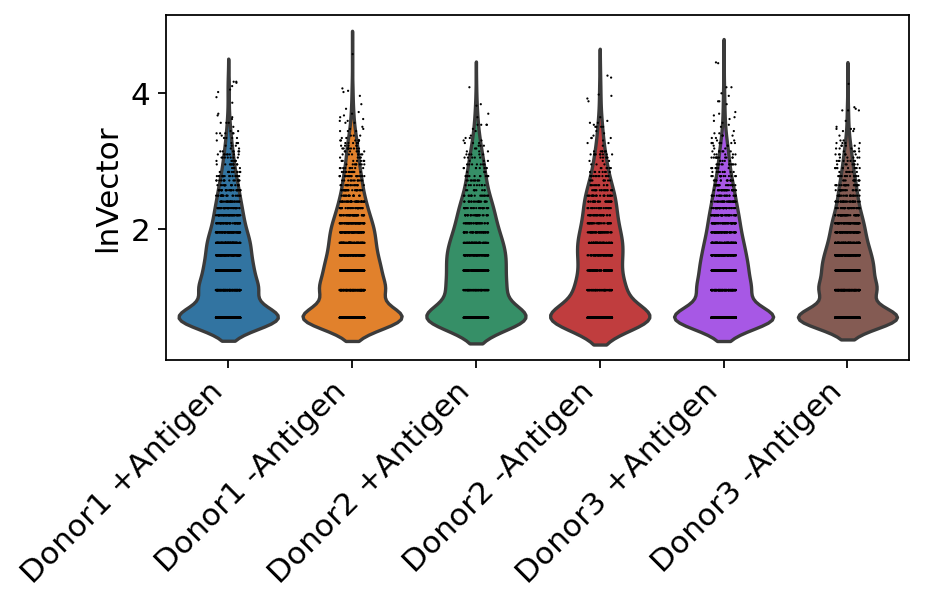

In [18]:
fig, ax = plt.subplots(figsize=(6,4))
sns.violinplot(x='Sub_con1', y='logVector', data=adata[adata.obs['Vec_binary'] == 'Vec+'].obs, scale='width', ax=ax, inner=None)
sns.stripplot(x='Sub_con1', y='logVector',jitter = True, data=adata[adata.obs['Vec_binary'] == 'Vec+'].obs,  ax=ax, color='black', size=1)
ax.grid(False)
plt.xticks(rotation=45, ha='right')
ax.set_xlabel('')
ax.set_ylabel('lnVector')
plt.tight_layout()
plt.savefig('./figures/Tcells_violin_logvec.pdf')

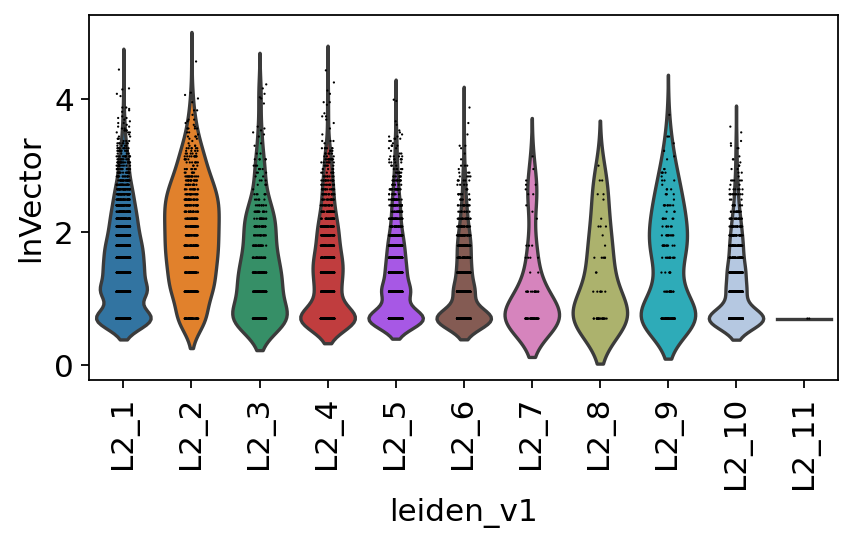

In [19]:
fig, ax = plt.subplots(figsize=(6,3))
sns.violinplot(x='leiden_v1', y='logVector', data=adata[adata.obs['Vec_binary'] == 'Vec+'].obs, scale='width', ax=ax, inner=None)
sns.stripplot(x='leiden_v1', y='logVector', data=adata[adata.obs['Vec_binary'] == 'Vec+'].obs, ax=ax, color='black', size=1)
ax.grid(False)
ax.set_ylabel('lnVector')
plt.xticks(rotation=90)
plt.savefig('./figures/violin_Tcells_leiden_v1_logvec.pdf')

# Clustering

In [54]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [46]:
adjacency = _choose_graph(adata, 'connectivities', None)
g = get_igraph_from_adjacency(adjacency, directed=False)

In [47]:
modusave = {}
for i in np.arange(0.1, 2, 0.1):
    i = round(i,1)
    print(i)
    partition_type = la.RBConfigurationVertexPartition
    partition_kwargs = dict()
    partition_kwargs['seed'] = 0
    partition_kwargs["resolution_parameter"] = i
    partition_kwargs['n_iterations'] = -1
    partition_kwargs['weights'] = np.array(g.es['weight']).astype(np.float64)
    part = la.find_partition(
                    g, partition_type,
                    **partition_kwargs,
                )
    modularity = g.modularity(part.membership)
    modusave['m'+str(i)] = modularity 

0.1
0.2
0.3
0.4
0.5
0.6
0.7
0.8
0.9
1.0
1.1
1.2
1.3
1.4
1.5
1.6
1.7
1.8
1.9


In [49]:
modusave

{'m0.1': 0.0007805429230364996,
 'm0.2': 0.6004231855773606,
 'm0.3': 0.6111077176771789,
 'm0.4': 0.6333731702316836,
 'm0.5': 0.6435329867792324,
 'm0.6': 0.6761169917887185,
 'm0.7': 0.6829061798163757,
 'm0.8': 0.6852602140025723,
 'm0.9': 0.6907958919375371,
 'm1.0': 0.689532313338861,
 'm1.1': 0.6872886013919162,
 'm1.2': 0.6760425153903262,
 'm1.3': 0.6781448525172518,
 'm1.4': 0.6798216402635816,
 'm1.5': 0.6762439047072906,
 'm1.6': 0.6718548318073783,
 'm1.7': 0.6712862273339453,
 'm1.8': 0.6674611119395538,
 'm1.9': 0.6664731381080644}

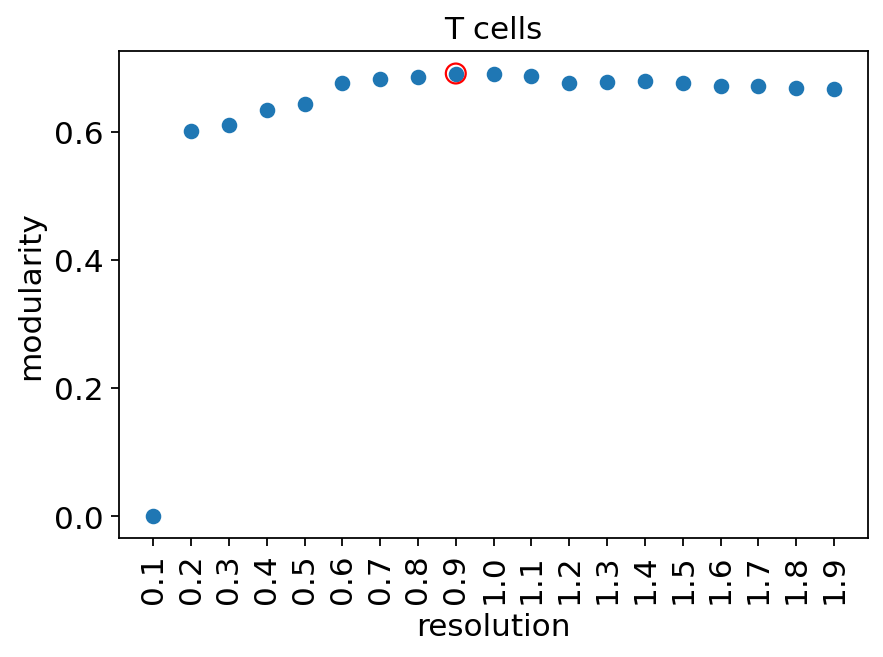

In [50]:
fig, ax = plt.subplots(figsize = (6,4))
x = np.arange(0.1, 2, 0.1)
y = list(modusave.values())
ax.scatter(x, y)
ax.grid(False)
ax.set_xlabel('resolution')
ax.set_ylabel('modularity')
ax.set_title('T cells')
plt.xticks(x, rotation=90)
maxidx = y.index(max(y))
ax.scatter(x[maxidx], y[maxidx], s=80,facecolors='none', edgecolors='r')

running Leiden clustering
    finished: found 2 clusters and added
    'test', the cluster labels (adata.obs, categorical) (0:00:06)
running Leiden clustering
    finished: found 4 clusters and added
    'test', the cluster labels (adata.obs, categorical) (0:00:12)
running Leiden clustering
    finished: found 5 clusters and added
    'test', the cluster labels (adata.obs, categorical) (0:00:14)
running Leiden clustering
    finished: found 7 clusters and added
    'test', the cluster labels (adata.obs, categorical) (0:00:13)
running Leiden clustering
    finished: found 8 clusters and added
    'test', the cluster labels (adata.obs, categorical) (0:00:13)
running Leiden clustering
    finished: found 9 clusters and added
    'test', the cluster labels (adata.obs, categorical) (0:00:29)
running Leiden clustering
    finished: found 11 clusters and added
    'test', the cluster labels (adata.obs, categorical) (0:00:28)
running Leiden clustering
    finished: found 12 clusters and added


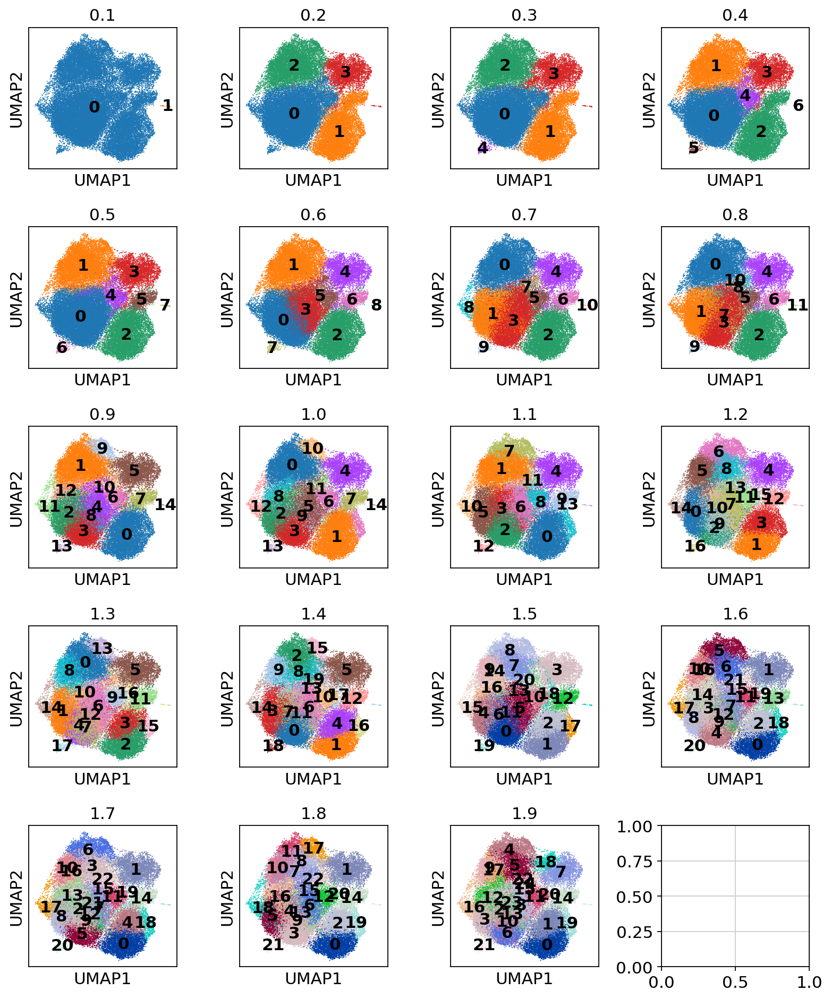

In [36]:
fig, ax = plt.subplots(5,4, figsize=(10,12))
res = [round(x,2 ) for x in np.arange(0.1, 2, 0.1)]
for i in range(len(res)):
    colidx = i%4
    rowidx = i//4
    if 'test_colors' in adata.uns_keys():
        del adata.uns['test_colors']
    sc.tl.leiden(adata, resolution = res[i],  key_added='test', random_state=0)
    sc.pl.umap(adata, color = 'test', legend_loc='on data', title=str(res[i]), show=False, ax=ax[rowidx][colidx])
plt.tight_layout()

In [51]:
sc.tl.leiden(adata, resolution = 0.7,  key_added='leiden_v1', random_state=0)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden_v1', the cluster labels (adata.obs, categorical) (0:00:28)


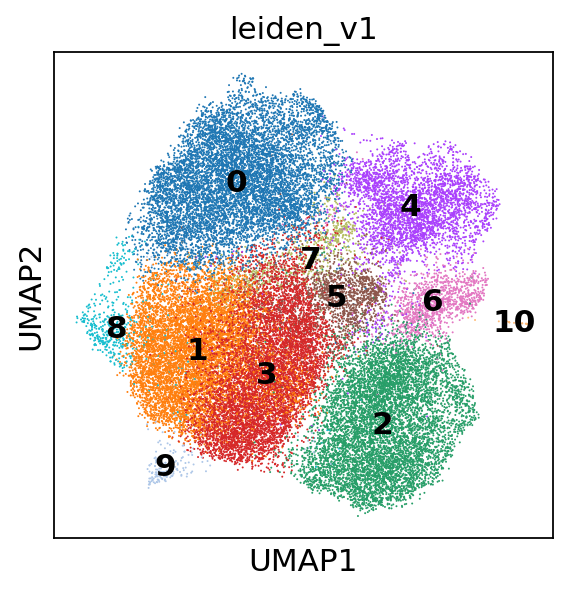

In [53]:
sc.pl.umap(adata, color=['leiden_v1'], legend_loc='on data')

In [23]:
RN_cluster = {'4': '1',
             '7': '2',
             '5': '3',
             '0': '4',
             '1': '5',
             '3': '6',
             '8': '7',
             '9': '8',
             '6': '9',
             '2': '10',
             '10': '11'}

In [24]:
adata.obs['leiden_v1'] = ['L2_'+RN_cluster[x] for x in adata.obs['leiden_v1']]

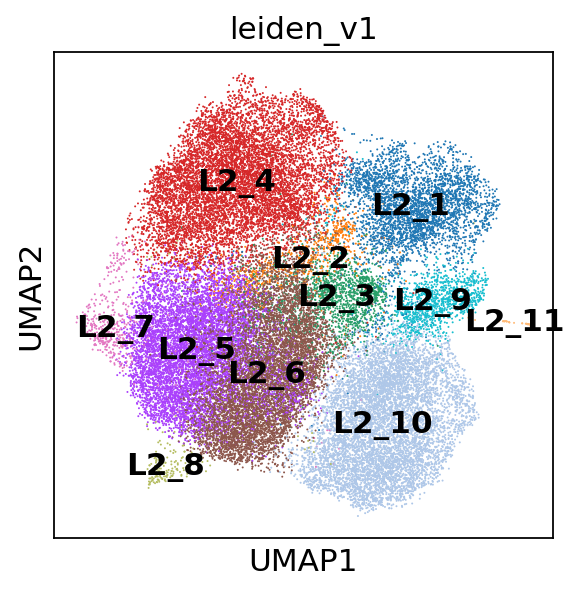

In [57]:
sc.pl.umap(adata, color='leiden_v1', legend_loc='on data', save='_Tcells_leiden_v1.pdf')

In [26]:
sc.tl.rank_genes_groups(adata, groupby='leiden_v1', n_genes=adata.raw.shape[1], key_added='DE_leiden_v1', method='t-test')

ranking genes
    finished: added to `.uns['DE_leiden_v1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:13)


Index(['L2_1', 'L2_2', 'L2_3', 'L2_4', 'L2_5', 'L2_6', 'L2_7', 'L2_8', 'L2_9',
       'L2_10', 'L2_11'],
      dtype='object')
0
(37898, 1104)
(37898, 21801)
upRegulated gene: 844
downRegulated gene: 480


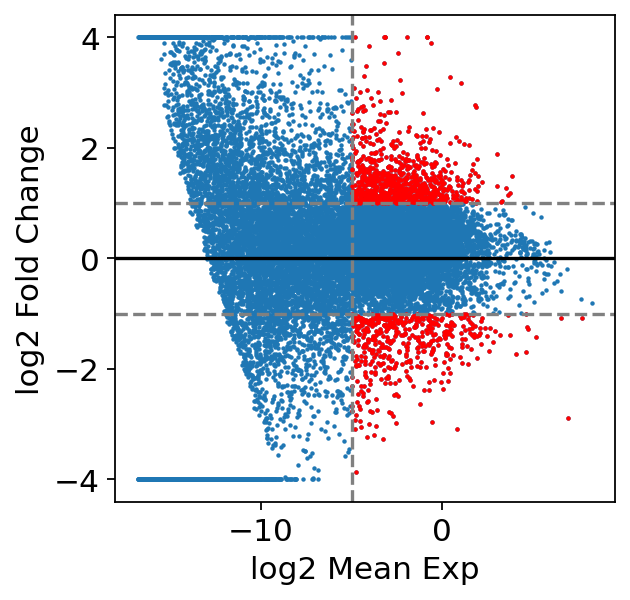

1
(37898, 1104)
(37898, 21801)
upRegulated gene: 137
downRegulated gene: 299


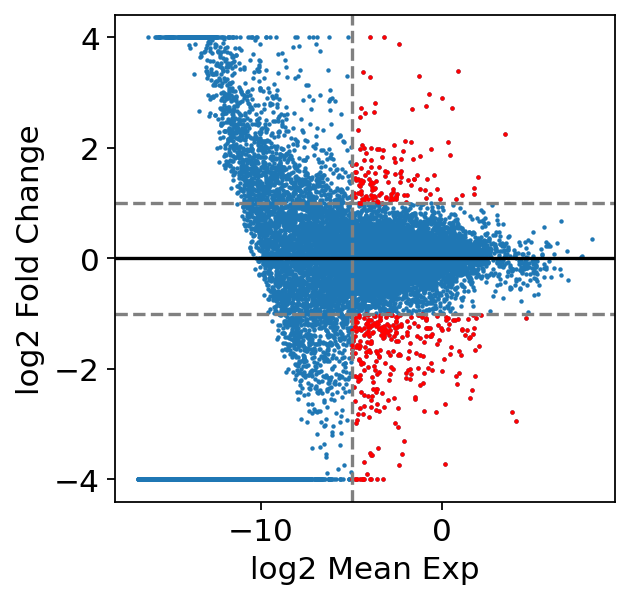

2
(37898, 1104)
(37898, 21801)
upRegulated gene: 60
downRegulated gene: 403


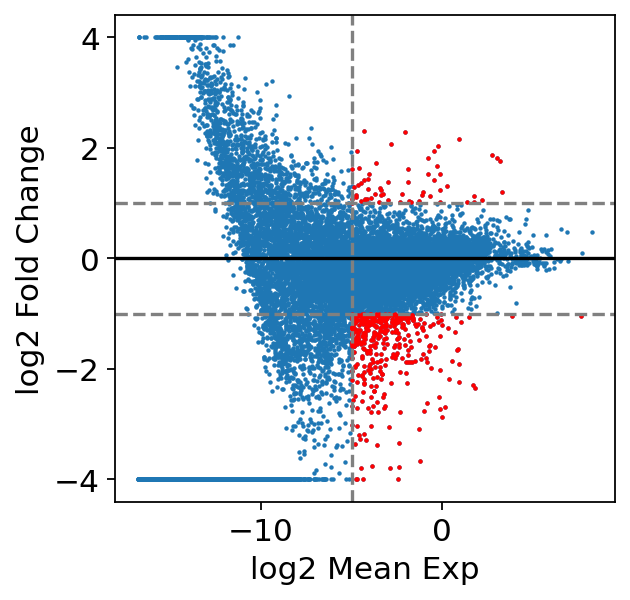

3
(37898, 1104)
(37898, 21801)
upRegulated gene: 317
downRegulated gene: 247


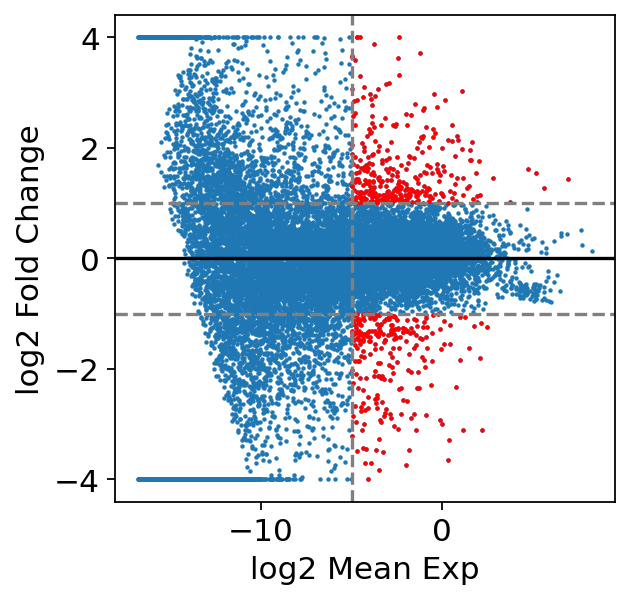

4
(37898, 1104)
(37898, 21801)
upRegulated gene: 36
downRegulated gene: 244


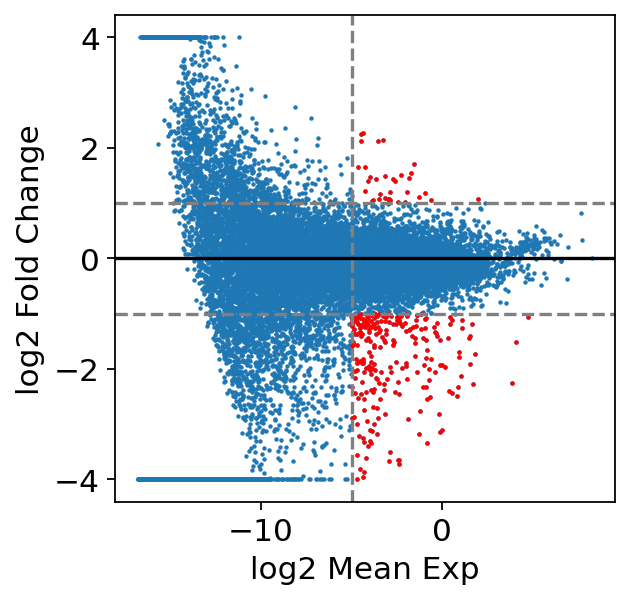

5
(37898, 1104)
(37898, 21801)
upRegulated gene: 19
downRegulated gene: 392


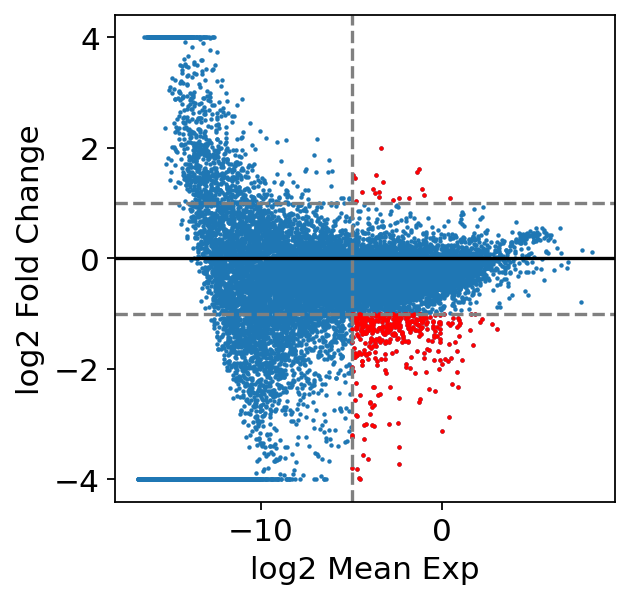

6
(37898, 1104)
(37898, 21801)
upRegulated gene: 144
downRegulated gene: 442


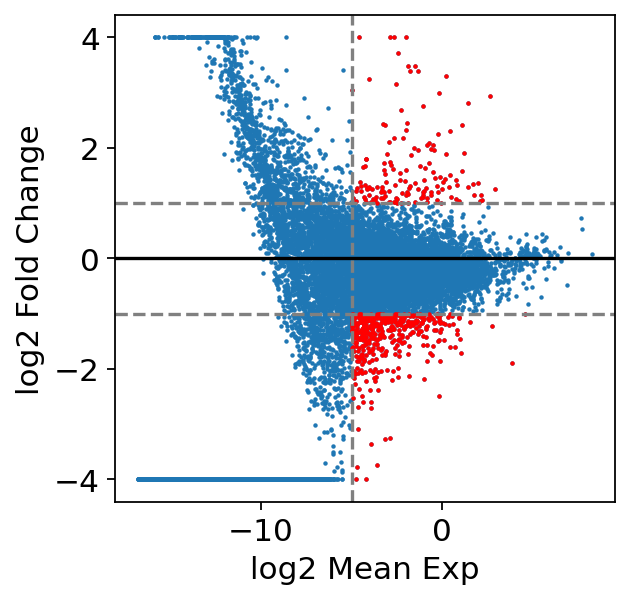

7
(37898, 1104)
(37898, 21801)
upRegulated gene: 1263
downRegulated gene: 500


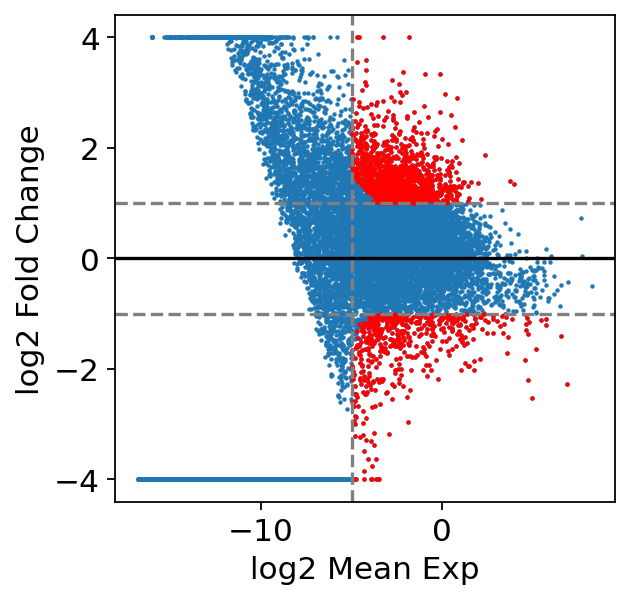

8
(37898, 1104)
(37898, 21801)
upRegulated gene: 292
downRegulated gene: 230


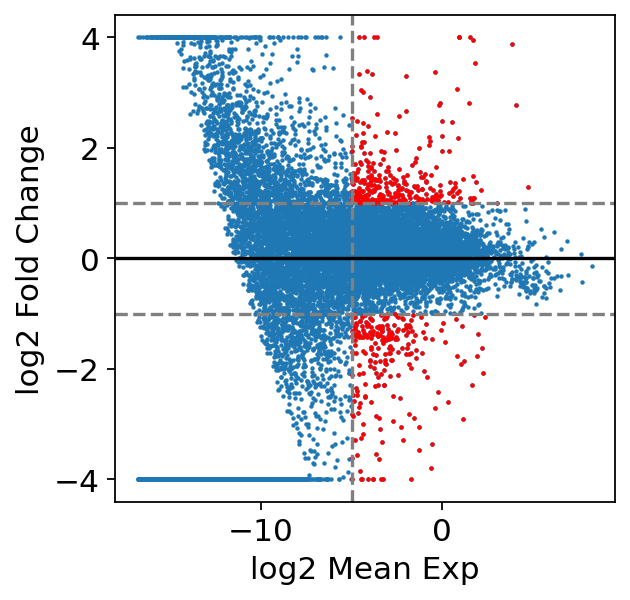

9
(37898, 1104)
(37898, 21801)
upRegulated gene: 131
downRegulated gene: 220


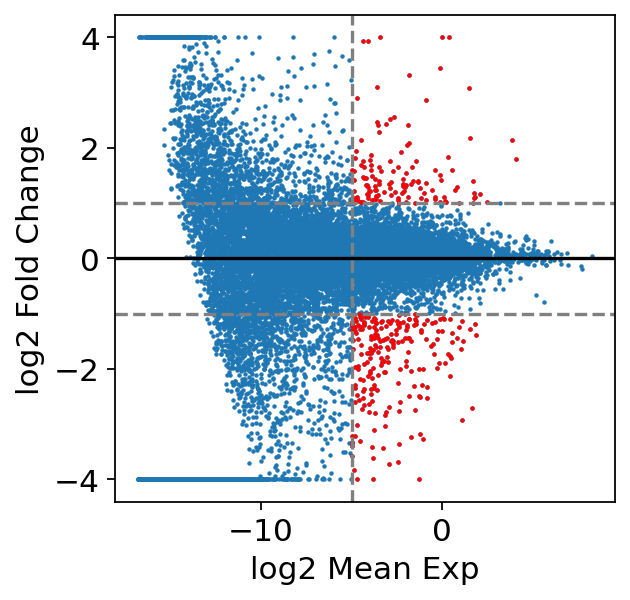

10
(37898, 1104)
(37898, 21801)
upRegulated gene: 422
downRegulated gene: 1229


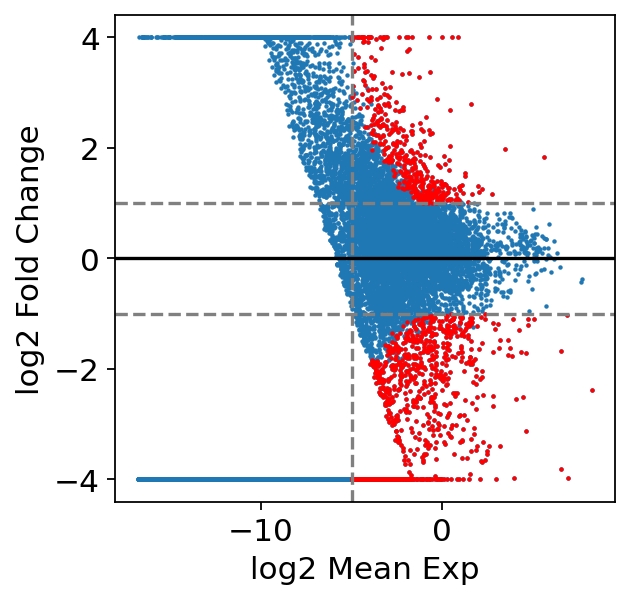

In [201]:
cat = adata.obs['leiden_v1'].cat.categories
print(cat)
for x in range(len(cat)):
    print(x)
    upG, downG, tableG = smqpp.plot_ma(adata, 'DE_leiden_v1',cidx=int(x), padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-5)
    np.savetxt('./DEres/Tcells_leiden_v1/'+cat[x]+'vsAll_upG.txt', upG, delimiter='\t', fmt='%s')
    np.savetxt('./DEres/Tcells_leiden_v1/'+cat[x]+'vsAll_downG.txt', downG, delimiter='\t', fmt='%s')
    tableG.to_csv('./DEres/Tcells_leiden_v1/'+cat[x]+'vsAll_table.csv')

In [122]:
import os
import re
nTop = 5
GL2plot = {}
files = np.array(os.listdir('./DEres/Tcells_leiden_v1/'))
files = ['L2_'+str(x+1)+'vsAll_upG.txt' for x in range(11)]
print(files)
for f in files:
    cl = re.search('L2_\d+' , f)[0]
    GL2plot[cl] = np.genfromtxt('./DEres/Tcells_leiden_v1/'+f, dtype=str, delimiter='\t')[0:nTop]

['L2_1vsAll_upG.txt', 'L2_2vsAll_upG.txt', 'L2_3vsAll_upG.txt', 'L2_4vsAll_upG.txt', 'L2_5vsAll_upG.txt', 'L2_6vsAll_upG.txt', 'L2_7vsAll_upG.txt', 'L2_8vsAll_upG.txt', 'L2_9vsAll_upG.txt', 'L2_10vsAll_upG.txt', 'L2_11vsAll_upG.txt']


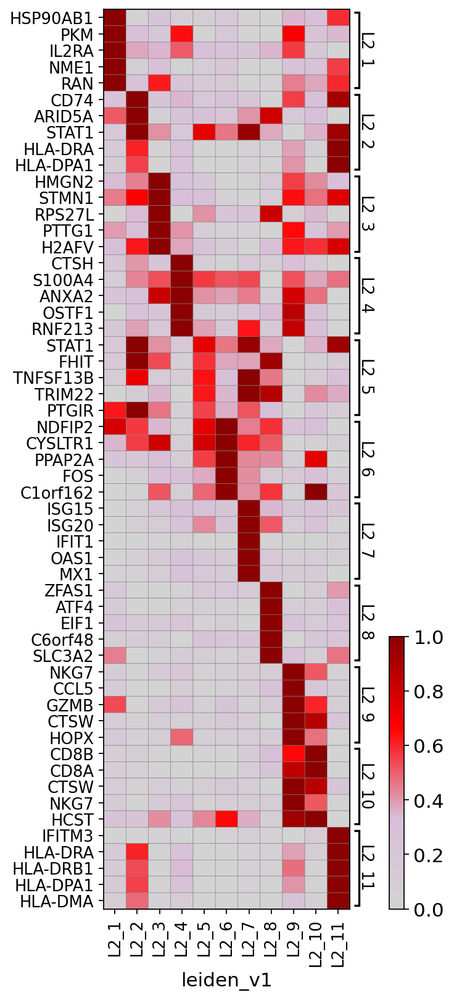

GridSpec(2, 3, height_ratios=[0, 11.0], width_ratios=[3.3, 0.4, 0.2])

In [123]:
sc.pl.matrixplot(adata, var_names=GL2plot, groupby='leiden_v1', cmap=cmap, standard_scale='var',swap_axes=True, save='_Tcells_leiden_v1_top5G.pdf')

# DE L2_5 vs L2_6

In [2]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [9]:
print("L2_5 cells: "+str(np.sum(adata.obs['leiden_v1']=='L2_5')))
print("L2_6 cells: "+str(np.sum(adata.obs['leiden_v1']=='L2_6')))

L2_5 cells: 7920
L2_6 cells: 6907


ranking genes
    finished: added to `.uns['DE_L2_5vsL2_6']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
(37898, 1104)
(37898, 21801)
upRegulated gene: 206
downRegulated gene: 103


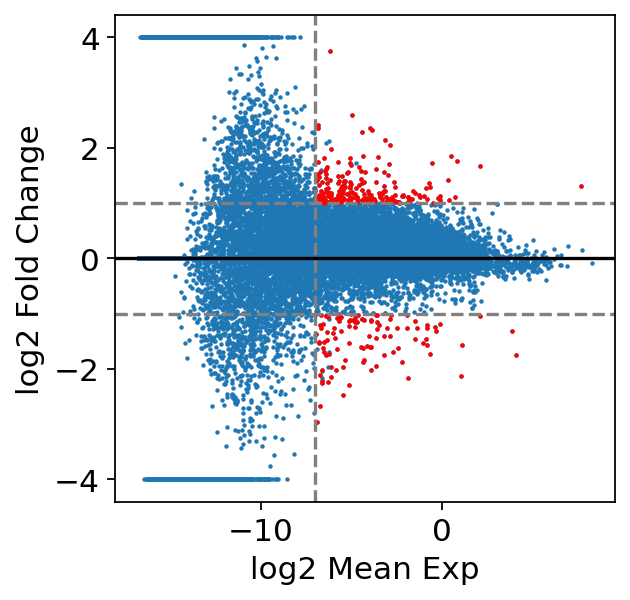

In [134]:
import smqpp
sc.tl.rank_genes_groups(adata, groupby='leiden_v1', reference='L2_6', groups=['L2_5'], n_genes=adata.raw.shape[1], key_added='DE_L2_5vsL2_6', method='t-test')
upG, downG, tableG = smqpp.plot_ma(adata, 'DE_L2_5vsL2_6', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-7)

In [135]:
np.savetxt('./DEres/Tcells_L2_5vsL2_6/L2_5vsL2_6_upG.txt', upG, delimiter='\t', fmt='%s')
np.savetxt('./DEres/Tcells_L2_5vsL2_6/L2_5vsL2_6_downG.txt', downG, delimiter='\t', fmt='%s')
tableG.to_csv('./DEres/Tcells_L2_5vsL2_6/L2_5vsL2_6_table.csv')

In [65]:
# pathway analysis c2
import smqpp
with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c2.all.v7.1.symbols.gmt') as f:
    DBcont = f.readlines()
    
DBcont = np.array(DBcont)
DBcont = DBcont[[(('BIOCARTA_' in x) | ('REACTOME_' in x) | ('PID_' in x) | ('KEGG_' in x) | ('HALLMARK_' in x)) for x in DBcont]]

TotalGenes = adata.raw.var_names

In [131]:
upG = np.genfromtxt('./DEres/Tcells_L2_5vsL2_6/L2_5vsL2_6_upG.txt', delimiter='\t', dtype=str)
downG = np.genfromtxt('./DEres/Tcells_L2_5vsL2_6/L2_5vsL2_6_downG.txt', delimiter='\t', dtype=str)

In [66]:
GL_up_pathway = smqpp.pathway_analysis(upG, TotalGenes, DBcont)
GL_down_pathway = smqpp.pathway_analysis(downG, TotalGenes, DBcont)

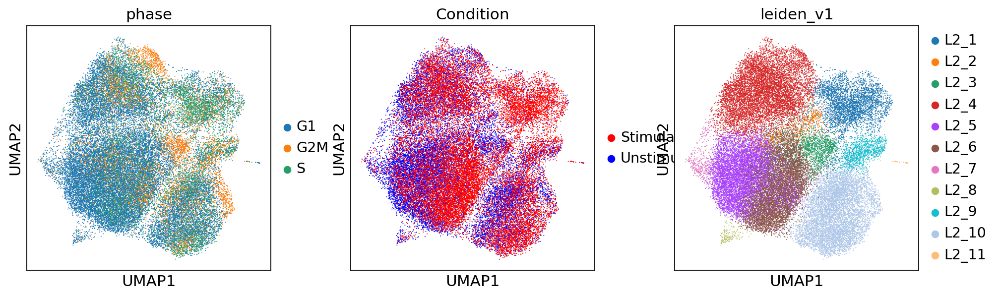

In [71]:
sc.pl.umap(adata, color=['phase', 'Condition', 'leiden_v1'])

In [87]:
display(GL_up_pathway.head(3))
display(GL_down_pathway.head(3))

,Pathway,k,M,n,N,pval,OLGenes,padj
635,REACTOME_CELL_CYCLE,22,21801,588,206,4.484428e-08,AURKB;BIRC5;CDC25B;CDCA5;CENPM;E2F2;ESCO2;FBXO...,0.000099
782,REACTOME_CELL_CYCLE_MITOTIC,18,21801,483,206,8.487660e-07,AURKB;BIRC5;CDC25B;CDCA5;CENPM;E2F2;ESCO2;FBXO...,0.000747
405,PID_AURORA_B_PATHWAY,6,21801,36,206,1.017619e-06,AURKB;BIRC5;INCENP;KIF23;KIF2C;NCAPG,0.000747


,Pathway,k,M,n,N,pval,OLGenes,padj
88,KEGG_CYTOKINE_CYTOKINE_RECEPTOR_INTERACTION,20,21801,219,103,2.253463e-20,CCR1;CD40LG;CSF2;CXCL10;CXCR6;FASLG;IFNL1;IL13...,4.964380e-17
1006,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,22,21801,762,103,7.061270e-12,CCR1;CD40LG;CSF2;CXCL10;DUSP6;EBI3;EPGN;FASLG;...,7.777989e-09
1576,REACTOME_SIGNALING_BY_INTERLEUKINS,16,21801,420,103,1.317575e-10,CCR1;CSF2;CXCL10;DUSP6;EBI3;FASLG;FOS;IFNL1;IL...,9.675391e-08


In [130]:
# pathway analysis c7
import smqpp
with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c7.all.v7.2.symbols.gmt') as f:
    DBcont = f.readlines()

TotalGenes = adata.raw.var_names

In [132]:
GL_up_pathway = smqpp.pathway_analysis(upG, TotalGenes, DBcont)
GL_down_pathway = smqpp.pathway_analysis(downG, TotalGenes, DBcont)

In [137]:
display(GL_up_pathway.head(10))
display(GL_down_pathway.head(10))

,Pathway,k,M,n,N,pval,OLGenes,padj
386,GSE15750_DAY6_VS_DAY10_TRAF6KO_EFF_CD8_TCELL_UP,24,21801,186,206,1.752021e-20,AURKB;BIRC5;CDCA2;CDCA3;CDCA5;CENPM;CKAP2L;E2F...,8.535845e-17
1336,GSE30962_PRIMARY_VS_SECONDARY_ACUTE_LCMV_INF_C...,23,21801,188,206,3.874041e-19,AURKB;BIRC5;CDCA3;CDCA5;CKAP2L;DLGAP5;E2F8;ESC...,9.437164e-16
384,GSE15750_DAY6_VS_DAY10_EFF_CD8_TCELL_UP,22,21801,180,206,2.424262e-18,AURKB;BIRC5;CENPM;CKAP2L;E2F7;ESCO2;FBXO5;KIF2...,3.937001e-15
2814,GSE13547_CTRL_VS_ANTI_IGM_STIM_BCELL_12H_UP,21,21801,175,206,2.169143e-17,AURKB;BIRC5;CDCA3;DLGAP5;E2F8;ESCO2;FBXO5;INCE...,2.642016e-14
2798,GSE14415_NATURAL_TREG_VS_TCONV_DN,20,21801,164,206,9.387655e-17,BIRC5;CDC25B;CDCA3;CENPM;CKAP2L;DLGAP5;E2F8;ES...,9.147331e-14
1521,GSE36476_CTRL_VS_TSST_ACT_72H_MEMORY_CD4_TCELL...,19,21801,189,206,2.087047e-14,BIRC5;CDCA3;CENPM;DLGAP5;FBXO5;IL1R2;KIF15;KIF...,1.694682e-11
4837,GSE45365_WT_VS_IFNAR_KO_BCELL_MCMV_INFECTION_DN,17,21801,155,206,1.216727e-13,AQP3;BIRC5;CDCA3;CDCA5;CKAP2L;DEPDC1B;DLGAP5;E...,8.468419e-11
2796,GSE14415_INDUCED_TREG_VS_TCONV_UP,17,21801,164,206,3.105581e-13,AURKB;BIRC5;CDC25B;CDCA3;CKAP2L;E2F7;FBXO5;KIF...,1.891299e-10
4459,GSE35543_IN_VITRO_ITREG_VS_CONVERTED_EX_ITREG_UP,17,21801,181,206,1.568888e-12,BIRC5;CDC25B;CDCA3;CENPM;CEP128;CKAP2L;E2F2;E2...,8.492916e-10
4256,GSE40274_CTRL_VS_EOS_TRANSDUCED_ACTIVATED_CD4_...,16,21801,157,206,2.061550e-12,AURKB;BIRC5;CDCA2;CDCA3;CDCA5;CKAP2L;DLGAP5;E2...,9.130791e-10


,Pathway,k,M,n,N,pval,OLGenes,padj
3560,GSE19941_LPS_VS_LPS_AND_IL10_STIM_IL10_KO_NFKB...,12,21801,177,103,4.538811e-11,C15ORF48;CCR1;CSF2;CXCR6;FILIP1L;IL13;IL17RB;I...,2.211309e-07
4767,GSE45739_UNSTIM_VS_ACD3_ACD28_STIM_NRAS_KO_CD4...,11,21801,177,103,7.723469e-10,AOAH;CD244;FASLG;GZMA;GZMB;GZMH;PALLD;SLAMF7;S...,1.124680e-06
2551,GSE9316_IL6_KO_VS_IFNG_KO_INVIVO_EXPANDED_CD4_...,11,21801,180,103,9.233823e-10,AOAH;BCL2A1;CXCL10;EBI3;FOS;GADD45G;GPR84;GZMA...,1.124680e-06
812,GSE17974_IL4_AND_ANTI_IL12_VS_UNTREATED_24H_AC...,10,21801,134,103,7.962611e-10,CD244;DUSP6;IFNL1;IL17RB;IL3;NEK6;PPARG;PPP1R1...,1.124680e-06
814,GSE17974_IL4_AND_ANTI_IL12_VS_UNTREATED_48H_AC...,10,21801,160,103,4.487929e-09,AOAH;BCL2A1;DUSP6;GPR18;PPARG;PPP1R14A;RAB27B;...,4.373038e-06
3001,GSE19923_HEB_KO_VS_HEB_AND_E2A_KO_DP_THYMOCYTE_DN,10,21801,188,103,2.108532e-08,CCR1;DUSP6;FOS;IGF1;IL13;IL4;IL5;NAB2;PHLDA1;RXRA,1.501400e-05
816,GSE17974_IL4_AND_ANTI_IL12_VS_UNTREATED_72H_AC...,9,21801,140,103,2.157184e-08,AOAH;DUSP6;EOMES;IL17RB;PGLYRP2;PHLDA1;PPP1R14...,1.501400e-05
2836,GSE15330_HSC_VS_MEGAKARYOCYTE_ERYTHROID_PROGEN...,9,21801,168,103,1.043639e-07,CXCL10;DUSP6;FASLG;GJB6;KRT7;PHLDA1;STX1A;TNFS...,6.355764e-05
2682,GSE7219_WT_VS_NIK_NFKB2_KO_DC_UP,9,21801,179,103,1.793806e-07,CXCL10;CXCR6;DUSP6;GZMB;HPGDS;ITGA1;PHLDA1;QPC...,7.228031e-05
1993,GSE2770_TGFB_AND_IL4_VS_IL12_TREATED_ACT_CD4_T...,9,21801,184,103,2.267059e-07,BCL2A1;C15ORF48;EBI3;P4HA2;PHLDA1;PLXNA1;RXRA;...,7.228031e-05


# DE L2_1 vs L2_2

ranking genes
    finished: added to `.uns['DE_L2_2vsL2_1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
(37898, 1104)
(37898, 21801)
upRegulated gene: 954
downRegulated gene: 401


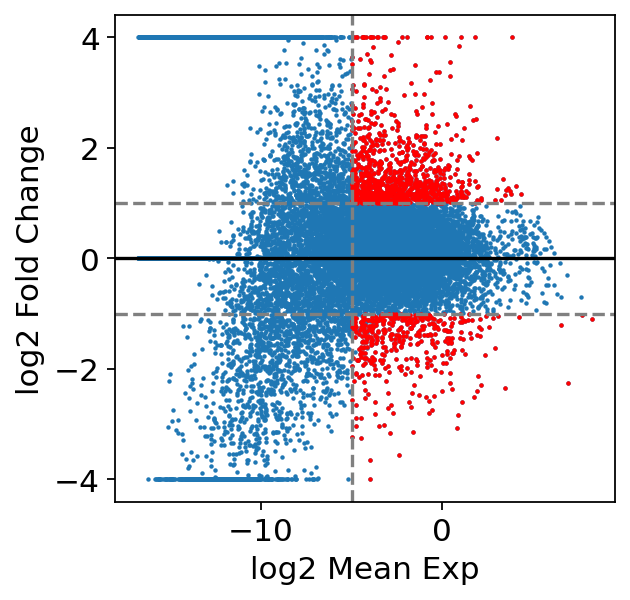

In [137]:
# sc.tl.rank_genes_groups(adata, groupby='leiden_v1', reference='L2_2', groups=['L2_1'], n_genes=adata.raw.shape[1], key_added='DE_L2_2vsL2_1', method='t-test')
# upG, downG, tableG = smqpp.plot_ma(adata, 'DE_L2_2vsL2_1', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-5)

# np.savetxt('./DEres/Tcells_L2_2vsL2_1/L2_2vsL2_1_upG.txt', upG, delimiter='\t', fmt='%s')
# np.savetxt('./DEres/Tcells_L2_2vsL2_1/L2_2vsL2_1_downG.txt', downG, delimiter='\t', fmt='%s')
# tableG.to_csv('./DEres/Tcells_L2_2vsL2_1/L2_2vsL2_1_table.csv')

# DE vec+StiL2_1 vs vec+StiOthers

In [5]:
adata_sub = adata[(adata.obs['Condition'] == 'Stimulated') & (adata.obs['Vec_binary'] == 'Vec+')].copy()

In [10]:
print("L2_1 cells: "+str(np.sum(adata_sub.obs['leiden_v1']=='L2_1')))
print("Remaining cells: "+str(np.sum(adata_sub.obs['leiden_v1']!='L2_1')))

L2_1 cells: 2104
Remaining cells: 2114


ranking genes
    finished: added to `.uns['DE_L2_1vtest_Stivecp']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
(4218, 1104)
(4218, 21801)


/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/smqpp/__init__.py:716: RuntimeWarning: divide by zero encountered in log2
  logExp = np.log2(normExp)


upRegulated gene: 899
downRegulated gene: 364


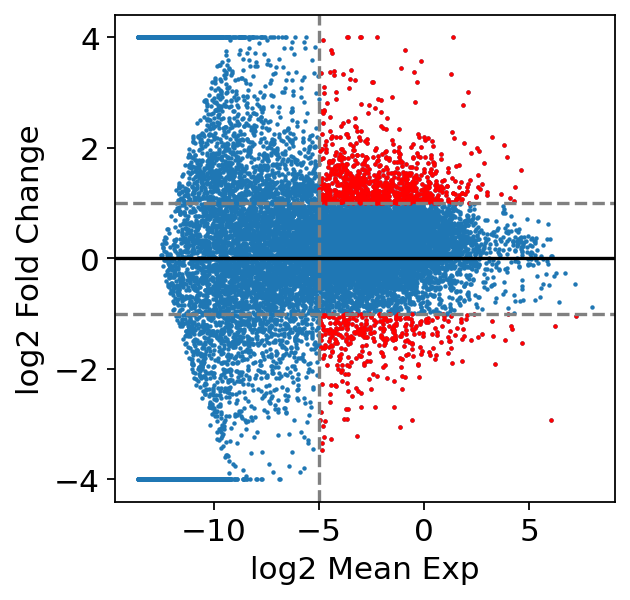

In [29]:
sc.tl.rank_genes_groups(adata_sub, groupby='leiden_v1', reference='rest', groups=['L2_1'], n_genes=adata.raw.shape[1], key_added='DE_L2_1vtest_Stivecp', method='t-test')
upG, downG, tableG = smqpp.plot_ma(adata_sub, 'DE_L2_1vtest_Stivecp', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-5)

In [142]:
np.savetxt('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_upG.txt', upG, delimiter='\t', fmt='%s')
np.savetxt('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_downG.txt', downG, delimiter='\t', fmt='%s')
tableG.to_csv('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_table.csv')

In [40]:
# save for GSEA
GSEAdf = pd.DataFrame(np.vstack([adata_sub.uns['DE_L2_1vtest_Stivecp']['names']['L2_1'],adata_sub.uns['DE_L2_1vtest_Stivecp']['scores']['L2_1']]).T)
GSEAdf.to_csv('./GSEA_table/act.rnk', sep='\t', header=False, index=False)

/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,GN,logMeanExp,logFC,pvals,padj,-log10(padj)
0,ZBED2,1.368204,4.240702,0.0,8.760430e-299,298.057475
1,FABP5,2.108898,3.018729,0.0,8.760430e-299,298.057475
2,HSP90AB1,3.953050,1.826355,0.0,8.760430e-299,298.057475


1263
PID_MYC_ACTIV_PATHWAY
PID_MYC_PATHWAY
PID_MYC_REPRESS_PATHWAY


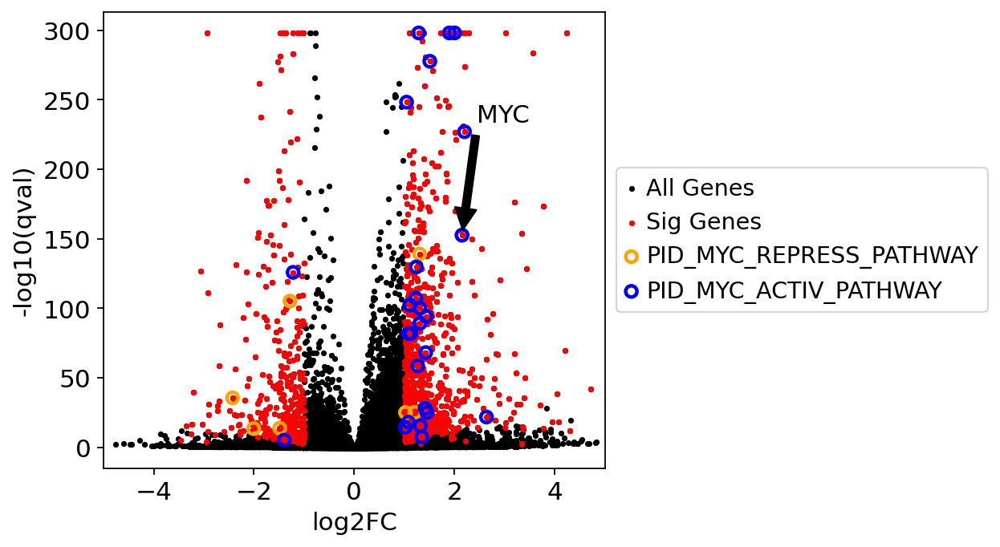

In [108]:
# volvano plot for activation signature 
import os
act_sig = pd.read_csv('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_table.csv', index_col=0)
act_sig['padj'][act_sig['padj'] ==0] = np.min(act_sig['padj'][act_sig['padj'] !=0])
act_sig['-log10(padj)'] = -np.log10(act_sig['padj'])
display(act_sig.head(3))

upG = np.genfromtxt('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_upG.txt', dtype=str)
downG = np.genfromtxt('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_downG.txt', dtype=str)
sigG = np.append(upG, downG)
print(len(sigG))
sigGidx = np.in1d(act_sig['GN'], sigG)

with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c2.cp.pid.v7.0.symbols.gmt') as f:
    DBcont = f.readlines()

mycTG = {}
for i in range(len(DBcont)):
    lcont = DBcont[i].split('\t')
    pathway = lcont[0]
    if 'MYC_' in pathway:
        print(pathway)
        mycTG[pathway] =lcont[2:]
        
col = ['b', '#00FFFF', '#ffa500']
fig, ax = plt.subplots(figsize=(8,4.5))
ax.scatter(act_sig['logFC'], act_sig['-log10(padj)'], s=5, c='black', label='All Genes')
ax.grid(False)
ax.set_xlim([-5,5])
ax.scatter(act_sig['logFC'][sigGidx], act_sig['-log10(padj)'][sigGidx], s=5, c='red', label='Sig Genes')
ax.set_xlabel('log2FC')
ax.set_ylabel('-log10(qval)')
keys = list(mycTG.keys())
for k in [2,0]: #range(len(keys))
    GL = np.intersect1d(mycTG[keys[k]], np.array([x.upper() for x in sigG]))
    GLidx = np.in1d(act_sig['GN'], GL)
    ax.scatter(act_sig['logFC'][GLidx], act_sig['-log10(padj)'][GLidx], s=40, facecolors='none', edgecolors=col[k], label=keys[k],linewidth=2)
    #repel_labels(ax, act_sig['logFC'][GLidx], act_sig['-log10(padj)'][GLidx], act_sig['GN'][GLidx], k=0.0001)
mycidx =np.in1d(act_sig['GN'], 'MYC')
ax.annotate('MYC', xy=(act_sig['logFC'][mycidx], act_sig['-log10(padj)'][mycidx]),  xycoords='data',
            xytext=(0.85, 0.8), textcoords='axes fraction',
            arrowprops=dict(facecolor='black', shrink=0.05),
            horizontalalignment='right', verticalalignment='top',
            )
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.savefig('./figures/Volcano_activation.pdf')

In [51]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')
with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c2.cp.pid.v7.0.symbols.gmt') as f:
    DBcont = f.readlines()

upG = np.genfromtxt('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_upG.txt', dtype=str)

TotalGenes = adata.raw.var_names
smqpp.pathway_analysis(upG, TotalGenes, DBcont).to_csv('./Act_PID.csv', index=0)

In [52]:
%load_ext rpy2.ipython

R[write to console]: Loading required package: qusage

R[write to console]: Loading required package: limma

R[write to console]: Loading required package: ggplot2

R[write to console]: Loading required package: ggrepel



[1] 196   8
[1] 899
[1] 364


R[write to console]: Saving 6.67 x 6.67 in image



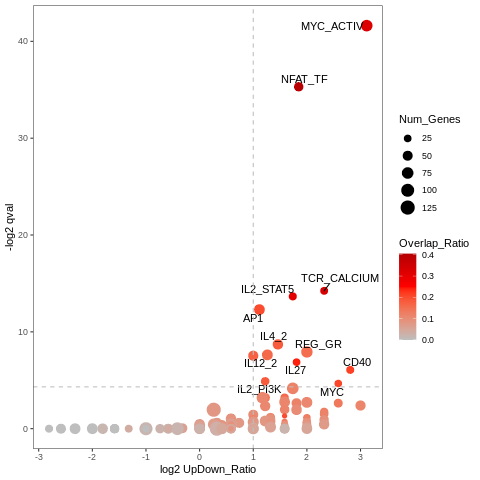

In [53]:
%%R 
require("qusage")
require("ggplot2")
require("ggrepel")

tab = read.table('Act_PID.csv', sep=',', header=T)
db = read.gmt('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c2.cp.pid.v7.0.symbols.gmt')
print(dim(tab))
upG = read.csv('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_upG.txt', header=F)[,1]
print(length(upG))
downG = read.csv('./DEres/Tcells_StiVecP_L2_1vsrest/StiVecP_L2_1vsrest_downG.txt', header=F)[,1]
print(length(downG))

qval_cutoff = 0.05
freqFC = unlist(lapply(tab$Pathway, function(x){
    overlapUP = length(intersect(upG, db[[match(x, names(db))]]))
    overlapDOWN = length(intersect(downG, db[[match(x, names(db))]]))
    freqpn = (overlapUP+1)/(overlapDOWN+1)
    return(freqpn)
}))
Term = gsub("PID_(.*)PATHWAY", "\\1", tab$Pathway)
Term = gsub("(.*)_$", "\\1", Term)
Ftab = data.frame(Term=Term, qval=-log2(tab$padj), Num_Genes=tab$n, UpDown_Ratio=log2(freqFC), Overlap_Ratio=tab$k/tab$n)
                    
p <- ggplot(Ftab, aes(x=UpDown_Ratio, y=qval))+geom_point(aes(size=Num_Genes, color=Overlap_Ratio))
p <- p + scale_colour_gradient2(low='grey', mid='red', high='dark red',midpoint=0.25)
p <- p + ylab('-log2 qval')
p <- p + xlab('log2 UpDown_Ratio')
p <- p + geom_text_repel(data=subset(Ftab, qval > -log2(qval_cutoff) & UpDown_Ratio > 1),
                         aes(label=Term)
)
p <- p + theme_bw() + theme(plot.background = element_blank(),
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank())
p <- p + geom_hline(yintercept = -log2(qval_cutoff),linetype = "dashed", color='grey')
p <- p + geom_vline(xintercept = 1,linetype = "dashed", color='grey')
p
ggsave('./figures/Activation_pathway.pdf', useDingbats = FALSE)
p

# DE Ex vs NonEx

In [10]:
Extable = pd.crosstab(adata.obs['comb_con'], adata.obs['ExCells'], margins=True)
Extable.to_csv('./table/Extable.csv')

In [5]:
adata.obs['comb_con1'] = adata.obs['leiden_v1'].astype(str)+'_'+adata.obs['Condition'].astype(str)+'_'+adata.obs['Vec_binary'].astype(str)+'_'+adata.obs['ExCells'].astype(str)

In [11]:
g1 = adata.obs_names[((adata.obs['Condition']=='Stimulated') & (adata.obs['Vec_binary']=='Vec+') & (adata.obs['ExCells'] == 'Ex') & (adata.obs['leiden_v1'] == 'L2_1') )] 
temp = adata[((adata.obs['Condition']=='Stimulated') & (adata.obs['Vec_binary']=='Vec+') & (adata.obs['ExCells'] == 'Non-Ex') & (adata.obs['leiden_v1'] == 'L2_1') ),:].copy()
print(temp.shape)
g2 = temp.obs['Ex_score'].sort_values().index[0:len(g1)]
CNlist = g1.append(g2)
print(len(CNlist))
temp = adata[CNlist,:].copy()
print(temp.shape)

(1001, 1104)
306
(306, 1104)


In [13]:
print("Ex cells: "+str(np.sum(temp.obs['comb_con1']=='L2_1_Stimulated_Vec+_Ex')))
print("Non-Ex cells: "+str(np.sum(temp.obs['comb_con1']=='L2_1_Stimulated_Vec+_Ex')))

Ex cells: 153
Non-Ex cells: 153


In [42]:
sc.tl.rank_genes_groups(temp, groupby='comb_con1', reference='L2_1_Stimulated_Vec+_Non-Ex', groups=['L2_1_Stimulated_Vec+_Ex'], n_genes=temp.raw.shape[1], key_added='DE_L2_1_Sti_VP_ExvsNonEx', method='t-test')

ranking genes
    finished: added to `.uns['DE_L2_1_Sti_VP_ExvsNonEx']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


(306, 1104)
(306, 21801)
upRegulated gene: 274
downRegulated gene: 206


/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/smqpp/__init__.py:716: RuntimeWarning: divide by zero encountered in log2
  logExp = np.log2(normExp)


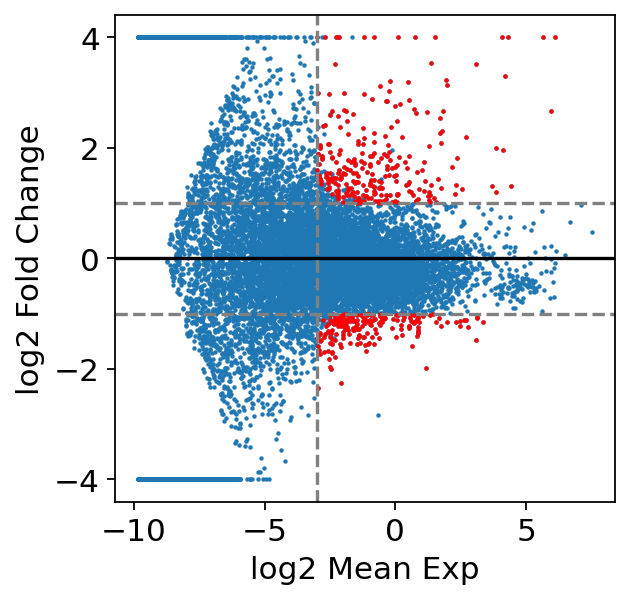

In [10]:
import smqpp
upG, downG, tableG = smqpp.plot_ma(temp, 'DE_L2_1_Sti_VP_ExvsNonEx', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-3)

In [11]:
upG.values

array(['CCL3', 'CCL4', 'SRGN', 'LAG3', 'PHLDA1', 'HOPX', 'CD7', 'CSF2',
       'ENTPD1', 'CREM', 'TNFRSF9', 'SERPINB9', 'IFNG', 'LGALS1',
       'RNF19A', 'CD70', 'NKG7', 'SH2D2A', 'CCL5', 'CD99', 'CTLA4',
       'CD82', 'CD40LG', 'S100A4', 'ID2', 'GZMB', 'FASLG', 'SLA', 'CTSW',
       'RGS16', 'GNLY', 'RUNX3', 'GBP2', 'SPOCK2', 'SDC4', 'HAVCR2',
       'FAM3C', 'RGCC', 'SDCBP', 'ARL6IP1', 'CD9', 'LTB', 'EVI2A', 'MCL1',
       'IL4I1', 'TNFRSF18', 'GZMA', 'CD96', 'BIRC3', 'MAP3K8',
       'AC092580.4', 'GPR56', 'ITM2B', 'CCL1', 'BHLHE40', 'BTG2', 'LBH',
       'PRF1', 'CFLAR', 'DOK2', 'TNFAIP8', 'ITGB7', 'CSF1', 'DUSP5',
       'TANK', 'AGPAT9', 'LMO4', 'CST7', 'ZFP36L1', 'UCP2', 'GPR65',
       'EED', 'RHBDD2', 'ISG15', 'MAP1LC3A', 'PTGER4', 'IRF7', 'CD59',
       'CHST12', 'CD69', 'PRSS23', 'IFI6', 'RIN3', 'YPEL5', 'RDH10',
       'FYN', 'SCPEP1', 'CITED2', 'HCST', 'CD8A', 'CTSD', 'RAB11FIP1',
       'GADD45G', 'TGIF1', 'XCL1', 'APOBEC3G', 'ITPR1', 'TNFSF10', 'BTG1',
       'GNPTAB',

In [12]:
np.savetxt('./DEres/Tcells_Ex/L2_1_Sti_VP_ExvsNonEx_upG.txt', upG, delimiter='\t', fmt='%s')
np.savetxt('./DEres/Tcells_Ex/L2_1_Sti_VP_ExvsNonEx_downG.txt', downG, delimiter='\t', fmt='%s')
tableG.to_csv('./DEres/Tcells_Ex/L2_1_Sti_VP_ExvsNonEx_table.csv')

In [50]:
# save for GSEA
GSEAdf = pd.DataFrame(np.vstack([temp.uns['DE_L2_1_Sti_VP_ExvsNonEx']['names']['L2_1_Stimulated_Vec+_Ex'],temp.uns['DE_L2_1_Sti_VP_ExvsNonEx']['scores']['L2_1_Stimulated_Vec+_Ex']]).T)
GSEAdf.to_csv('./GSEA_table/ex.rnk', sep='\t', header=False, index=False)

... storing 'comb_con1' as categorical


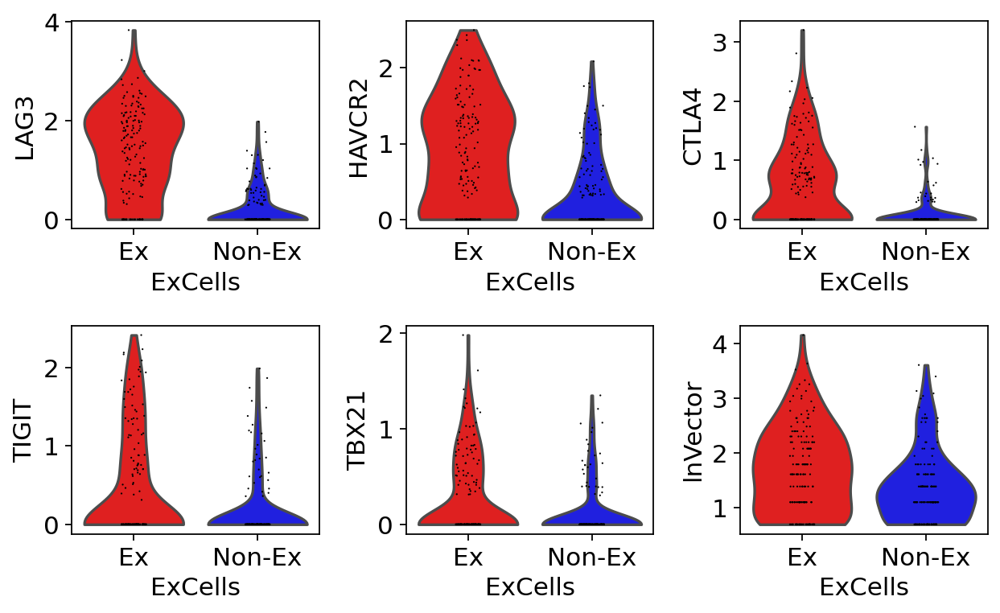

In [7]:
fig, ax = plt.subplots(2,3,figsize=(8,5))
keys = ['LAG3', 'HAVCR2', 'CTLA4', 'TIGIT', 'TBX21', 'logVector']
for i in range(len(keys)):
    colidx = i%3
    rowidx = np.floor(i/3).astype(int)
    sc.pl.violin(temp, keys=keys[i], groupby='ExCells', ax=ax[rowidx][colidx], show=False)
    ax[rowidx][colidx].grid(False)
    if keys[i] == 'logVector':
        ax[rowidx][colidx].set_ylabel('lnVector')
plt.tight_layout()
plt.savefig('./figures/Violinplot_Exgenes.pdf')

In [12]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [13]:
adata.uns['ExCells_colors'] = ['#ff0000', '#a9a9a9', '#d3d3d3']

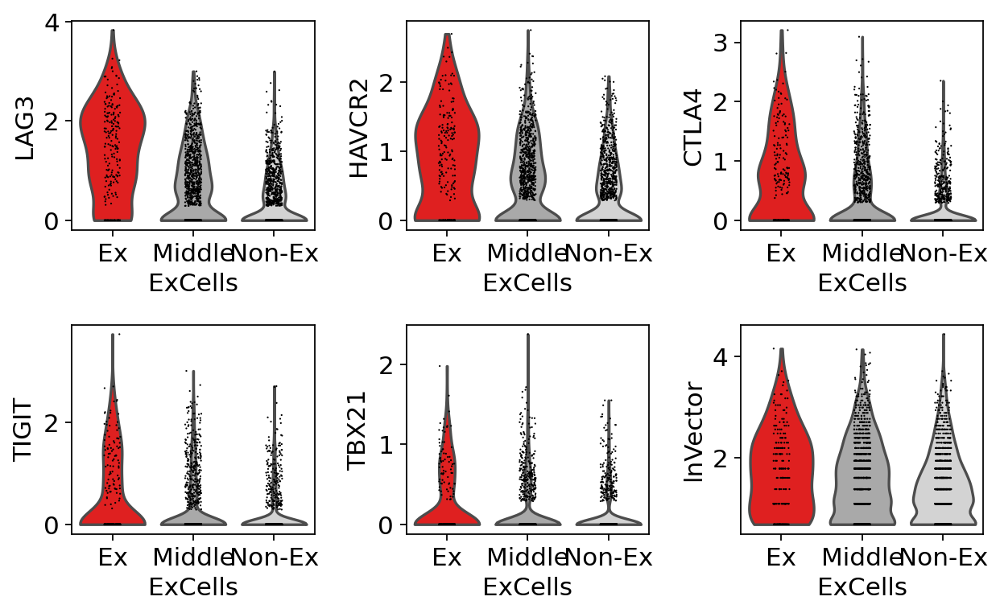

In [14]:
fig, ax = plt.subplots(2,3,figsize=(8,5))
keys = ['LAG3', 'HAVCR2', 'CTLA4', 'TIGIT', 'TBX21', 'logVector']
for i in range(len(keys)):
    colidx = i%3
    rowidx = np.floor(i/3).astype(int)
    sc.pl.violin(adata[(adata.obs['leiden_v1'] == 'L2_1') & (adata.obs['Vec_binary']=='Vec+')], keys=keys[i], groupby='ExCells', ax=ax[rowidx][colidx], show=False)
    ax[rowidx][colidx].grid(False)
    if keys[i] == 'logVector':
        ax[rowidx][colidx].set_ylabel('lnVector')
plt.tight_layout()
plt.savefig('./figures/Violinplot_Exgenes_CAR+L2_1.pdf')

In [14]:
temp.write('./write/L2_1_Sti_VP_CD4.h5ad')

# DE each cluster

In [ ]:
# leiden_cl = adata.obs['leiden_v1'].cat.categories
# for cl in leiden_cl[0:10]: # L2_11 too small, ignore
#     print(cl)
#     adata_sub = adata[adata.obs['leiden_v1'] == cl, :].copy()
#     # cluster_StiVecPvsStiVecN
#     print('cluster_StiVecPvsStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Sti Vec-', groups=['Sti Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-5)
#     np.savetxt('./DEres/cluster_StiVecPvsStiVecN/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./DEres/cluster_StiVecPvsStiVecN/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./DEres/cluster_StiVecPvsStiVecN/'+cl+'_table.csv')
    
#     # cluster_UnStiVecPvsUnStiVecN
#     print('cluster_UnStiVecPvsUnStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unsti Vec-', groups=['Unsti Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-5)
#     np.savetxt('./DEres/cluster_UnStiVecPvsUnStiVecN/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./DEres/cluster_UnStiVecPvsUnStiVecN/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./DEres/cluster_UnStiVecPvsUnStiVecN/'+cl+'_table.csv')
    
#     # cluster_StiVecPvsUnStiVecP
#     print('cluster_StiVecPvsUnStiVecP')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unsti Vec+', groups=['Sti Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-5)
#     np.savetxt('./DEres/cluster_StiVecPvsUnStiVecP/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./DEres/cluster_StiVecPvsUnStiVecP/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./DEres/cluster_StiVecPvsUnStiVecP/'+cl+'_table.csv')
    
#     # cluster_StiVecNvsUnStiVecN
#     print('cluster_StiVecNvsUnStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unsti Vec-', groups=['Sti Vec-'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-5)
#     np.savetxt('./DEres/cluster_StiVecNvsUnStiVecN/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./DEres/cluster_StiVecNvsUnStiVecN/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./DEres/cluster_StiVecNvsUnStiVecN/'+cl+'_table.csv')
                            
#     del adata_sub

In [ ]:
# import os
# import re
# import seaborn as sns
# dirloc = './DEres/cluster_UnStiVecPvsUnStiVecN/'
# files = os.listdir(dirloc)
# upfiles = [x for x in files if ('upG' in x) & (os.path.getsize(dirloc+x) > 0)]
# print(upfiles)
# DEGL = {}
# for f in upfiles:
#     cl = re.search("(.*)_upG.txt",f).group(1)
#     DEGL[cl] = np.genfromtxt(dirloc+f, dtype='str').reshape(-1)
# print(DEGL.keys())
# DEGL_unique = np.unique(np.concatenate([DEGL[x] for x in DEGL.keys()]))
# print(len(DEGL_unique))
# DEGL_matrix = np.vstack([np.in1d(DEGL_unique, DEGL[x])*1 for x in DEGL.keys()]).T
# DEGL_df = pd.DataFrame(DEGL_matrix)
# DEGL_df.columns = DEGL.keys()
# DEGL_df.index = DEGL_unique
# g = sns.clustermap(DEGL_df,method="ward", xticklabels=True, yticklabels=True, cmap=cmap, figsize=(6,8)) 
# #plt.savefig('./figures/Heatmap_cluster_UnStiVecPvsUnStiVecN_upG.pdf')

# dirloc = './DEres/cluster_UnStiVecPvsUnStiVecN/'
# files = os.listdir(dirloc)
# upfiles = [x for x in files if ('downG' in x) & (os.path.getsize(dirloc+x) > 0)]
# print(upfiles)
# DEGL = {}
# for f in upfiles:
#     cl = re.search("(.*)_downG.txt",f).group(1)
#     DEGL[cl] = np.genfromtxt(dirloc+f, dtype='str').reshape(-1)[0:5]
# print(DEGL.keys())
# DEGL_unique = np.unique(np.concatenate([DEGL[x] for x in DEGL.keys()]))
# print(len(DEGL_unique))
# DEGL_matrix = np.vstack([np.in1d(DEGL_unique, DEGL[x])*1 for x in DEGL.keys()]).T
# DEGL_df = pd.DataFrame(DEGL_matrix)
# DEGL_df.columns = DEGL.keys()
# DEGL_df.index = DEGL_unique
# g = sns.clustermap(DEGL_df,method="ward", xticklabels=True, yticklabels=True, cmap=cmap, figsize=(6,8)) 
# plt.savefig('./figures/Heatmap_cluster_UnStiVecPvsUnStiVecN_downG.pdf')

# dirloc = './DEres/cluster_StiVecPvsUnStiVecP/'
# files = os.listdir(dirloc)
# upfiles = [x for x in files if ('upG' in x) & (os.path.getsize(dirloc+x) > 0)]
# print(upfiles)
# DEGL = {}
# for f in upfiles:
#     cl = re.search("(.*)_upG.txt",f).group(1)
#     DEGL[cl] = np.genfromtxt(dirloc+f, dtype='str').reshape(-1)[0:5]
# print(DEGL.keys())
# DEGL_unique = np.unique(np.concatenate([DEGL[x] for x in DEGL.keys()]))
# print(len(DEGL_unique))
# DEGL_matrix = np.vstack([np.in1d(DEGL_unique, DEGL[x])*1 for x in DEGL.keys()]).T
# DEGL_df = pd.DataFrame(DEGL_matrix)
# DEGL_df.columns = DEGL.keys()
# DEGL_df.index = DEGL_unique
# g = sns.clustermap(DEGL_df,method="ward", xticklabels=True, yticklabels=True, cmap=cmap, figsize=(6,8)) 
# plt.savefig('./figures/Heatmap_cluster_StiVecPvsUnStiVecP_upG.pdf')

# dirloc = './DEres/cluster_StiVecPvsUnStiVecP/'
# files = os.listdir(dirloc)
# upfiles = [x for x in files if ('downG' in x) & (os.path.getsize(dirloc+x) > 0)]
# print(upfiles)
# DEGL = {}
# for f in upfiles:
#     cl = re.search("(.*)_downG.txt",f).group(1)
#     DEGL[cl] = np.genfromtxt(dirloc+f, dtype='str').reshape(-1)[0:5]
# print(DEGL.keys())
# DEGL_unique = np.unique(np.concatenate([DEGL[x] for x in DEGL.keys()]))
# print(len(DEGL_unique))
# DEGL_matrix = np.vstack([np.in1d(DEGL_unique, DEGL[x])*1 for x in DEGL.keys()]).T
# DEGL_df = pd.DataFrame(DEGL_matrix)
# DEGL_df.columns = DEGL.keys()
# DEGL_df.index = DEGL_unique
# g = sns.clustermap(DEGL_df,method="ward", xticklabels=True, yticklabels=True, cmap=cmap, figsize=(6,10)) 
# plt.savefig('./figures/Heatmap_cluster_StiVecPvsUnStiVecP_downG.pdf')

# Cell Sig

In [8]:
import smqpp
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')
temp = adata.raw 
del adata.raw
import anndata
adata.raw = anndata.AnnData(X=temp.X.toarray(), var=temp.var, obs=adata.obs)
del temp

c2 all curated database

In [20]:
with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c2.all.v7.1.symbols.gmt') as f:
    DBcont = f.readlines()
DBcont = np.array(DBcont)
DBcont = DBcont[[(('BIOCARTA_' in x) | ('REACTOME_' in x) | ('PID_' in x) | ('KEGG_' in x) | ('HALLMARK_' in x)) for x in DBcont]]

In [70]:
c2DBres = smqpp.pathway_score_cal(adata, DBcont)
c2DB = anndata.AnnData(c2DBres, obs=adata.obs,  obsm=adata.obsm)
c2DB.var_names = [x[0:40] for x in c2DBres.columns]
c2DB.var_names_make_unique()
sc.tl.rank_genes_groups(c2DB, 'leiden_v1', n_genes=c2DB.shape[1], key_added='DE_leiden_v1', method='t-test')

ranking genes
    finished: added to `.uns['DE_leiden_v1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


Index(['L2_1', 'L2_2', 'L2_3', 'L2_4', 'L2_5', 'L2_6', 'L2_7', 'L2_8', 'L2_9',
       'L2_10', 'L2_11'],
      dtype='object')
0
(37898, 2019)
(37898, 2019)
upRegulated gene: 184
downRegulated gene: 12


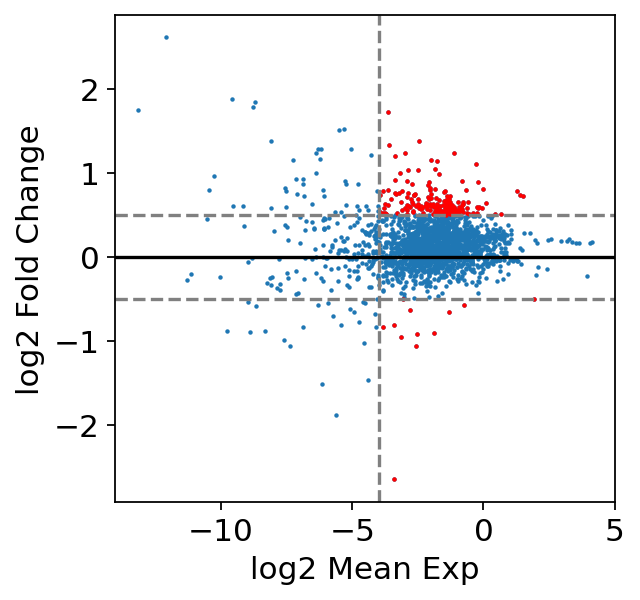

1
(37898, 2019)
(37898, 2019)
upRegulated gene: 27
downRegulated gene: 22


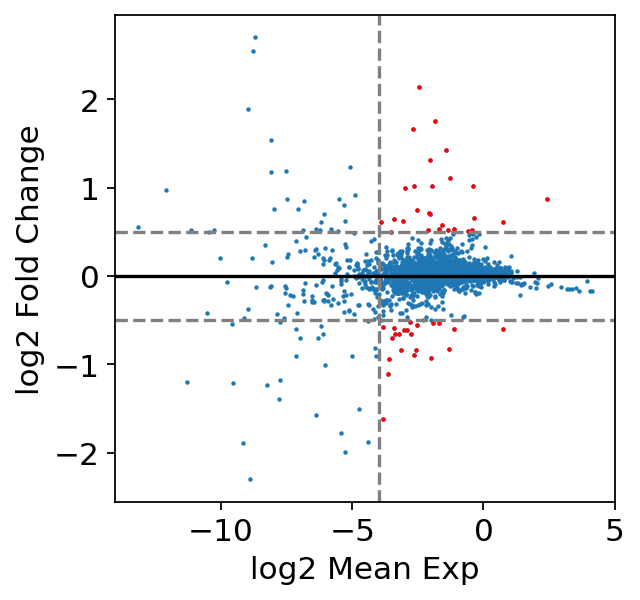

2
(37898, 2019)
(37898, 2019)
upRegulated gene: 8
downRegulated gene: 21


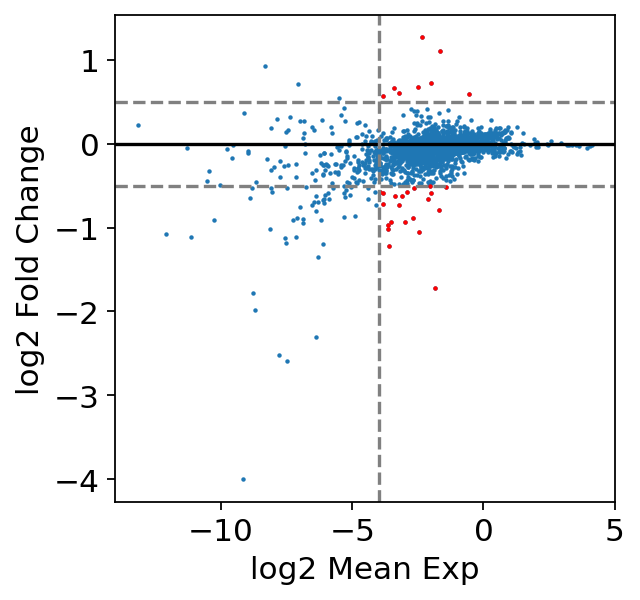

3
(37898, 2019)
(37898, 2019)
upRegulated gene: 66
downRegulated gene: 8


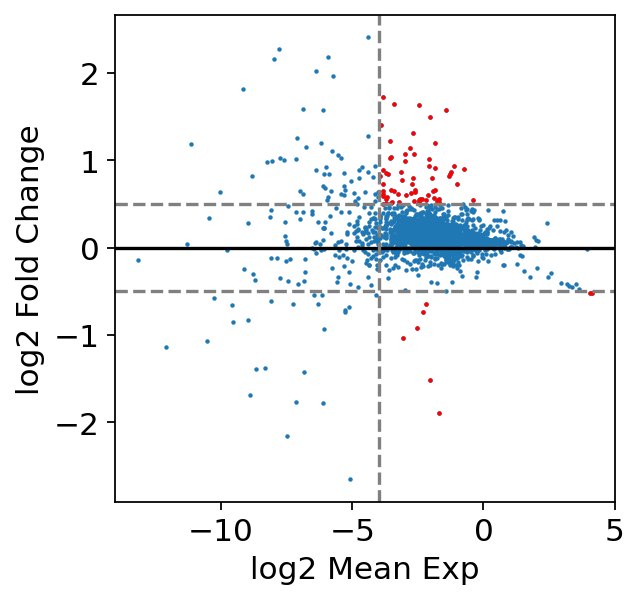

4
(37898, 2019)
(37898, 2019)
upRegulated gene: 2
downRegulated gene: 29


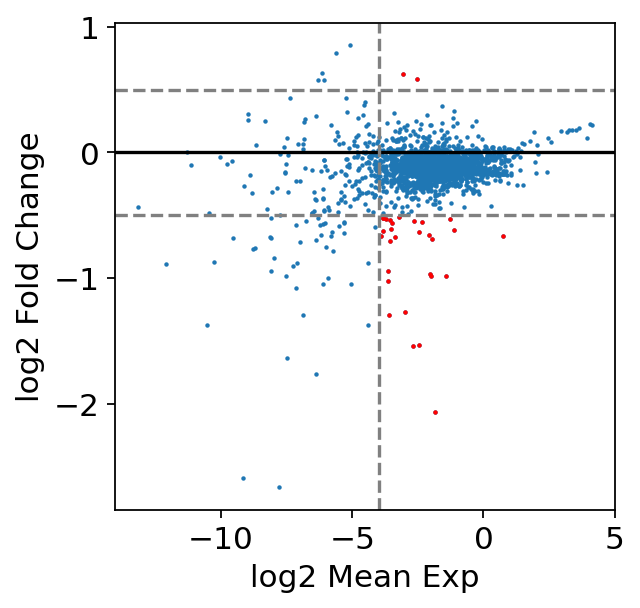

5
(37898, 2019)
(37898, 2019)
upRegulated gene: 0
downRegulated gene: 75


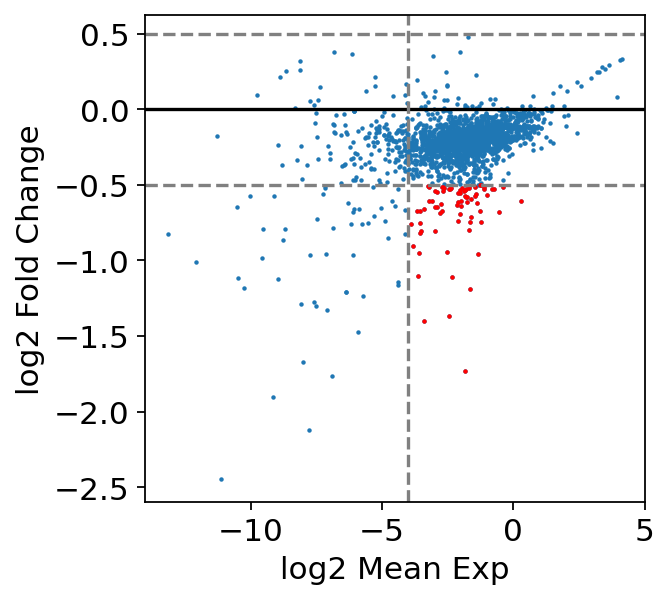

6
(37898, 2019)
(37898, 2019)
upRegulated gene: 11
downRegulated gene: 53


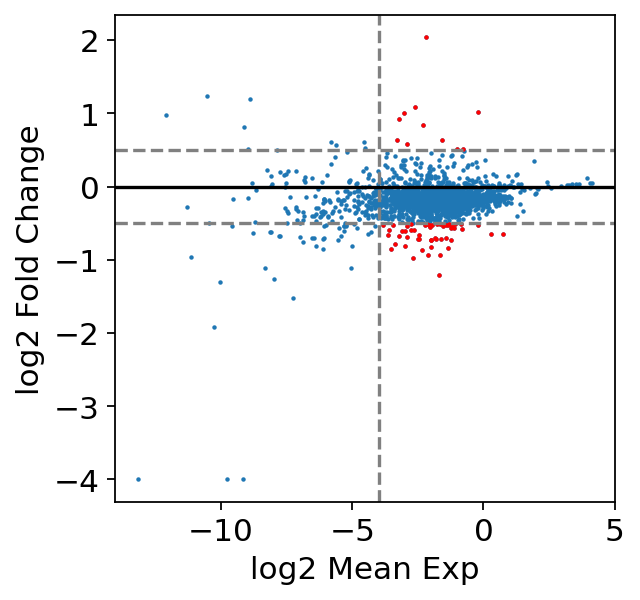

7
(37898, 2019)
(37898, 2019)
upRegulated gene: 98
downRegulated gene: 49


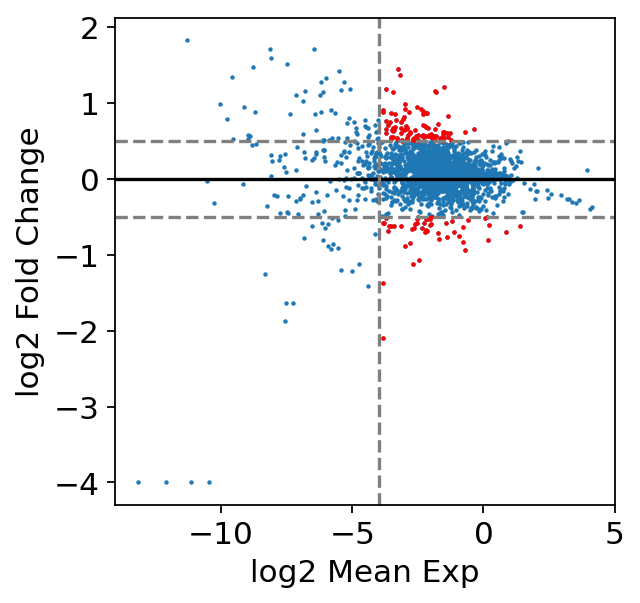

8
(37898, 2019)
(37898, 2019)
upRegulated gene: 99
downRegulated gene: 4


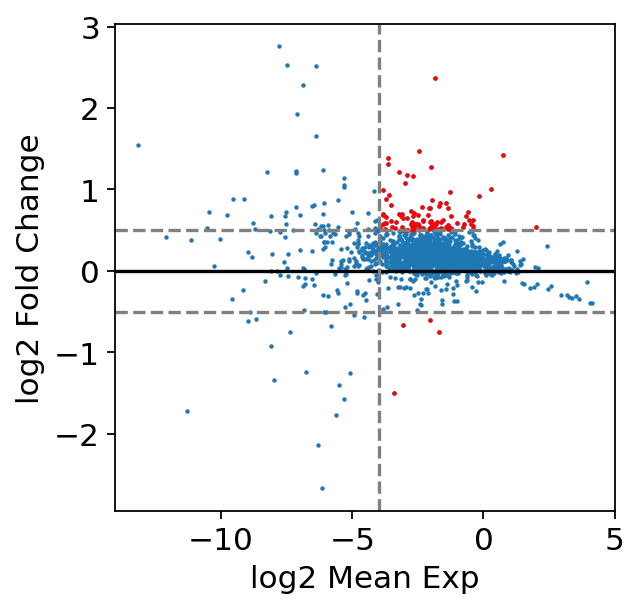

9
(37898, 2019)
(37898, 2019)
upRegulated gene: 10
downRegulated gene: 15


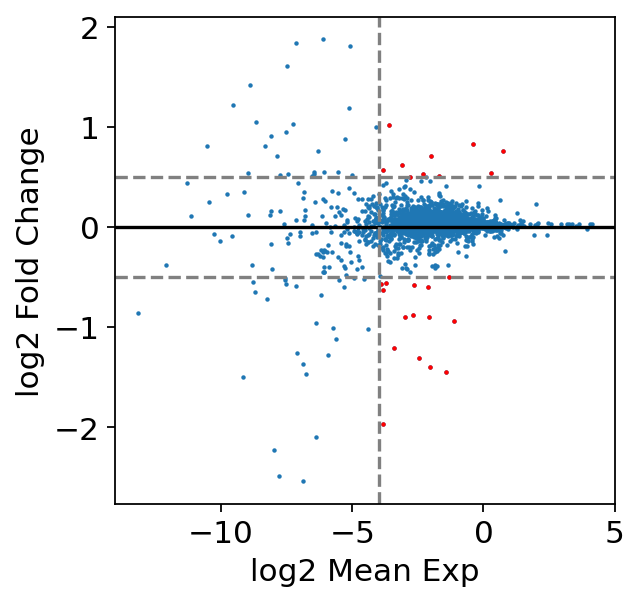

10
(37898, 2019)
(37898, 2019)
upRegulated gene: 136
downRegulated gene: 113


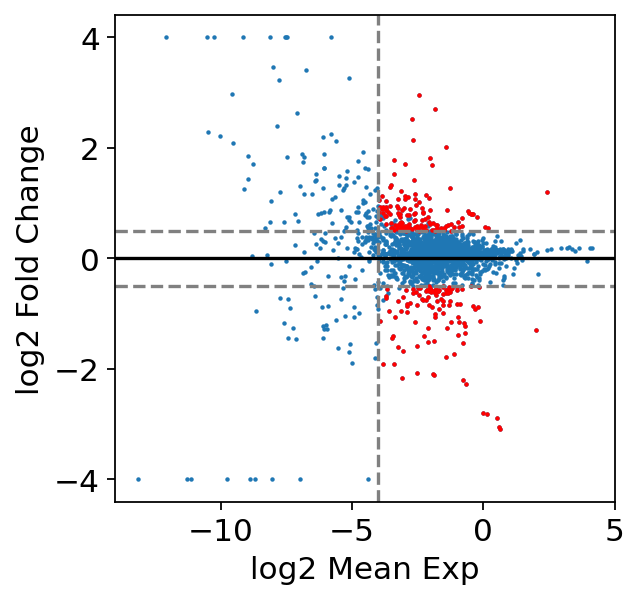

In [80]:
cat = c2DB.obs['leiden_v1'].cat.categories
print(cat)
c2DB.raw= c2DB
for x in range(len(cat)):
    print(x)
    upG, downG, tableG = smqpp.plot_ma(c2DB, 'DE_leiden_v1',cidx=int(x), padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
    np.savetxt('Pathway/Tcells_leiden_v1_c2DB/'+cat[x]+'vsAll_upG.txt', upG, delimiter='\t', fmt='%s')
    np.savetxt('Pathway/Tcells_leiden_v1_c2DB/'+cat[x]+'vsAll_downG.txt', downG, delimiter='\t', fmt='%s')
    tableG.to_csv('Pathway/Tcells_leiden_v1_c2DB/'+cat[x]+'vsAll_table.csv')

In [5]:
c2DB = sc.read('./write/Tcells_c2DB.h5ad')

In [6]:
import os
import re
GL2plot = {}
files = np.array(os.listdir('./Pathway/Tcells_leiden_v1_c2DB/'))
files = files[['upG' in x for x in files]]
print(files)
for f in files:
    cl = re.search('L2_\d+' , f)[0]
    GL2plot[cl] = np.genfromtxt('./Pathway/Tcells_leiden_v1_c2DB/'+f, dtype=str, delimiter='\t')[0:5]

['L2_5vsAll_upG.txt' 'L2_2vsAll_upG.txt' 'L2_3vsAll_upG.txt'
 'L2_9vsAll_upG.txt' 'L2_8vsAll_upG.txt' 'L2_11vsAll_upG.txt'
 'L2_4vsAll_upG.txt' 'L2_6vsAll_upG.txt' 'L2_10vsAll_upG.txt'
 'L2_7vsAll_upG.txt' 'L2_1vsAll_upG.txt']


/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: genfromtxt: Empty input file: "./Pathway/Tcells_leiden_v1_c2DB/L2_6vsAll_upG.txt"
  if __name__ == '__main__':


In [7]:
from collections import OrderedDict
ordered = OrderedDict()
for k in c2DB.obs['leiden_v1'].cat.categories:
    ordered[k] = GL2plot[k]

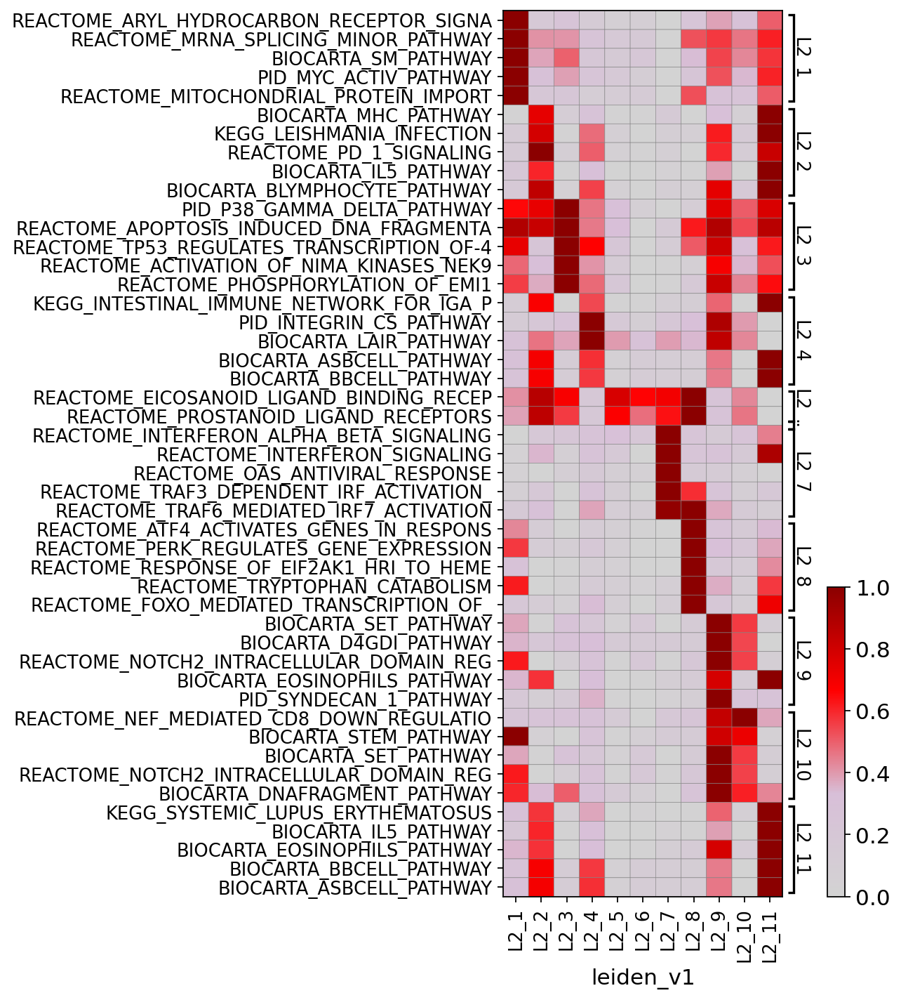

GridSpec(2, 3, height_ratios=[0, 9.4], width_ratios=[3.3, 0.4, 0.2])

In [8]:
sc.pl.matrixplot(c2DB, var_names=ordered, groupby='leiden_v1', standard_scale='var', cmap=cmap, swap_axes=True, save='_Tcells_leiden_v1_Top5c2DB.pdf')

In [115]:
c2DB.write('./write/Tcells_c2DB.h5ad')

In [126]:
L2_1 = pd.read_csv('./Pathway/Tcells_leiden_v1_c2DB/L2_1vsAll_table.csv', index_col=0)
L2_1 = L2_1.loc[['PID' in x for x in L2_1['GN']],:].copy()
print(L2_1.shape)
L2_1.head(3)

(216, 5)


,GN,logMeanExp,logFC,pvals,padj
3,PID_MYC_ACTIV_PATHWAY,-0.239929,0.519537,0.0,0.0
39,PID_NFAT_TFPATHWAY,-2.088515,0.883872,0.0,0.0
117,PID_IL2_PI3K_PATHWAY,-0.533906,0.314112,0.0,0.0


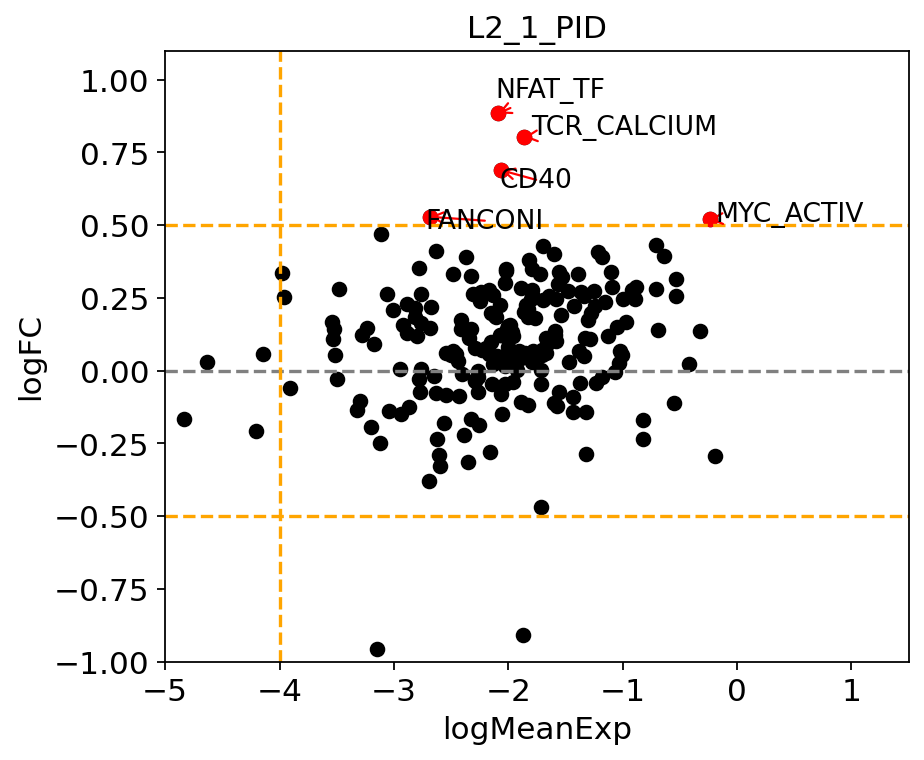

In [128]:
fig, ax = plt.subplots(figsize=(6,5))
ax.scatter(L2_1['logMeanExp'], L2_1['logFC'], color='black')
ax.grid(False)
idx = (L2_1['padj'] < 0.05) & (L2_1['logFC'] > 0.5) & (L2_1['logMeanExp'] > -4)
xs = L2_1['logMeanExp'][idx]
ys = L2_1['logFC'][idx]
label = [x.replace('PID_', '').replace('_PATHWAY', '').replace('PATHWAY', '') for x in L2_1['GN'][idx]]
ax.scatter(xs, ys, color='red')
repel_labels(ax, xs, ys, label, k=0.05)
ax.set_xlim([-5,1.5])
ax.set_ylim([-1,1.1])
ax.axhline(0, c='grey', linestyle='--')
ax.axhline(0.5, c='orange', linestyle='--')
ax.axhline(-0.5, c='orange', linestyle='--')
ax.axvline(-4, c='orange', linestyle='--')
ax.set_xlabel('logMeanExp')
ax.set_ylabel('logFC')
ax.set_title('L2_1_PID')
plt.tight_layout()
plt.savefig('./figures/L2_1_PID.pdf')

In [40]:
c2DB = sc.read('./write/Tcells_c2DB.h5ad')

In [ ]:
# leiden_cl = c2DB.obs['leiden_v1'].cat.categories
# for cl in leiden_cl[0:10]: # L2_11 too small, ignore
#     print(cl)
#     adata_sub = c2DB[c2DB.obs['leiden_v1'] == cl, :].copy()
#     # cluster_StiVecPvsStiVecN
#     print('cluster_StiVecPvsStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Stimulated Vec-', groups=['Stimulated Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_StiVecPvsStiVecN_c2DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_StiVecPvsStiVecN_c2DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_StiVecPvsStiVecN_c2DB/'+cl+'_table.csv')
    
#     # cluster_UnStiVecPvsUnStiVecN
#     print('cluster_UnStiVecPvsUnStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unstimulated Vec-', groups=['Unstimulated Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_UnStiVecPvsUnStiVecN_c2DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_UnStiVecPvsUnStiVecN_c2DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_UnStiVecPvsUnStiVecN_c2DB/'+cl+'_table.csv')
    
#     # cluster_StiVecPvsUnStiVecP
#     print('cluster_StiVecPvsUnStiVecP')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unstimulated Vec+', groups=['Stimulated Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_StiVecPvsUnStiVecP_c2DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_StiVecPvsUnStiVecP_c2DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_StiVecPvsUnStiVecP_c2DB/'+cl+'_table.csv')
    
#     # cluster_StiVecNvsUnStiVecN
#     print('cluster_StiVecNvsUnStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unstimulated Vec-', groups=['Stimulated Vec-'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_StiVecNvsUnStiVecN_c2DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_StiVecNvsUnStiVecN_c2DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_StiVecNvsUnStiVecN_c2DB/'+cl+'_table.csv')
                            
#     del adata_sub

c7 pathway

In [4]:
import smqpp
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')
temp = adata.raw 
del adata.raw
import anndata
adata.raw = anndata.AnnData(X=temp.X.toarray(), var=temp.var, obs=adata.obs)
del temp

In [6]:
with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c7.all.v7.2.symbols.gmt') as f:
    DBcont = f.readlines()

In [7]:
c7DBres = smqpp.pathway_score_cal(adata, DBcont)
c7DB = anndata.AnnData(c7DBres, obs=adata.obs,  obsm=adata.obsm)
c7DB.var_names = [x[0:40] for x in c7DBres.columns]
c7DB.var_names_make_unique()
sc.tl.rank_genes_groups(c7DB, 'leiden_v1', n_genes=c7DB.shape[1], key_added='DE_leiden_v1', method='t-test')

ranking genes
    finished: added to `.uns['DE_leiden_v1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:19)


Index(['L2_1', 'L2_2', 'L2_3', 'L2_4', 'L2_5', 'L2_6', 'L2_7', 'L2_8', 'L2_9',
       'L2_10', 'L2_11'],
      dtype='object')
0
(37898, 4872)
(37898, 4872)
upRegulated gene: 165
downRegulated gene: 6


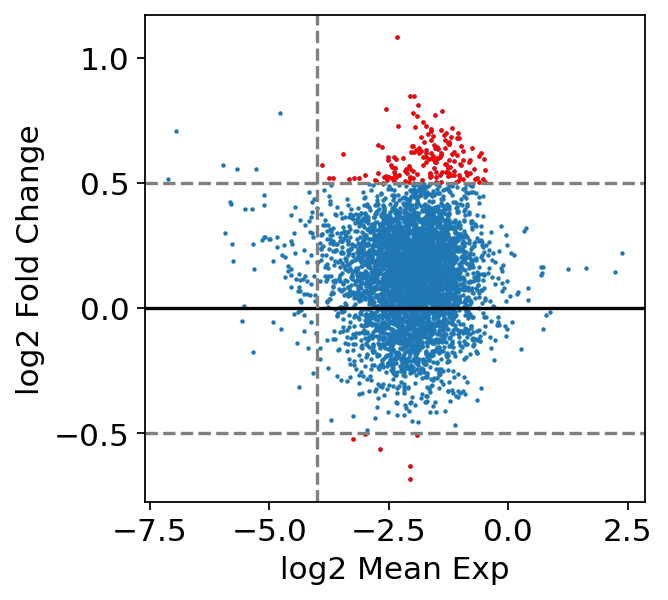

1
(37898, 4872)
(37898, 4872)
upRegulated gene: 4
downRegulated gene: 0


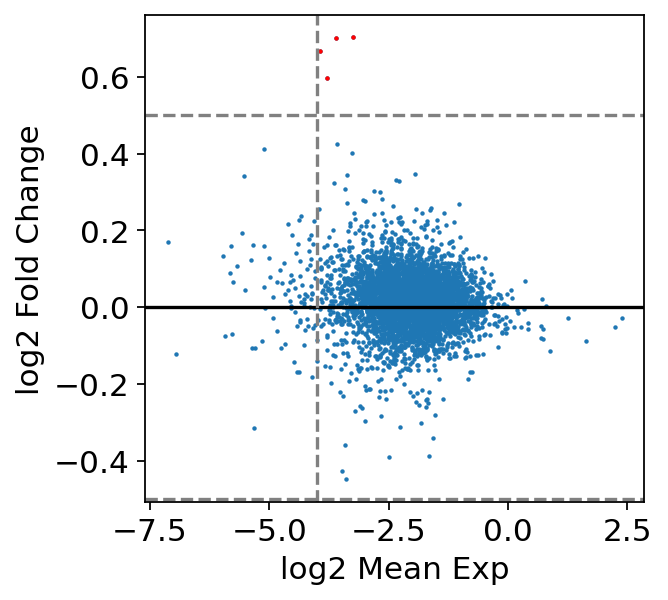

2
(37898, 4872)
(37898, 4872)
upRegulated gene: 0
downRegulated gene: 0


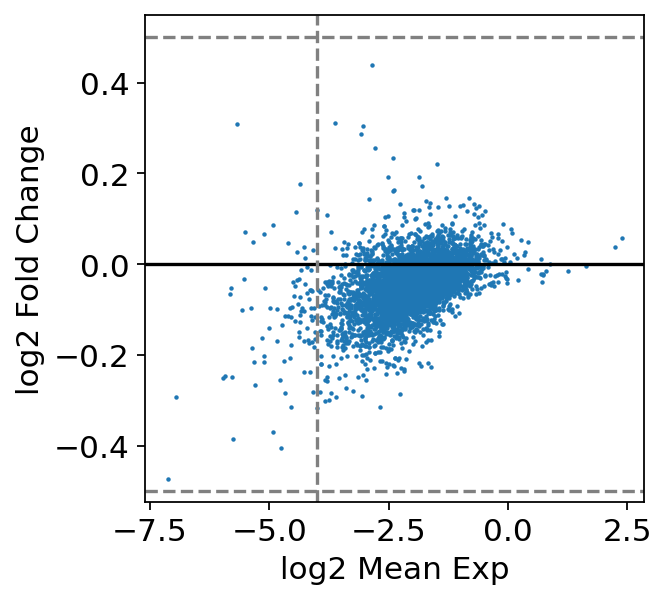

3
(37898, 4872)
(37898, 4872)
upRegulated gene: 2
downRegulated gene: 0


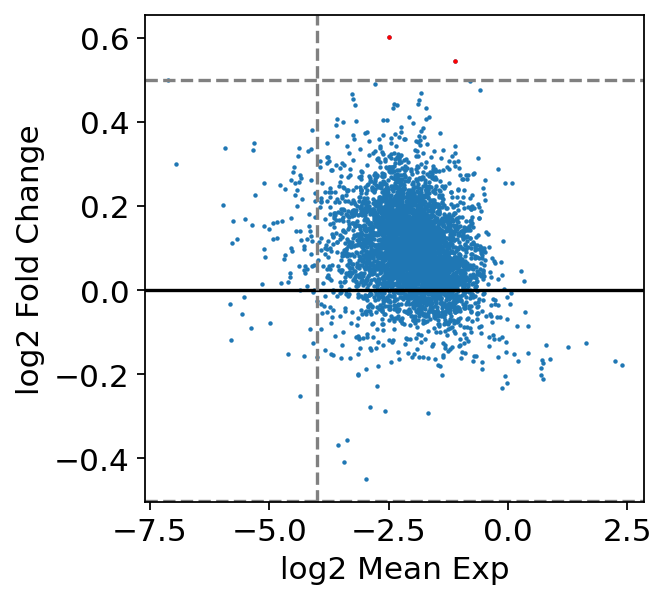

4
(37898, 4872)
(37898, 4872)
upRegulated gene: 0
downRegulated gene: 0


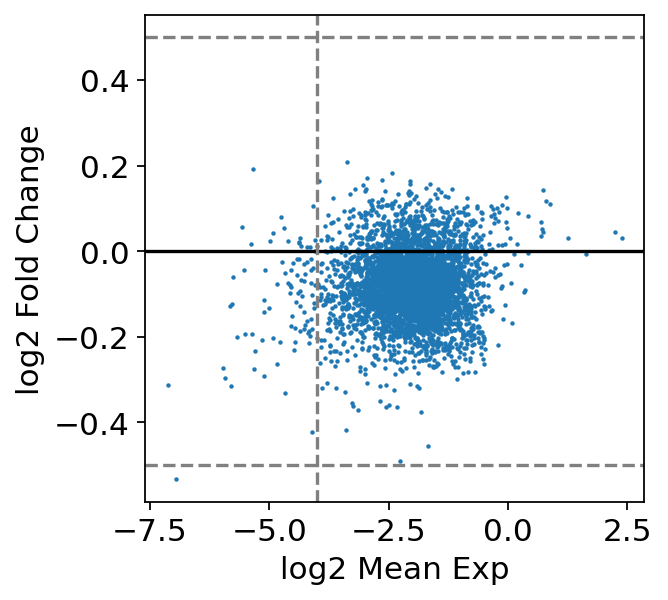

5
(37898, 4872)
(37898, 4872)
upRegulated gene: 0
downRegulated gene: 13


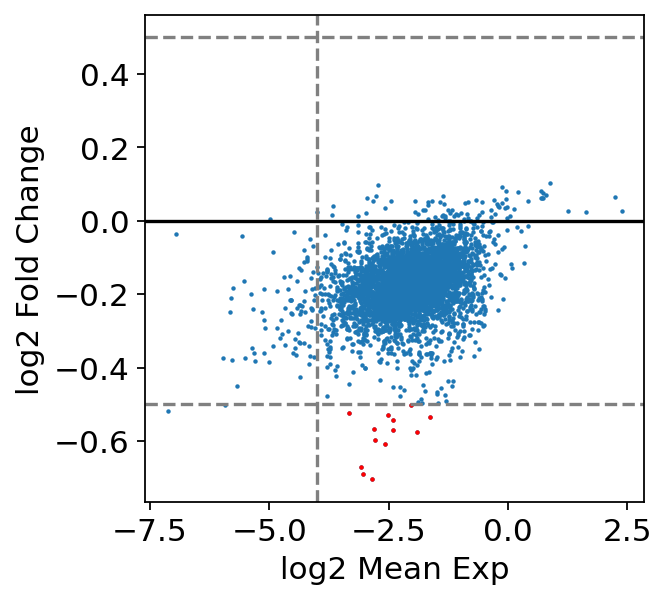

6
(37898, 4872)
(37898, 4872)
upRegulated gene: 89
downRegulated gene: 14


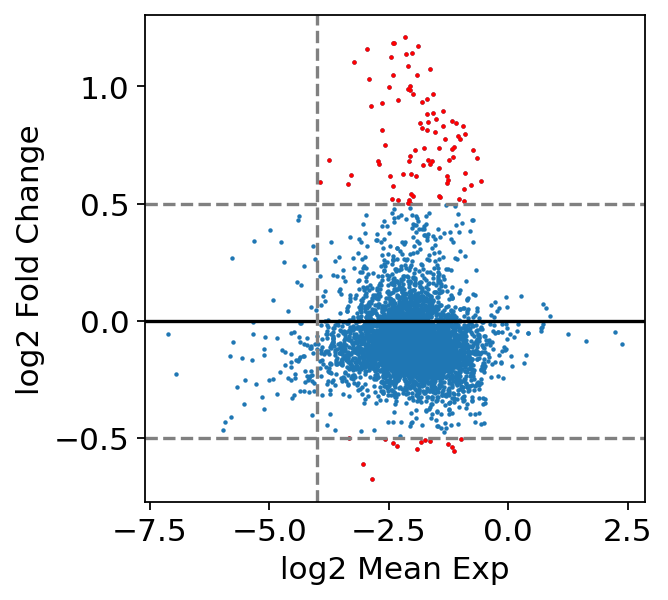

7
(37898, 4872)
(37898, 4872)
upRegulated gene: 112
downRegulated gene: 0


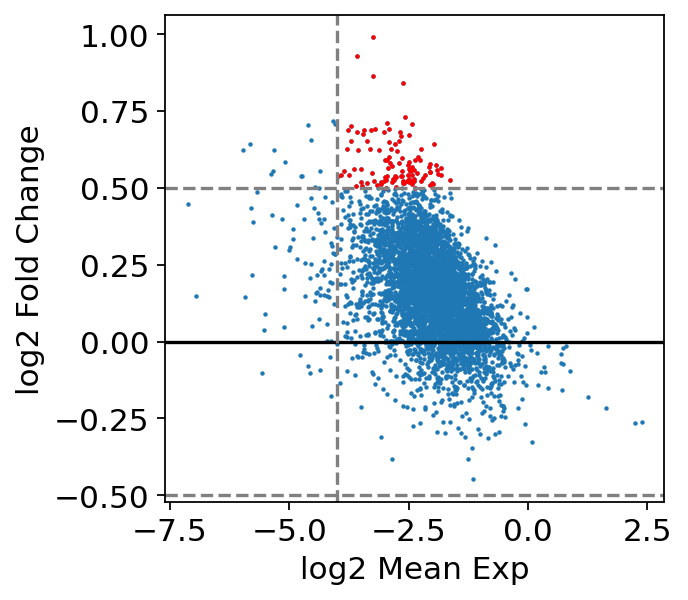

8
(37898, 4872)
(37898, 4872)
upRegulated gene: 53
downRegulated gene: 1


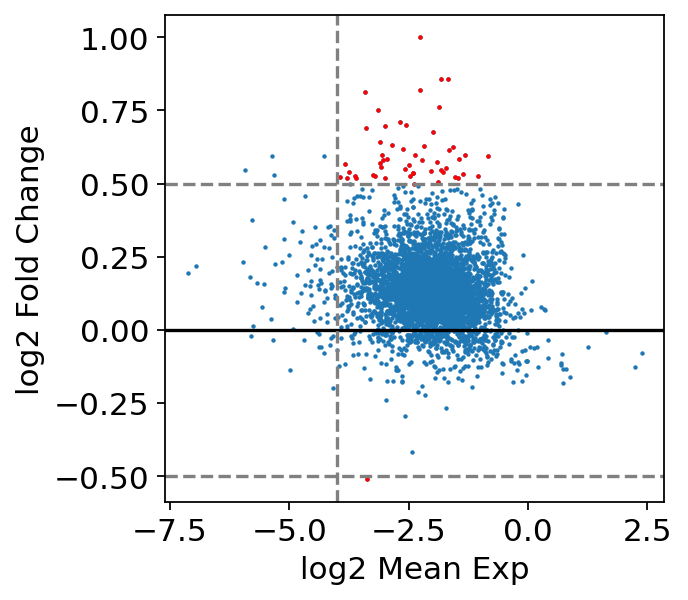

9
(37898, 4872)
(37898, 4872)
upRegulated gene: 2
downRegulated gene: 0


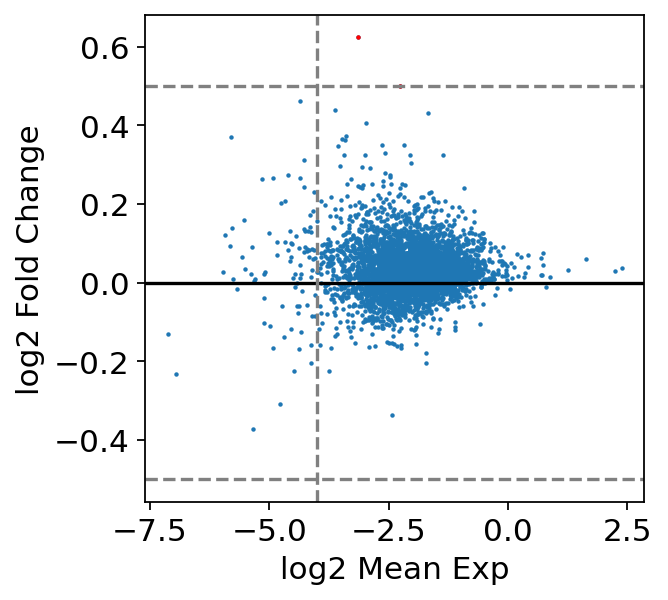

10
(37898, 4872)
(37898, 4872)
upRegulated gene: 81
downRegulated gene: 31


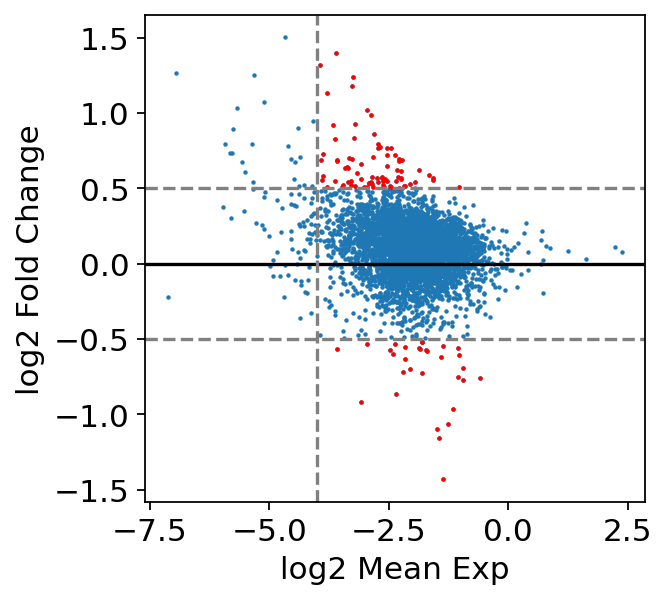

In [8]:
cat = c7DB.obs['leiden_v1'].cat.categories
print(cat)
c7DB.raw= c7DB
for x in range(len(cat)):
    print(x)
    upG, downG, tableG = smqpp.plot_ma(c7DB, 'DE_leiden_v1',cidx=int(x), padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
    np.savetxt('Pathway/Tcells_leiden_v1_c7DB/'+cat[x]+'vsAll_upG.txt', upG, delimiter='\t', fmt='%s')
    np.savetxt('Pathway/Tcells_leiden_v1_c7DB/'+cat[x]+'vsAll_downG.txt', downG, delimiter='\t', fmt='%s')
    tableG.to_csv('Pathway/Tcells_leiden_v1_c7DB/'+cat[x]+'vsAll_table.csv')

In [9]:
import os
import re
GL2plot = {}
files = np.array(os.listdir('./Pathway/Tcells_leiden_v1_c7DB/'))
files = files[['upG' in x for x in files]]
print(files)
for f in files:
    cl = re.search('L2_\d+' , f)[0]
    GL2plot[cl] = np.genfromtxt('./Pathway/Tcells_leiden_v1_c7DB/'+f, dtype=str, delimiter='\t')[0:5]

['L2_5vsAll_upG.txt' 'L2_2vsAll_upG.txt' 'L2_3vsAll_upG.txt'
 'L2_9vsAll_upG.txt' 'L2_8vsAll_upG.txt' 'L2_11vsAll_upG.txt'
 'L2_4vsAll_upG.txt' 'L2_6vsAll_upG.txt' 'L2_10vsAll_upG.txt'
 'L2_7vsAll_upG.txt' 'L2_1vsAll_upG.txt']


/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: genfromtxt: Empty input file: "./Pathway/Tcells_leiden_v1_c7DB/L2_5vsAll_upG.txt"
  if __name__ == '__main__':
/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: genfromtxt: Empty input file: "./Pathway/Tcells_leiden_v1_c7DB/L2_3vsAll_upG.txt"
  if __name__ == '__main__':
/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: genfromtxt: Empty input file: "./Pathway/Tcells_leiden_v1_c7DB/L2_6vsAll_upG.txt"
  if __name__ == '__main__':


In [13]:
from collections import OrderedDict
ordered = OrderedDict()
for k in c7DB.obs['leiden_v1'].cat.categories:
    ordered[k] = GL2plot[k]

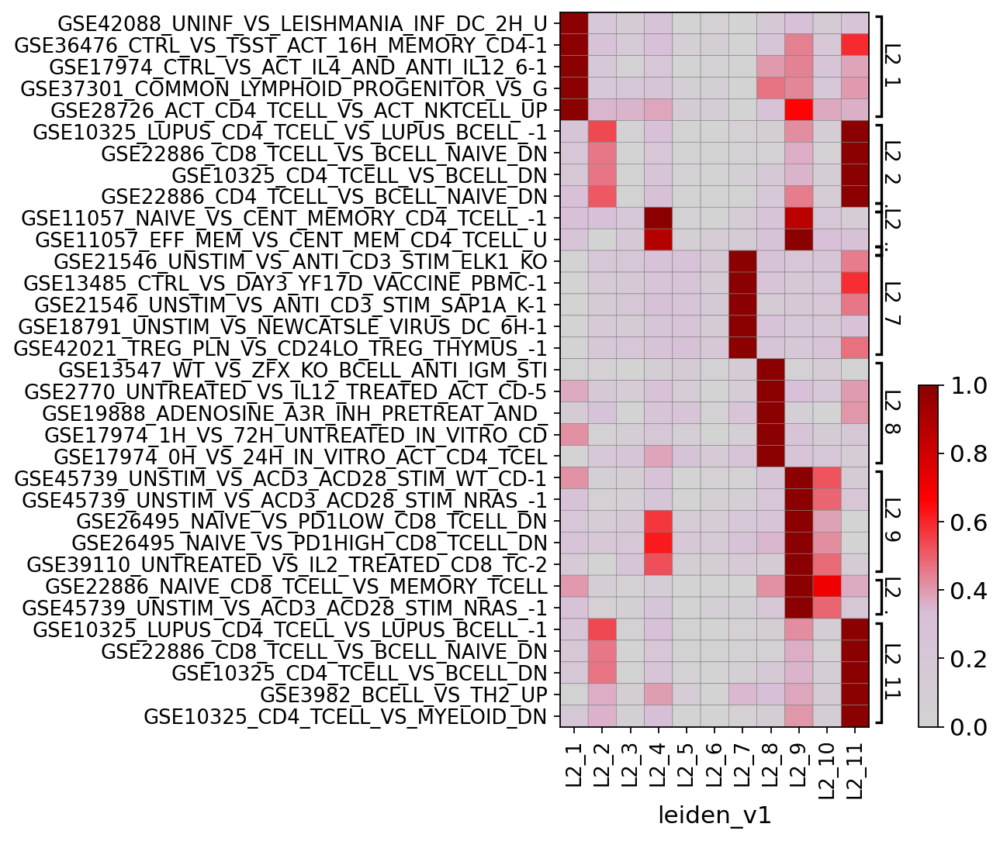

GridSpec(2, 3, height_ratios=[0, 6.6000000000000005], width_ratios=[3.3, 0.4, 0.2])

In [14]:
sc.pl.matrixplot(c7DB, var_names=ordered, groupby='leiden_v1', standard_scale='var', cmap=cmap, swap_axes=True, save='_Tcells_leiden_v1_Top5c7DB.pdf')

In [15]:
c7DB.write('./write/Tcells_c7DB.h5ad')

In [44]:
c7DB = sc.read('./write/Tcells_c7DB.h5ad')

In [ ]:
# leiden_cl = c7DB.obs['leiden_v1'].cat.categories
# for cl in leiden_cl[0:10]: # L2_11 too small, ignore
#     print(cl)
#     adata_sub = c7DB[c7DB.obs['leiden_v1'] == cl, :].copy()
#     # cluster_StiVecPvsStiVecN
#     print('cluster_StiVecPvsStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Sti Vec-', groups=['Sti Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_StiVecPvsStiVecN_c7DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_StiVecPvsStiVecN_c7DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_StiVecPvsStiVecN_c7DB/'+cl+'_table.csv')
    
#     # cluster_UnStiVecPvsUnStiVecN
#     print('cluster_UnStiVecPvsUnStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unsti Vec-', groups=['Unsti Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_UnStiVecPvsUnStiVecN_c7DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_UnStiVecPvsUnStiVecN_c7DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_UnStiVecPvsUnStiVecN_c7DB/'+cl+'_table.csv')
    
#     # cluster_StiVecPvsUnStiVecP
#     print('cluster_StiVecPvsUnStiVecP')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unsti Vec+', groups=['Sti Vec+'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_StiVecPvsUnStiVecP_c7DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_StiVecPvsUnStiVecP_c7DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_StiVecPvsUnStiVecP_c7DB/'+cl+'_table.csv')
    
#     # cluster_StiVecNvsUnStiVecN
#     print('cluster_StiVecNvsUnStiVecN')
#     sc.tl.rank_genes_groups(adata_sub, groupby='Sub_con', reference='Unsti Vec-', groups=['Sti Vec-'], n_genes=adata_sub.raw.shape[1], method='t-test')
#     upG, downG, tableG = smqpp.plot_ma(adata_sub, 'rank_genes_groups', cidx=0, padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
#     np.savetxt('./Pathway/cluster_StiVecNvsUnStiVecN_c7DB/'+cl+'_upG.txt', upG, delimiter='\t', fmt='%s')
#     np.savetxt('./Pathway/cluster_StiVecNvsUnStiVecN_c7DB/'+cl+'_downG.txt', downG, delimiter='\t', fmt='%s')
#     tableG.to_csv('./Pathway/cluster_StiVecNvsUnStiVecN_c7DB/'+cl+'_table.csv')
                            
#     del adata_sub

biomarker database

In [121]:
with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/Biomarkers_DB.gmt') as f:
    DBcont = f.readlines()
BMDBres = smqpp.pathway_score_cal(adata, DBcont)
BMDB = anndata.AnnData(BMDBres, obs=adata.obs,  obsm=adata.obsm)
BMDB.var_names = [x[0:40] for x in BMDBres.columns]
BMDB.var_names_make_unique()
sc.tl.rank_genes_groups(BMDB, 'leiden_v1', n_genes=BMDB.shape[1], key_added='DE_leiden_v1', method='t-test')

ranking genes
    finished: added to `.uns['DE_leiden_v1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


Index(['L2_1', 'L2_2', 'L2_3', 'L2_4', 'L2_5', 'L2_6', 'L2_7', 'L2_8', 'L2_9',
       'L2_10', 'L2_11'],
      dtype='object')
0
(37898, 483)
(37898, 483)
upRegulated gene: 13
downRegulated gene: 16


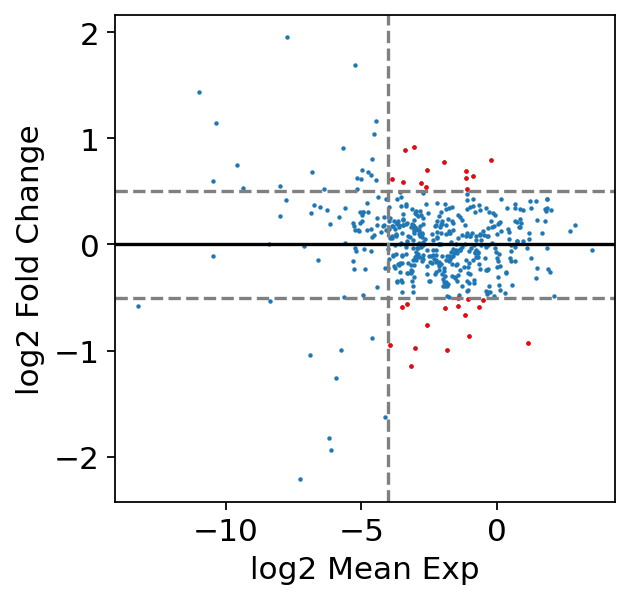

1
(37898, 483)
(37898, 483)
upRegulated gene: 1
downRegulated gene: 9


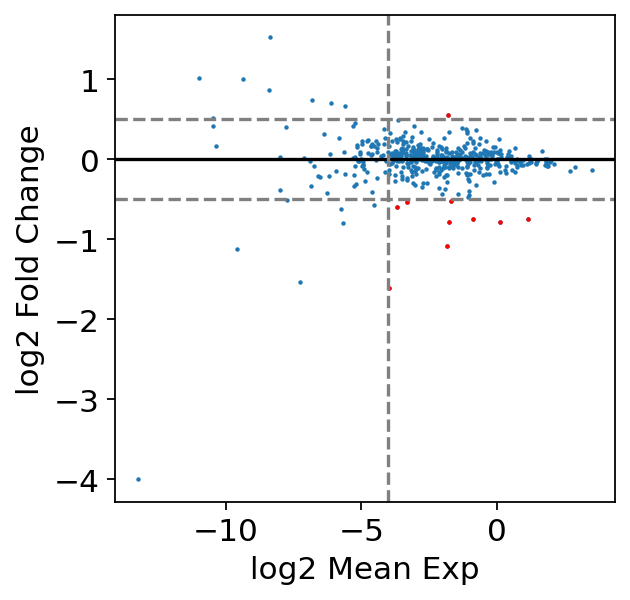

2
(37898, 483)
(37898, 483)
upRegulated gene: 0
downRegulated gene: 3


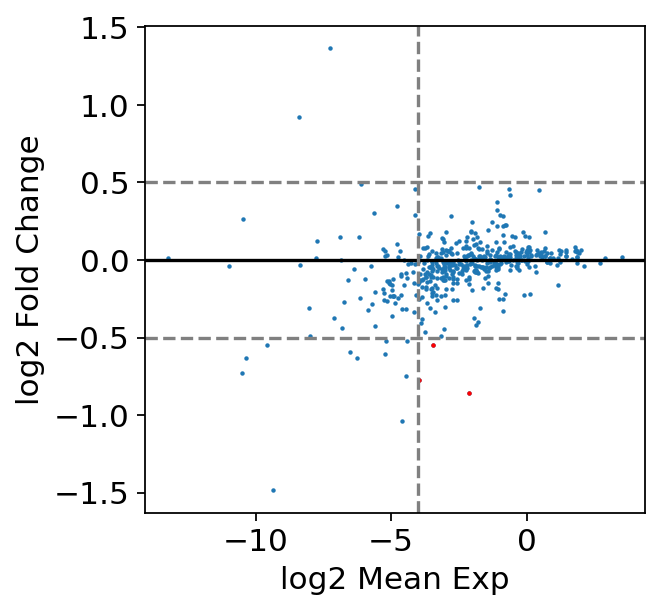

3
(37898, 483)
(37898, 483)
upRegulated gene: 9
downRegulated gene: 2


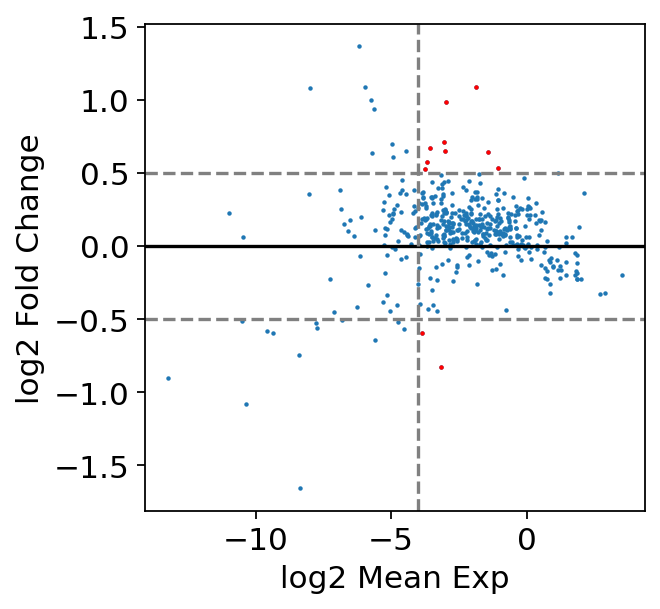

4
(37898, 483)
(37898, 483)
upRegulated gene: 0
downRegulated gene: 5


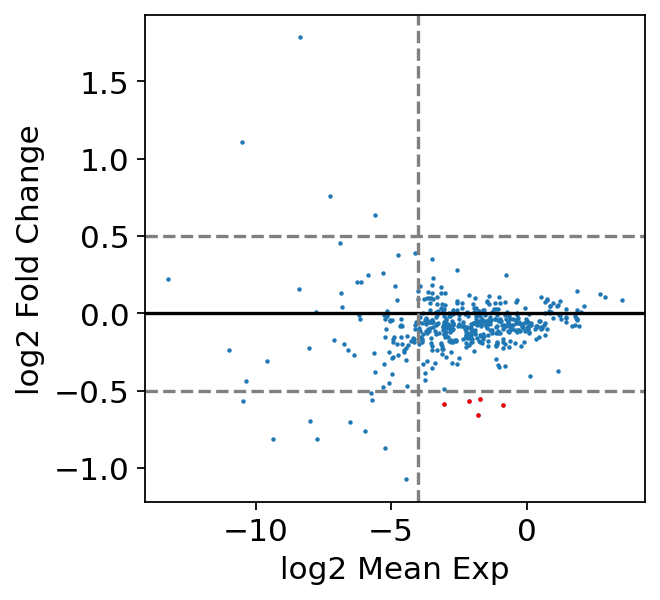

5
(37898, 483)
(37898, 483)
upRegulated gene: 1
downRegulated gene: 18


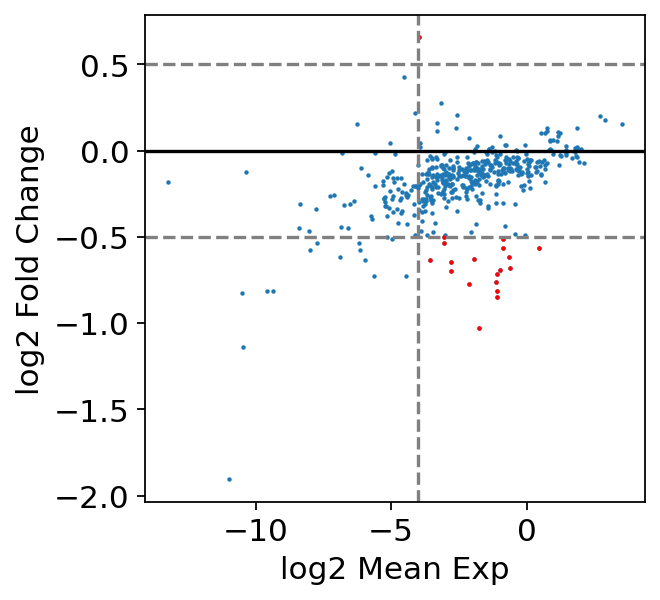

6
(37898, 483)
(37898, 483)
upRegulated gene: 6
downRegulated gene: 13


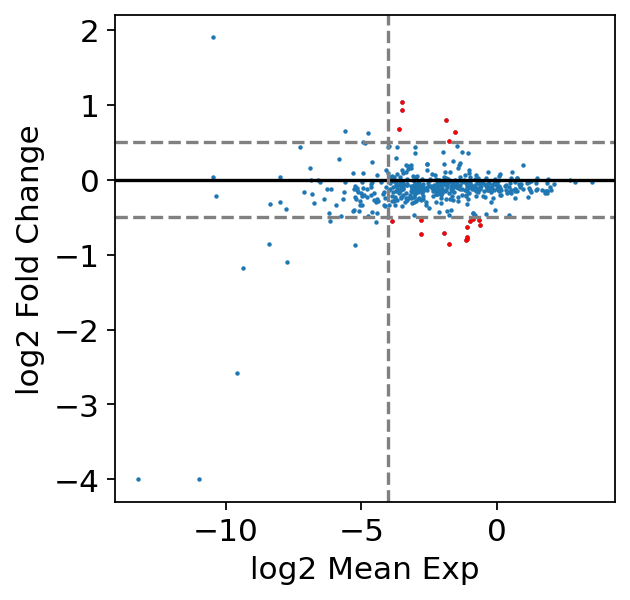

7
(37898, 483)
(37898, 483)
upRegulated gene: 15
downRegulated gene: 5


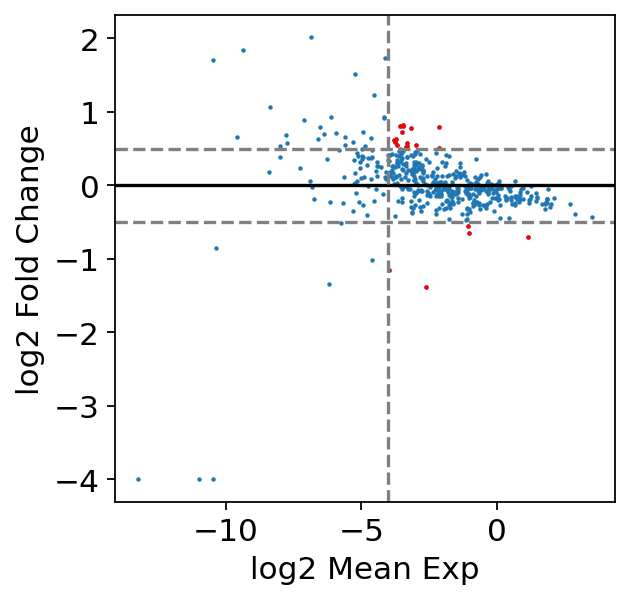

8
(37898, 483)
(37898, 483)
upRegulated gene: 29
downRegulated gene: 3


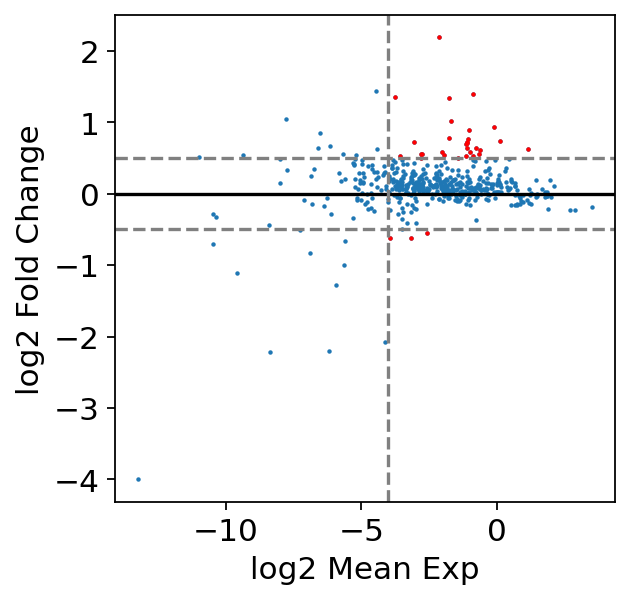

9
(37898, 483)
(37898, 483)
upRegulated gene: 7
downRegulated gene: 1


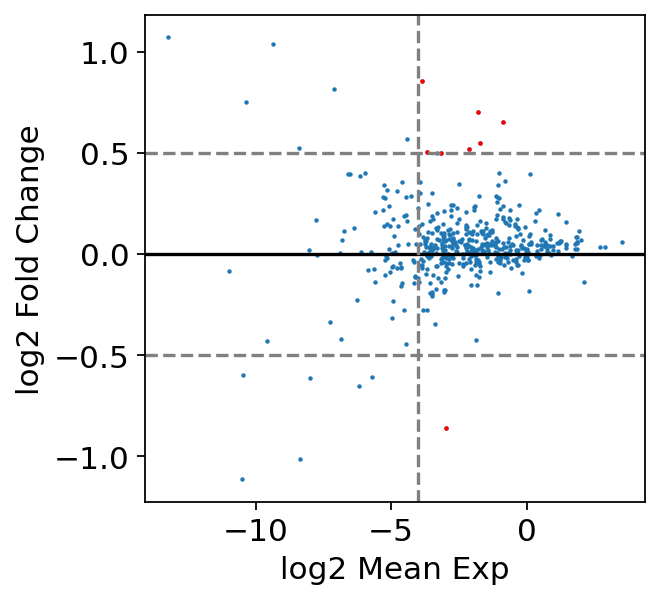

10
(37898, 483)
(37898, 483)
upRegulated gene: 37
downRegulated gene: 42


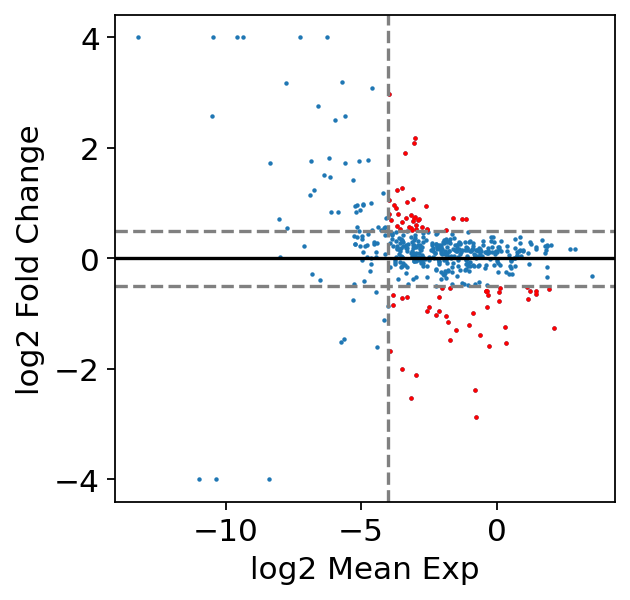

In [122]:
cat = BMDB.obs['leiden_v1'].cat.categories
print(cat)
BMDB.raw= BMDB
for x in range(len(cat)):
    print(x)
    upG, downG, tableG = smqpp.plot_ma(BMDB, 'DE_leiden_v1',cidx=int(x), padj_cutoff=0.05, logFC_cutoff=0.5, exp_cutoff=-4)
    np.savetxt('Pathway/Tcells_leiden_v1_BMDB/'+cat[x]+'vsAll_upG.txt', upG, delimiter='\t', fmt='%s')
    np.savetxt('Pathway/Tcells_leiden_v1_BMDB/'+cat[x]+'vsAll_downG.txt', downG, delimiter='\t', fmt='%s')
    tableG.to_csv('Pathway/Tcells_leiden_v1_BMDB/'+cat[x]+'vsAll_table.csv')

In [185]:
import os
import re
GL2plot = {}
files = np.array(os.listdir('./Pathway/Tcells_leiden_v1_BMDB/'))
files = files[['upG' in x for x in files]]
print(files)
for f in files:
    cl = re.search('L2_\d+' , f)[0]
    GL2plot[cl] = np.genfromtxt('./Pathway/Tcells_leiden_v1_BMDB/'+f, dtype=str, delimiter='\t')

['L2_5vsAll_upG.txt' 'L2_2vsAll_upG.txt' 'L2_3vsAll_upG.txt'
 'L2_9vsAll_upG.txt' 'L2_8vsAll_upG.txt' 'L2_11vsAll_upG.txt'
 'L2_4vsAll_upG.txt' 'L2_6vsAll_upG.txt' 'L2_10vsAll_upG.txt'
 'L2_7vsAll_upG.txt' 'L2_1vsAll_upG.txt']


/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: genfromtxt: Empty input file: "./Pathway/Tcells_leiden_v1_BMDB/L2_5vsAll_upG.txt"
  if __name__ == '__main__':
/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: genfromtxt: Empty input file: "./Pathway/Tcells_leiden_v1_BMDB/L2_3vsAll_upG.txt"
  if __name__ == '__main__':


In [195]:
from collections import OrderedDict
ordered = OrderedDict()
for k in BMDB.obs['leiden_v1'].cat.categories:
    if type(GL2plot[k].tolist()) == list:
        ordered[k] = GL2plot[k][0:5]
    else:
        ordered[k] =GL2plot[k].tolist()

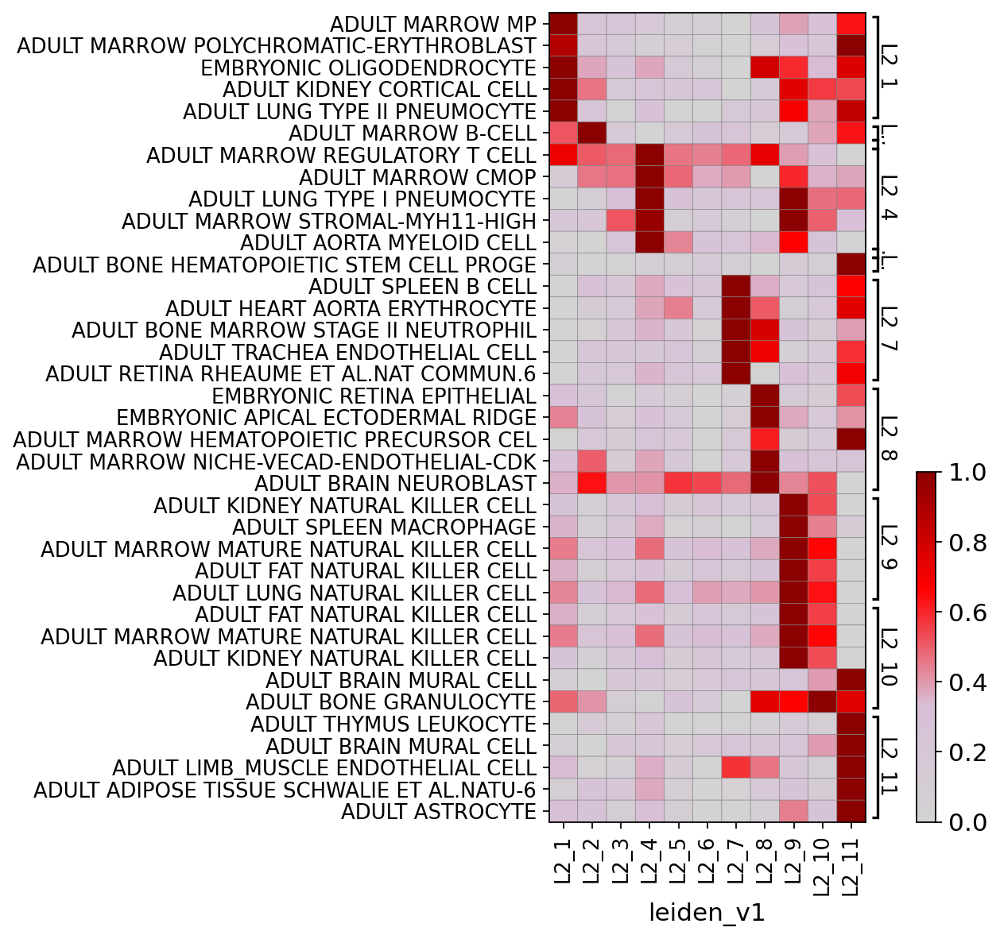

GridSpec(2, 3, height_ratios=[0, 7.4], width_ratios=[3.3, 0.4, 0.2])

In [197]:
sc.pl.matrixplot(BMDB, var_names=ordered, groupby='leiden_v1', standard_scale='var', cmap=cmap, swap_axes=True)

In [198]:
BMDB.write('./write/Tcells_BMDB.h5ad')

# plots

In [5]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

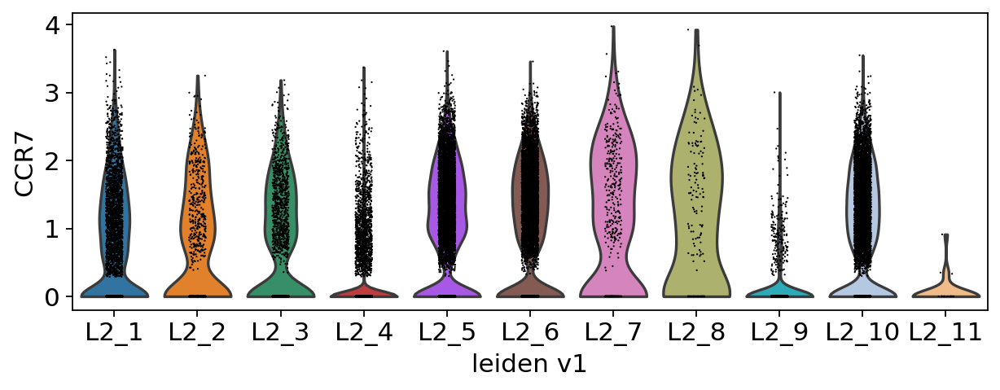

In [32]:
fig, ax = plt.subplots(figsize=(9,3))
ax = sc.pl.violin(adata, keys='CCR7', groupby='leiden_v1', show=False, ax=ax)
ax.grid(False)
plt.savefig('./figures/Violin_Tcells_leiden_v1_CCR7.pdf')

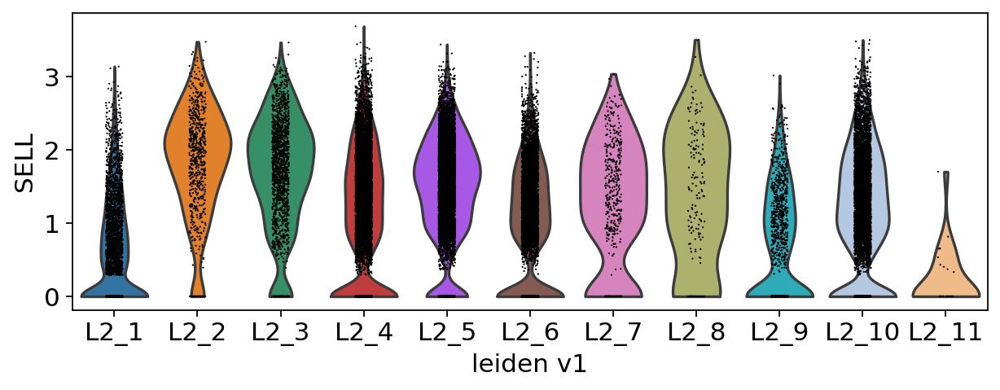

In [33]:
fig, ax = plt.subplots(figsize=(9,3))
ax = sc.pl.violin(adata, keys='SELL', groupby='leiden_v1', show=False, ax=ax)
ax.grid(False)
plt.savefig('./figures/Violin_Tcells_leiden_v1_SELL.pdf')

In [34]:
GL1 = {'CD4 naive/CM rest': ['TCF7', 'ID3', 'CCR7', 'AQP3', 'SELL'],
      'CD4 act1/2': ['IL4R', 'STAT1', 'MAL', 'SOCS1'],
      'CD4 act3': ['IL2', 'ODC1', 'PSAT1', 'WARS', 'PYCR1', 'TNF', 'MIR155HG', 'NME1'],
      'CD4 TRM': ['IFI6', 'LGALS3', 'MAF', 'TNFRSF18'],
      'CD4 Treg': ['FOXP3', 'IL2RA', 'CTLA4', 'TIGIT', 'PMCH', 'TNFRSF4'],
      'CD8 EM/TRM rest': ['KLRB1', 'AMICA1'],
      'CD8 TRM rest': ['PDZD8', 'CXCR6', 'RCAN2', 'PRF1', 'ANXA2', 'CRIP1', 'ITGA1', 'GZMB'],
      'CD8 TRM act': ['IFNG', 'HOPX', 'CCL4', 'CCL3'],
      'CD8 TEMRA': ['NKG7', 'GZMK', 'GNLY', 'IFIT3', 'KLRD1', 'MYO1F', 'CCL5']}

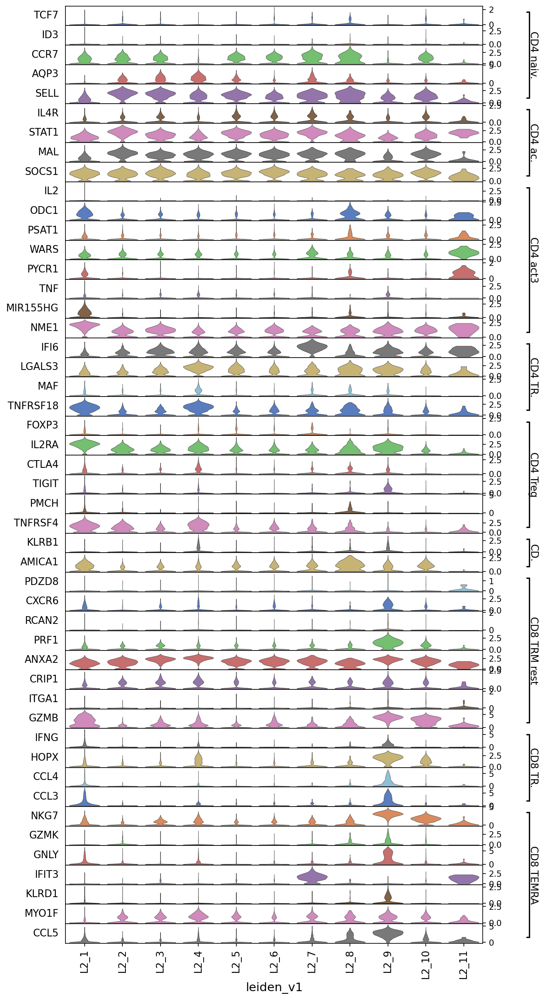

In [35]:
ax = sc.pl.stacked_violin(adata, var_names=GL1, groupby='leiden_v1', swap_axes=True, figsize=(10,20))

In [35]:
# df = adata.obs[['Donor', 'Sub_con', 'leiden_v1']]
# df = df.groupby(['leiden_v1', 'Donor','Sub_con'])['Sub_con'].count().unstack().rename(columns=str).reset_index().melt(id_vars=['leiden_v1', 'Donor'])
# df = df.assign(percentage=df.value*100/df.groupby(['Donor', 'Sub_con']).value.transform('sum'))
# df['Sub_con'] = df['Sub_con'].astype('category')
# df['Sub_con'] = df['Sub_con'].cat.reorder_categories(['Unstimulated Vec-', 'Stimulated Vec-', 'Unstimulated Vec+', 'Stimulated Vec+'])
# mean_all = df.groupby(['leiden_v1', 'Sub_con'])['percentage'].mean().unstack()
# std_all = df.groupby(['leiden_v1', 'Sub_con'])['percentage'].std().unstack()
# values = df.groupby(['leiden_v1', 'Sub_con'])['value'].sum().unstack()

# #import seaborn as sns
# N = mean_all.shape[0]
# ind = np.array([0,1,2,3,4,5, 6,7,8,9,10])
# width = 0.2
# fig, ax = plt.subplots(figsize=(10,5))
# ax1 = ax.bar(ind-width*1.5, mean_all['Unstimulated Vec-'], width-0.05, color='red', label='Unstimulated Vec-')
# plotline1, caplines1, barlinecols1 = ax.errorbar(ind-width*1.5, mean_all['Unstimulated Vec-'], yerr=std_all['Unstimulated Vec-'], lolims=True,
#         capsize = 0, ls='None', color='black')
# caplines1[0].set_marker('_')
# caplines1[0].set_markersize(5)
# ax2 = ax.bar(ind-width*0.5, mean_all['Stimulated Vec-'], width-0.05, color='blue', label='Stimulated Vec-')
# plotline2, caplines2, barlinecols2 = ax.errorbar(ind-width*0.5, mean_all['Stimulated Vec-'], yerr=std_all['Stimulated Vec-'], lolims=True,
#         capsize = 0, ls='None', color='black')
# caplines2[0].set_marker('_')
# caplines2[0].set_markersize(5)
# ax3 = ax.bar(ind+width*0.5, mean_all['Unstimulated Vec+'], width-0.05, color='green', label='Unstimulated Vec+')
# plotline3, caplines3, barlinecols3 = ax.errorbar(ind+width*0.5, mean_all['Unstimulated Vec+'], yerr=std_all['Unstimulated Vec+'], lolims=True,
#         capsize = 0, ls='None', color='black')
# caplines3[0].set_marker('_')
# caplines3[0].set_markersize(5)
# ax4 = ax.bar(ind+width*1.5, mean_all['Stimulated Vec+'], width-0.05, color='purple', label='Stimulated Vec+')
# plotline4, caplines4, barlinecols4 = ax.errorbar(ind+width*1.5, mean_all['Stimulated Vec+'], yerr=std_all['Stimulated Vec+'], lolims=True,
#         capsize = 0, ls='None', color='black')
# caplines4[0].set_marker('_')
# caplines4[0].set_markersize(5)

# props = {'connectionstyle':'bar','arrowstyle':'-',\
#                  'shrinkA':40,'shrinkB':40,'linewidth':1.5}

# # calculate stats
# from itertools import combinations
# from scipy import stats
# cl_unique = np.unique(df['leiden_v1'])
# t_unique = np.unique(df['Sub_con'])
# ncomb = list(combinations(t_unique, 2))
# pval = {}
# def posloc(idx, pos, width):
#     if idx == 0:
#         return pos-width*1.5
#     elif idx == 1:
#         return pos-width*0.5
#     elif idx == 2:
#         return pos+width*0.5
#     elif idx == 3:
#         return pos+width*1.5
# for cl in cl_unique:
#     for i in ncomb:
#         idx1 = (df['leiden_v1'] == cl) & (df['Sub_con'] == i[0])
#         idx2 = (df['leiden_v1'] == cl) & (df['Sub_con'] == i[1])
#         stat, p =stats.mannwhitneyu(df.loc[idx1, 'percentage'],df.loc[idx2, 'percentage'] )
#         pval[cl+'_'+i[0]+'vs'+i[1]] = p
#         if p < 0.05:
#             Iidx = list(mean_all.index).index(cl)
#             maxpos = np.max(mean_all.loc[cl, [i[0], i[1]]]+std_all.loc[cl, [i[0], i[1]]])
#             i1pos = list(mean_all.columns).index(i[0])
#             i2pos = list(mean_all.columns).index(i[1])
#             i1loc = posloc(i1pos, Iidx, width)
#             i2loc = posloc(i2pos, Iidx, width)
#             v1 = np.min([i1loc, i2loc])
#             v2 = np.max([i1loc,i2loc])
#             ax.annotate('', xy=(v1,maxpos+3), xytext=(v2,maxpos+3), arrowprops=props)
#             ax.annotate('*', xy=[(v1+v2)/2-0.08, maxpos+5], c='red')
#             print(cl+'_'+i[0]+'vs'+i[1]+ ': '+str(p))


# ax.grid(False)
# ax.xaxis.set_tick_params(rotation=90)
# ax.set_xticks(ind)
# ax.set_ylim([0,70])
# ax.set_xticklabels(mean_all.index)
# ax.set_ylabel('% of T cells in each condition')
# ax.legend()
# plt.tight_layout()
# plt.savefig('./figures/barplot_Tcells_leidenv1_Con.pdf')

In [25]:
df = adata.obs[['Donor', 'Sub_con', 'leiden_v1']]
df = df.groupby(['leiden_v1', 'Donor','Sub_con'])['Sub_con'].count().unstack().rename(columns=str).reset_index().melt(id_vars=['leiden_v1', 'Donor'])
df = df.assign(percentage=df.value*100/df.groupby(['Donor', 'Sub_con']).value.transform('sum'))
df['Sub_con'] = df['Sub_con'].astype('category')
print(df['Sub_con'].cat.categories)
df['Sub_con'] = df['Sub_con'].cat.reorder_categories(['Unsti Vec-', 'Unsti Vec+', 'Sti Vec-', 'Sti Vec+'])
mean_all = df.groupby(['leiden_v1', 'Sub_con'])['percentage'].mean().unstack()
std_all = df.groupby(['leiden_v1', 'Sub_con'])['percentage'].std().unstack()
values = df.groupby(['leiden_v1', 'Sub_con'])['value'].sum().unstack()

Index(['Sti Vec+', 'Sti Vec-', 'Unsti Vec+', 'Unsti Vec-'], dtype='object')


In [27]:
FN = 'barplot_Tcells_leidenv1_Con_new'
df.to_csv('./table/'+FN+'.csv')

L2_1_Sti Vec+vsSti Vec-: 0.04042779918502612
L2_1_Sti Vec+vsUnsti Vec+: 0.04042779918502612
L2_1_Sti Vec+vsUnsti Vec-: 0.04042779918502612
L2_1_Sti Vec-vsUnsti Vec-: 0.04042779918502612
L2_1_Unsti Vec+vsUnsti Vec-: 0.04042779918502612
L2_10_Sti Vec+vsSti Vec-: 0.04042779918502612
L2_10_Sti Vec+vsUnsti Vec+: 0.04042779918502612
L2_10_Sti Vec+vsUnsti Vec-: 0.04042779918502612
L2_2_Sti Vec-vsUnsti Vec+: 0.04042779918502612
L2_2_Unsti Vec+vsUnsti Vec-: 0.04042779918502612
L2_5_Sti Vec+vsUnsti Vec+: 0.04042779918502612
L2_5_Sti Vec+vsUnsti Vec-: 0.04042779918502612
L2_5_Sti Vec-vsUnsti Vec+: 0.04042779918502612
L2_5_Sti Vec-vsUnsti Vec-: 0.04042779918502612
L2_6_Sti Vec+vsUnsti Vec+: 0.04042779918502612
L2_6_Sti Vec-vsUnsti Vec+: 0.04042779918502612
L2_6_Sti Vec-vsUnsti Vec-: 0.04042779918502612
L2_7_Sti Vec+vsUnsti Vec-: 0.04042779918502612
L2_8_Sti Vec+vsUnsti Vec+: 0.04042779918502612
L2_8_Sti Vec-vsUnsti Vec+: 0.04042779918502612


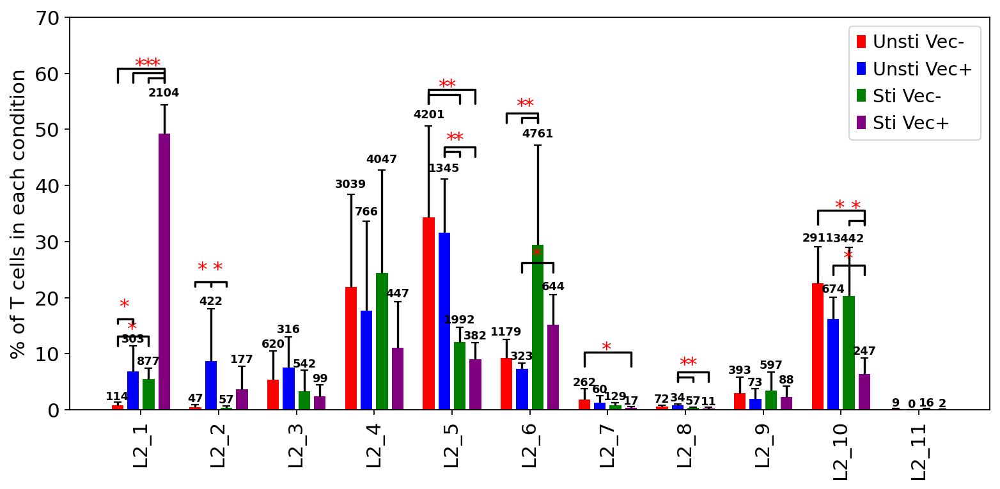

In [13]:
#import seaborn as sns
N = mean_all.shape[0]
ind = np.array([0,1,2,3,4,5, 6,7,8,9,10])
width = 0.2
fig, ax = plt.subplots(figsize=(10,5))
ax1 = ax.bar(ind-width*1.5, mean_all['Unsti Vec-'], width-0.05, color='red', label='Unsti Vec-')
plotline1, caplines1, barlinecols1 = ax.errorbar(ind-width*1.5, mean_all['Unsti Vec-'], yerr=std_all['Unsti Vec-'], lolims=True,
        capsize = 0, ls='None', color='black')
caplines1[0].set_marker('_')
caplines1[0].set_markersize(5)
ax2 = ax.bar(ind-width*0.5, mean_all['Unsti Vec+'], width-0.05, color='blue', label='Unsti Vec+')
plotline2, caplines2, barlinecols2 = ax.errorbar(ind-width*0.5, mean_all['Unsti Vec+'], yerr=std_all['Unsti Vec+'], lolims=True,
        capsize = 0, ls='None', color='black')
caplines2[0].set_marker('_')
caplines2[0].set_markersize(5)
ax3 = ax.bar(ind+width*0.5, mean_all['Sti Vec-'], width-0.05, color='green', label='Sti Vec-')
plotline3, caplines3, barlinecols3 = ax.errorbar(ind+width*0.5, mean_all['Sti Vec-'], yerr=std_all['Sti Vec-'], lolims=True,
        capsize = 0, ls='None', color='black')
caplines3[0].set_marker('_')
caplines3[0].set_markersize(5)
ax4 = ax.bar(ind+width*1.5, mean_all['Sti Vec+'], width-0.05, color='purple', label='Sti Vec+')
plotline4, caplines4, barlinecols4 = ax.errorbar(ind+width*1.5, mean_all['Sti Vec+'], yerr=std_all['Sti Vec+'], lolims=True,
        capsize = 0, ls='None', color='black')
caplines4[0].set_marker('_')
caplines4[0].set_markersize(5)

props = {'connectionstyle':'bar','arrowstyle':'-',\
                 'shrinkA':40,'shrinkB':40,'linewidth':1.5}

# calculate stats
from itertools import combinations
from scipy import stats
cl_unique = np.unique(df['leiden_v1'])
t_unique = np.unique(df['Sub_con'])
ncomb = list(combinations(t_unique, 2))
pval = {}
def posloc(idx, pos, width):
    if idx == 0:
        return pos-width*1.5
    elif idx == 1:
        return pos-width*0.5
    elif idx == 2:
        return pos+width*0.5
    elif idx == 3:
        return pos+width*1.5
for cl in cl_unique:
    for i in ncomb:
        idx1 = (df['leiden_v1'] == cl) & (df['Sub_con'] == i[0])
        idx2 = (df['leiden_v1'] == cl) & (df['Sub_con'] == i[1])
        stat, p =stats.mannwhitneyu(df.loc[idx1, 'percentage'],df.loc[idx2, 'percentage'] )
        pval[cl+'_'+i[0]+'vs'+i[1]] = p
        if p < 0.05:
            Iidx = list(mean_all.index).index(cl)
            maxpos = np.max(mean_all.loc[cl, [i[0], i[1]]]+std_all.loc[cl, [i[0], i[1]]])
            i1pos = list(mean_all.columns).index(i[0])
            i2pos = list(mean_all.columns).index(i[1])
            i1loc = posloc(i1pos, Iidx, width)
            i2loc = posloc(i2pos, Iidx, width)
            v1 = np.min([i1loc, i2loc])
            v2 = np.max([i1loc,i2loc])
            ax.annotate('', xy=(v1,maxpos+4), xytext=(v2,maxpos+4), arrowprops=props)
            ax.annotate('*', xy=[(v1+v2)/2-0.08, maxpos+6], c='red')
            print(cl+'_'+i[0]+'vs'+i[1]+ ': '+str(p))

autolabel(ax1, barlinecols1, values['Unsti Vec-'])
autolabel(ax2, barlinecols2, values['Unsti Vec+'])
autolabel(ax3, barlinecols3, values['Sti Vec-'])
autolabel(ax4, barlinecols4, values['Sti Vec+'])
            
ax.grid(False)
ax.xaxis.set_tick_params(rotation=90)
ax.set_xticks(ind)
ax.set_ylim([0,70])
ax.set_xticklabels(mean_all.index)
ax.set_ylabel('% of T cells in each condition')
ax.legend()
plt.tight_layout()
plt.savefig('./figures/'+FN+'.pdf')

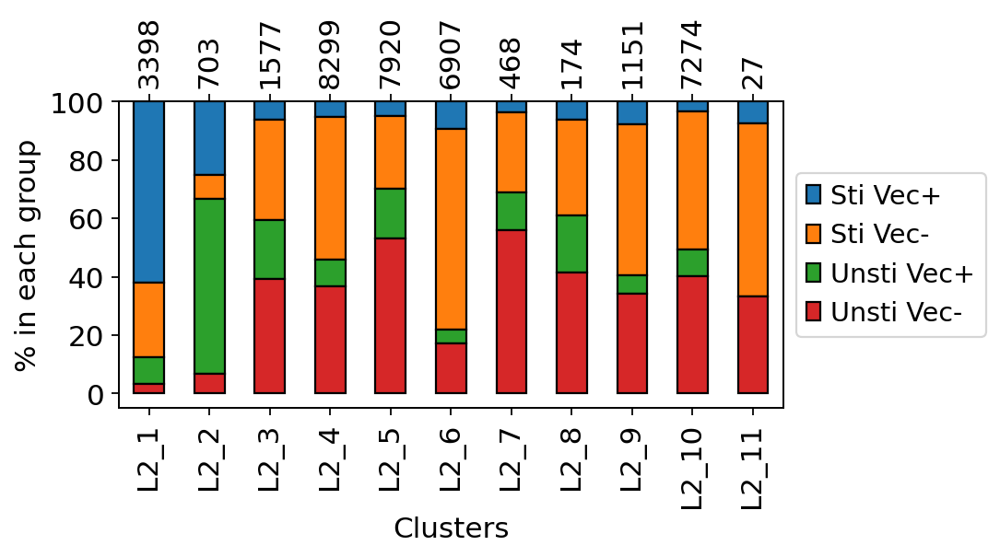

In [15]:
FN = 'Tcells_leidenv1_subcon'
df = lv_stat_barplot(adata, hatch=False, xlab="Clusters", splitby="leiden_v1", colorby="Sub_con", figsize=(7,4), save=FN+'.pdf')
df.to_csv('./table/'+FN+'.csv')

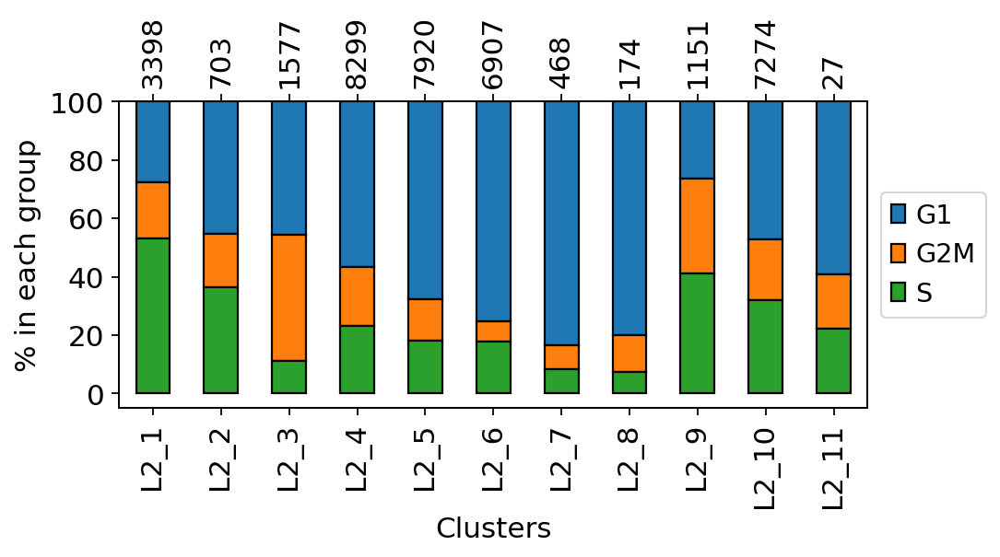

In [16]:
FN = 'Tcells_leidenv1_phase'
df = lv_stat_barplot(adata, hatch=False, xlab="Clusters", splitby="leiden_v1", colorby="phase", figsize=(7,4), save=FN+'.pdf')
df.to_csv('./table/'+FN+'.csv')

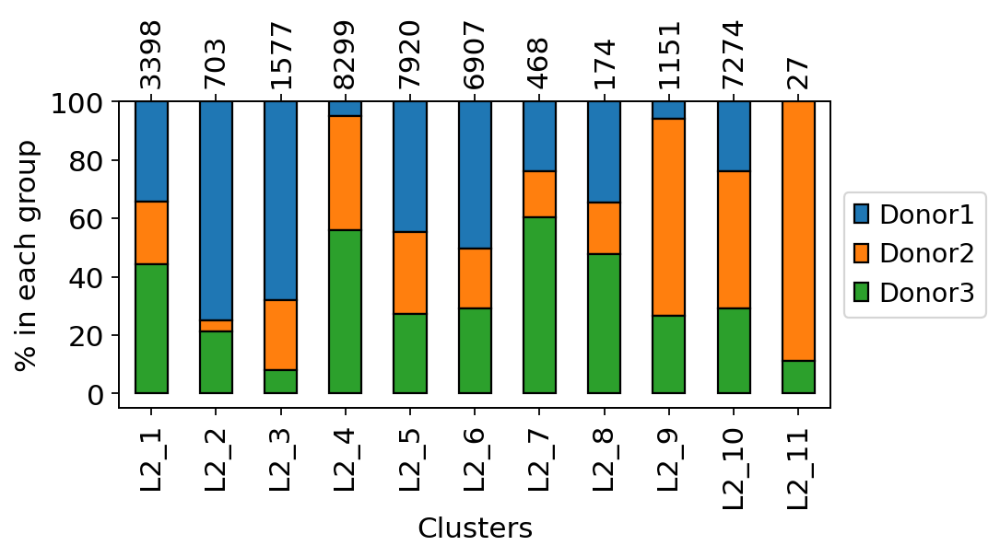

In [17]:
FN = 'Tcells_leidenv1_donor'
df = lv_stat_barplot(adata, hatch=False, xlab="Clusters", splitby="leiden_v1", colorby="Donor", figsize=(7,4), save=FN+'.pdf')
df.to_csv('./table/'+FN+'.csv')

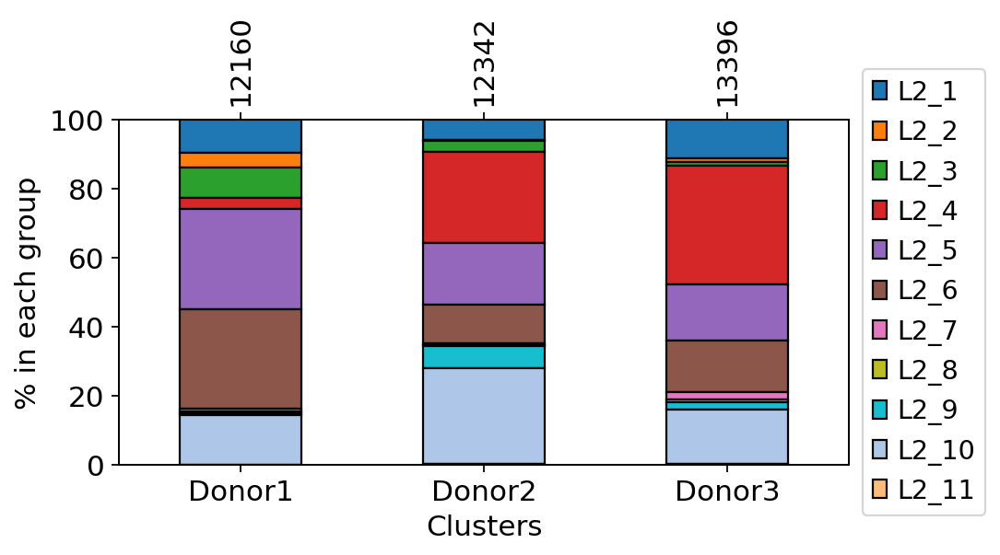

In [19]:
FN = 'Tcells_leidenv1_donor_swap'
df = lv_stat_barplot(adata, hatch=False, xlab="Clusters", splitby="Donor", colorby="leiden_v1", figsize=(7,4), save=FN+'.pdf')
df.to_csv('./table/'+FN+'.csv')

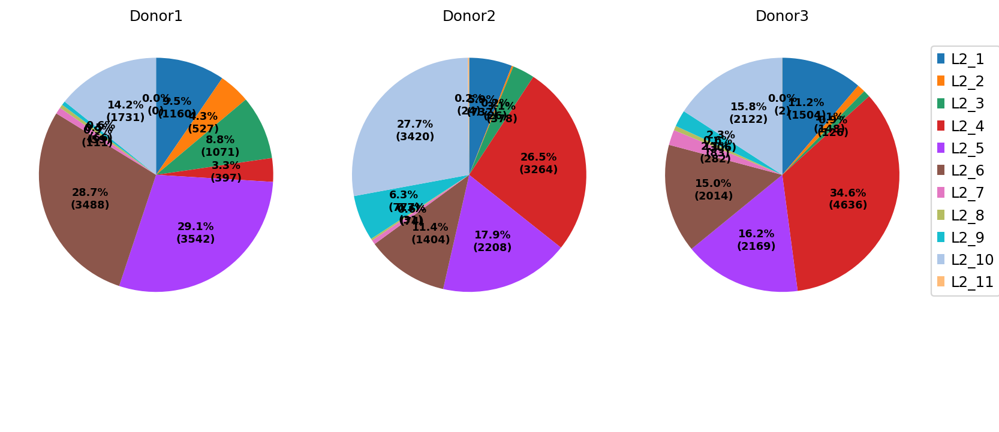

In [21]:
FN = 'Tcells_leidenv1_donor_pie'
df = lv_stat_barplot(adata, fontsize=11, splitby="Donor", colorby="leiden_v1", plotMethod="PieChart",  save=FN+'.pdf', figsize=(10,8), bbox_to_anchor=(1.05,0.34))
df.to_csv('./table/'+FN+'.csv')

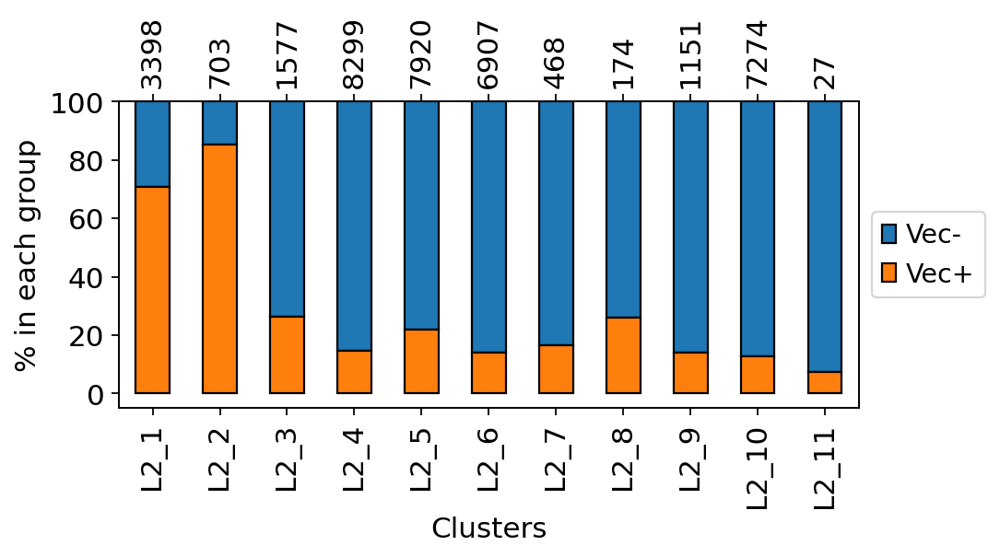

In [22]:
FN = 'Tcells_leidenv1_vec'
df = lv_stat_barplot(adata, hatch=False, xlab="Clusters", splitby="leiden_v1", colorby="Vec_binary", figsize=(7,4), save=FN+'.pdf')
df.to_csv('./table/'+FN+'.csv')

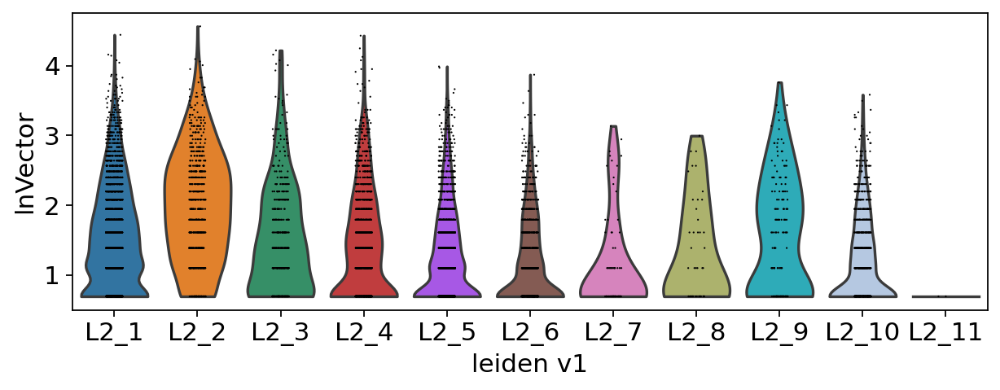

In [7]:
fig, ax = plt.subplots(figsize=(9,3))
ax = sc.pl.violin(adata[adata.obs['Vec_binary'] == 'Vec+'], keys='logVector', groupby='leiden_v1', show=False, ax=ax)
ax.grid(False)
ax.set_ylabel('lnVector')
plt.savefig('./figures/Violin_Tcells_leiden_v1_logVec.pdf')

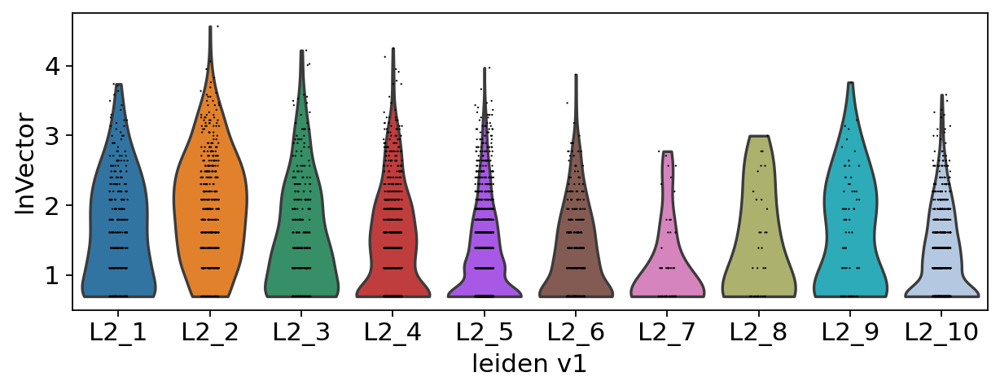

In [8]:
fig, ax = plt.subplots(figsize=(9,3))
ax = sc.pl.violin(adata[(adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Unstimulated')], keys='logVector', groupby='leiden_v1', show=False, ax=ax)
ax.grid(False)
ax.set_ylabel('lnVector')
plt.savefig('./figures/Violin_Tcells_leiden_v1_logVec+_Unsti.pdf')

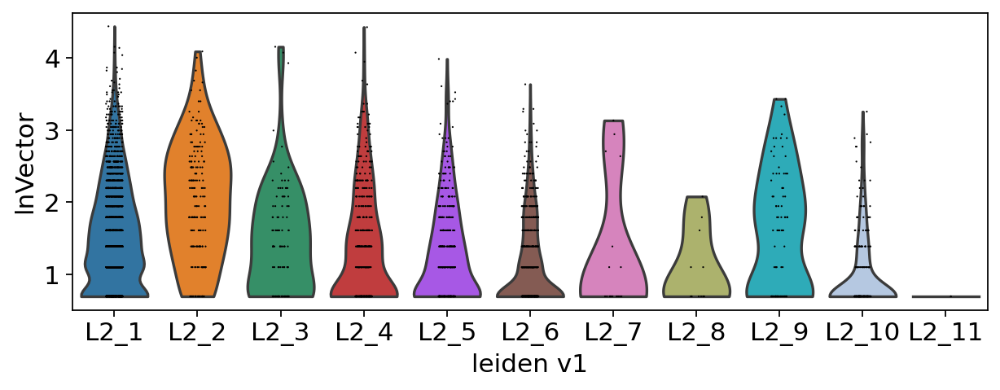

In [9]:
fig, ax = plt.subplots(figsize=(9,3))
ax = sc.pl.violin(adata[(adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Stimulated')], keys='logVector', groupby='leiden_v1', show=False, ax=ax)
ax.grid(False)
ax.set_ylabel('lnVector')
plt.savefig('./figures/Violin_Tcells_leiden_v1_logVec+_Sti.pdf')

In [78]:
adata[adata.obs['leiden_v1'] == 'L2_1'].obs['ExCells'].sort_index().value_counts()

Non-Ex    1593
Middle    1542
Ex         263
Name: ExCells, dtype: int64

In [79]:
adata[(adata.obs['leiden_v1'] == 'L2_1') & (adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Stimulated')].obs['ExCells'].sort_index().value_counts()

Non-Ex    1001
Middle     950
Ex         153
Name: ExCells, dtype: int64

Trying to set attribute `.obs` of view, copying.
... storing 'comb_con1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'ExCells1' as categorical


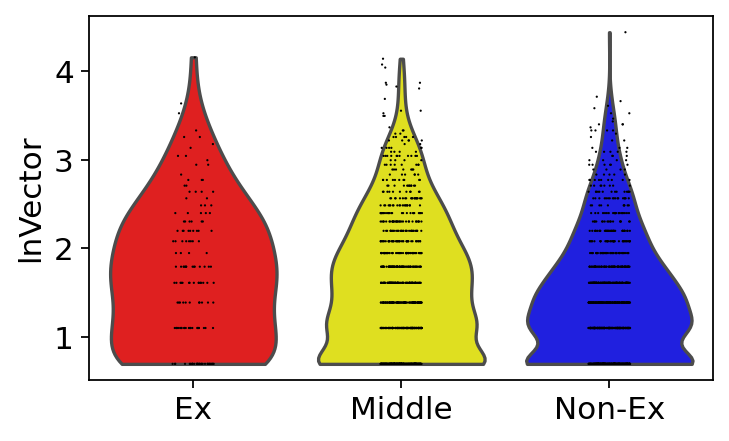

In [75]:
fig, ax = plt.subplots(figsize=(5,3))
ax = sc.pl.violin(adata[(adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Stimulated') & (adata.obs['leiden_v1'] == 'L2_1')], keys='logVector', groupby='ExCells', show=False, ax=ax)
ax.grid(False)
ax.set_ylabel('lnVector')
ax.set_xlabel('')
plt.savefig('./figures/Violin_Tcells_ExCells_logVec+_Sti_L2_1.pdf')

In [66]:
adata.obs['ExCells1'] = ['Non-Ex' if 'Middle' in x else x for x in adata.obs['ExCells']]

Trying to set attribute `.obs` of view, copying.
... storing 'comb_con1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'ExCells1' as categorical


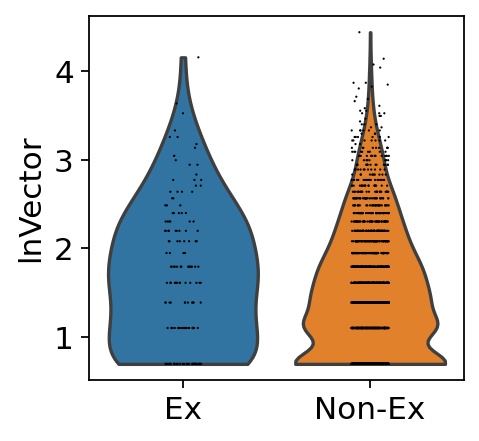

In [76]:
fig, ax = plt.subplots(figsize=(3,3))
ax = sc.pl.violin(adata[(adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Stimulated') & (adata.obs['leiden_v1'] == 'L2_1')], keys='logVector', groupby='ExCells1', show=False, ax=ax)
ax.grid(False)
ax.set_xlabel('')
ax.set_ylabel('lnVector')
plt.savefig('./figures/Violin_Tcells_ExCells_logVec+_Sti_L2_1_new.pdf')

In [ ]:
fig, ax = plt.subplots(figsize=(9,3))
ax = sc.pl.violin(adata[(adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Stimulated') & (adata.obs['leiden_v1'] == 'L2_1')], keys='logVector', groupby='ExCells', show=False, ax=ax)
ax.grid(False)
plt.savefig('./figures/Violin_Tcells_ExCells_logVec+_Sti_L2_1.pdf')

In [84]:
df = adata[(adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Stimulated') & (adata.obs['leiden_v1'] == 'L2_1') & (adata.obs['ExCells'] == 'Ex')].obs['Donor'].value_counts().sort_index()
df

Donor1    37
Donor2    23
Donor3    93
Name: Donor, dtype: int64

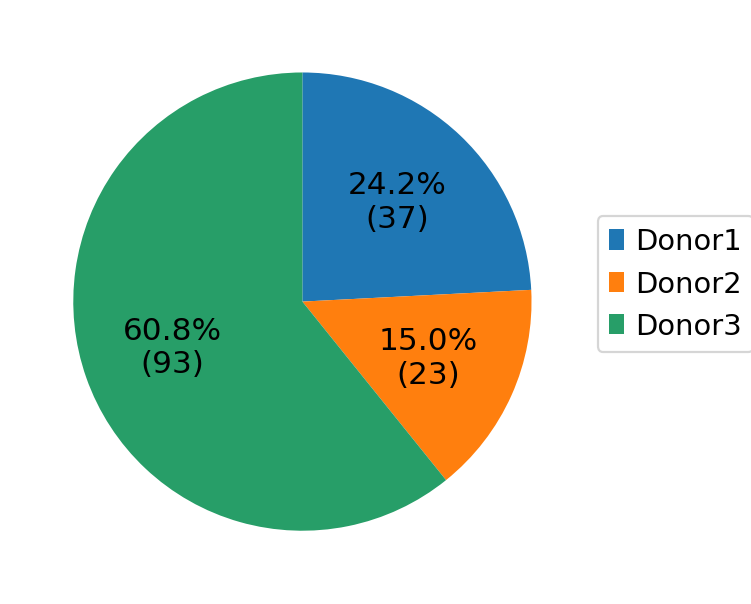

In [101]:
fig, ax = plt.subplots()
patches, texts, autotexts =ax.pie(df.values,startangle = 90, counterclock=False, autopct = lambda pct: func(pct, df.values)) 
plt.figlegend(patches, df.index, bbox_to_anchor=(1.2,0.5),  loc='right', fontsize=13)
plt.tight_layout()
plt.savefig('./figures/Tcells_Pie_donors_StiVecPL2_1_Ex.pdf')

In [107]:
adata.obs['Sub_con'] = adata.obs['Sub_con'].cat.rename_categories(['Sti Vec+', 'Sti Vec-', 'Unsti Vec+', 'Unsti Vec-'])

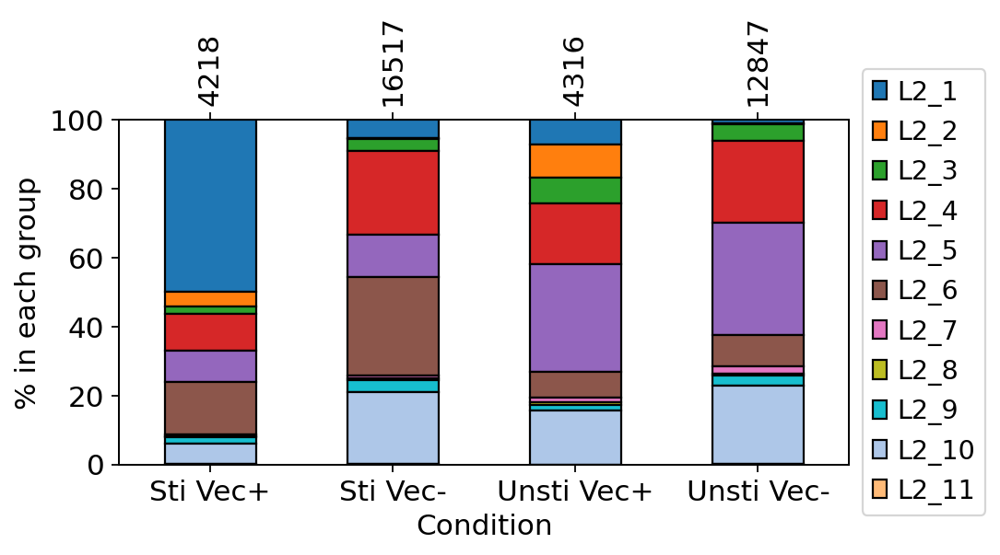

In [23]:
FN = 'Tcells_leidenv1_subcon_swap'
lv_stat_barplot(adata, hatch=False, xlab="Condition", splitby="Sub_con", colorby="leiden_v1", figsize=(7,4), save=FN+'.pdf')
df.to_csv('./table/'+FN+'.csv')

In [5]:
adata[(adata.obs['Vec_binary'] == 'Vec+') & (adata.obs['Condition'] == 'Stimulated') & (adata.obs['leiden_v1'] == 'L2_1')].obs['ExCells'].value_counts()

Non-Ex    1001
Middle     950
Ex         153
Name: ExCells, dtype: int64

# Quickly compare with previous clusters

In [2]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [3]:
adata_old = sc.read('../New_analysis_08Fen2020/write_new/Tcells_corrected.h5ad')
adata_old.obs['batch'] = [x[:2] for x in adata_old.obs_names]
adata_old.obs['batch'] = adata_old.obs['batch'].astype('category')
adata_old.obs['batch'] = adata_old.obs['batch'].cat.rename_categories([0, 1, 2, 3, 4, 5])
adata_old.obs['newID'] = [adata_old.obs_names[x][3:]+'-'+adata_old.obs['batch'][x].astype(str) for x in range(adata_old.shape[0])]
adata_old.obs['oldID'] = adata_old.obs_names
adata_old.obs_names = adata_old.obs['newID']

In [55]:
pdnew = pd.concat([adata.obs, adata_old.obs], axis=1)
pdnew = pdnew.loc[adata.obs_names,:]

In [57]:
adata.obs['old_cl'] = pdnew['Louvain_Clusters']

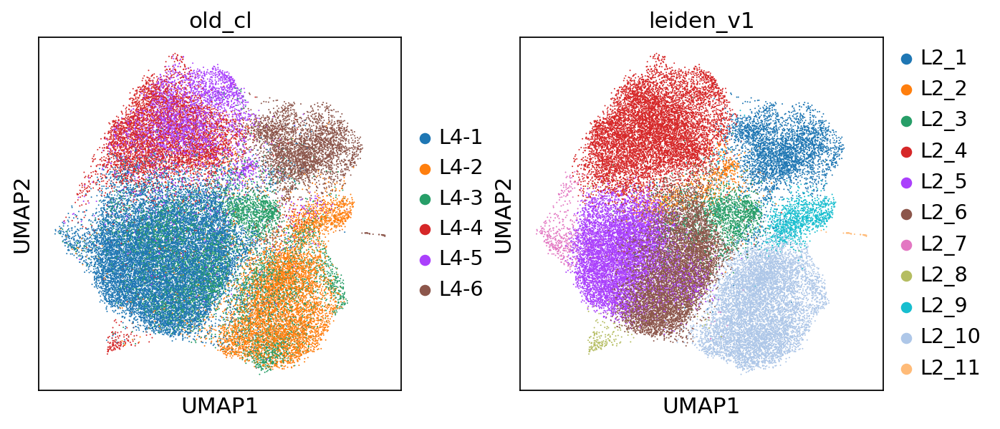

In [60]:
sc.pl.umap(adata, color=['old_cl', 'leiden_v1'])

# Tables

In [2]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [6]:
table1 = pd.crosstab(adata.obs['Sub_con'], adata.obs['leiden_v1'])
display(table1)
table1.to_csv('Table_Tcells_Sub_con_leiden_v1.csv')

leiden_v1,L2_1,L2_2,L2_3,L2_4,L2_5,L2_6,L2_7,L2_8,L2_9,L2_10,L2_11
Sub_con,,,,,,,,,,,
Stimulated Vec+,2104,177,99,447,382,644,17,11,88,247,2
Stimulated Vec-,877,57,542,4047,1992,4761,129,57,597,3442,16
Unstimulated Vec+,303,422,316,766,1345,323,60,34,73,674,0
Unstimulated Vec-,114,47,620,3039,4201,1179,262,72,393,2911,9


In [7]:
table2 = pd.crosstab(adata.obs['Donor'], adata.obs['leiden_v1'])
display(table2)
table2.to_csv('Table_Tcells_Donor_leiden_v1.csv')

leiden_v1,L2_1,L2_2,L2_3,L2_4,L2_5,L2_6,L2_7,L2_8,L2_9,L2_10,L2_11
Donor,,,,,,,,,,,
Donor1,1161,527,1072,397,3543,3489,112,60,67,1732,0
Donor2,733,27,378,3265,2208,1404,74,31,778,3420,24
Donor3,1504,149,127,4637,2169,2014,282,83,306,2122,3


In [113]:
adata.obs['Sub_con2'] = adata.obs['Condition'].astype(str)+'_'+adata.obs['Vec_binary'].astype(str)+'_'+adata.obs['Donor'].astype(str)

In [116]:
table3 = pd.crosstab(adata.obs['leiden_v1'], adata.obs['Sub_con2'])
display(table3)
table3.to_csv('Table_Tcells_leiden_v1_Subcon2.csv')

Sub_con2,Stimulated_Vec+_Donor1,Stimulated_Vec+_Donor2,Stimulated_Vec+_Donor3,Stimulated_Vec-_Donor1,Stimulated_Vec-_Donor2,Stimulated_Vec-_Donor3,Unstimulated_Vec+_Donor1,Unstimulated_Vec+_Donor2,Unstimulated_Vec+_Donor3,Unstimulated_Vec-_Donor1,Unstimulated_Vec-_Donor2,Unstimulated_Vec-_Donor3
leiden_v1,,,,,,,,,,,,
L2_1,768,435,901,336,190,351,47,61,195,10,47,57
L2_2,134,4,39,40,9,8,317,12,93,36,2,9
L2_3,70,25,4,404,101,37,201,90,25,397,162,61
L2_4,28,133,286,203,1847,1997,32,173,561,134,1112,1793
L2_5,194,87,101,805,638,549,653,344,348,1891,1139,1171
L2_6,338,140,166,2636,970,1155,117,65,141,398,229,552
L2_7,9,2,6,70,27,32,7,8,45,26,37,199
L2_8,7,0,4,24,13,20,10,6,18,19,12,41
L2_9,5,38,45,34,435,128,5,39,29,23,266,104


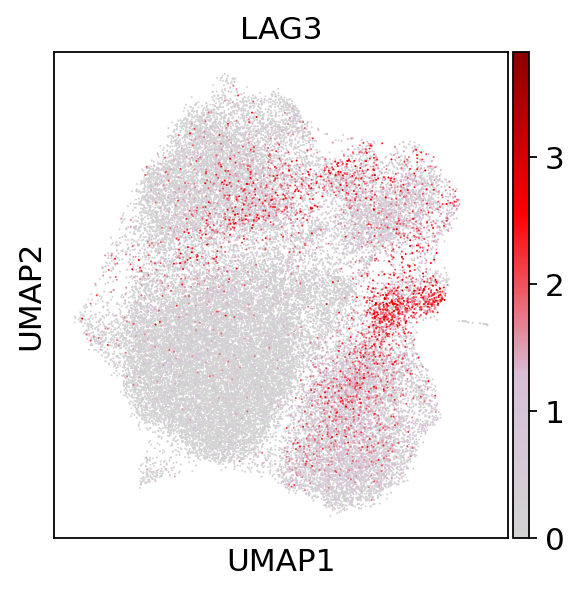

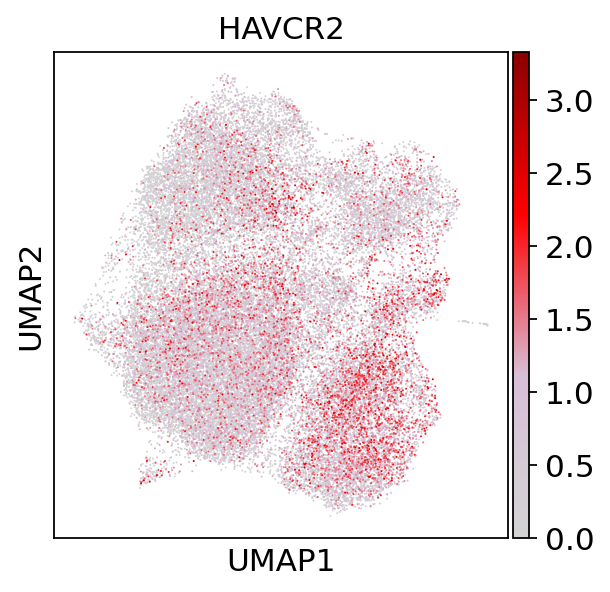

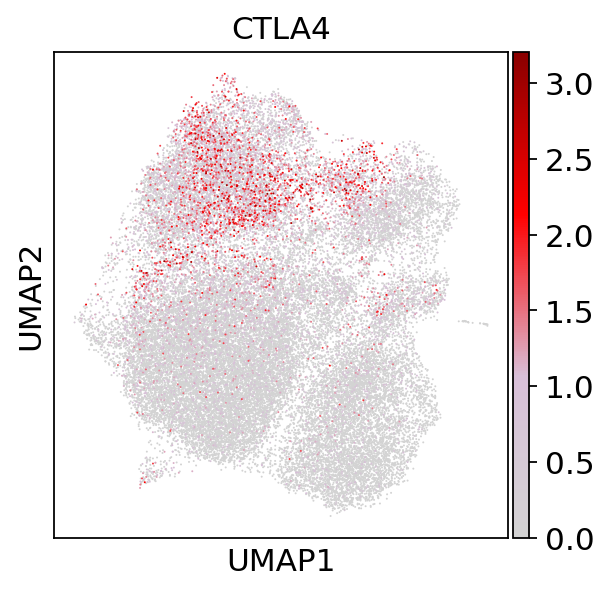

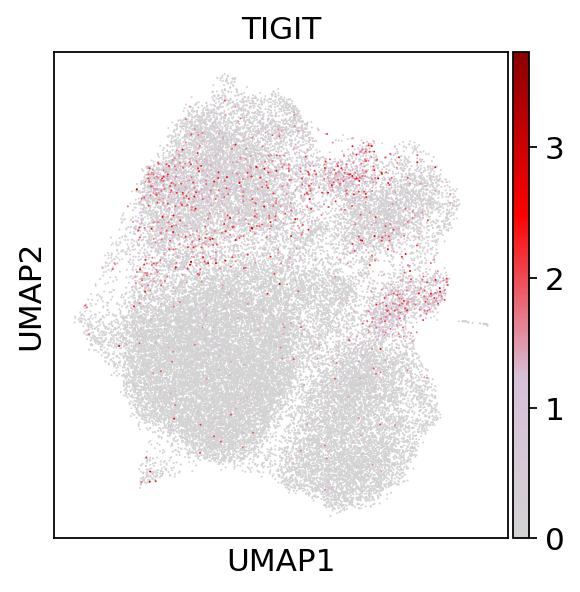

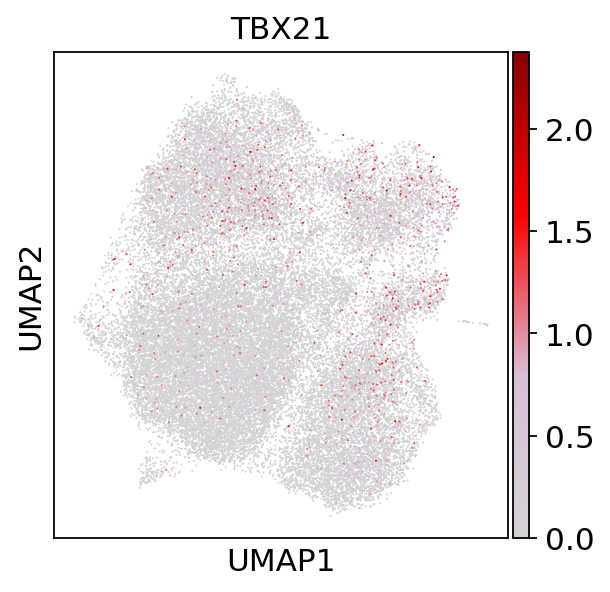

In [120]:
genes = ['LAG3', 'HAVCR2', 'CTLA4', 'TIGIT', 'TBX21']
for i in genes:
    sc.pl.umap(adata, color=i, color_map=cmap, save='_'+i+'.pdf')

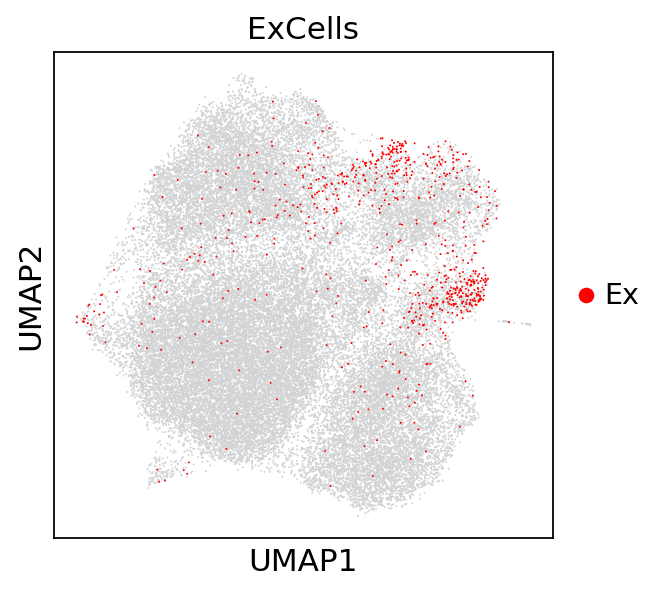

In [130]:
sc.pl.umap(adata, color='ExCells', groups=['Ex'], save='_ExCells.pdf')

In [3]:
adata.obs['ExCells'].value_counts()

Non-Ex    21350
Middle    15796
Ex          752
Name: ExCells, dtype: int64

In [4]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/ipykernel_launcher.py:84: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


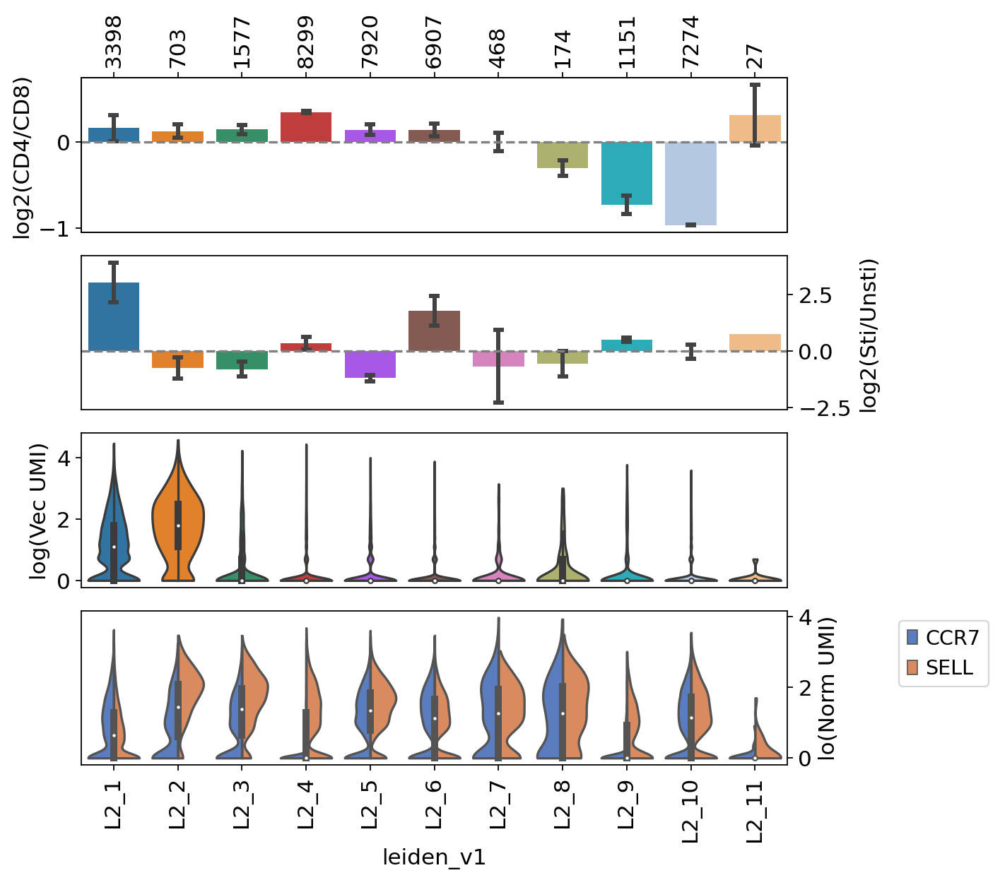

In [110]:
from matplotlib import gridspec
import seaborn as sns
fig = plt.figure(figsize=(8,8))
gs = gridspec.GridSpec(4, 1, height_ratios=[1, 1, 1, 1]) 
gs.update(wspace=0.025, hspace=0.15)
df = adata.obs[['leiden_v1', 'Donor', 'CD4/CD8', 'Condition', 'logVector', 'CT']]

df5 = pd.crosstab(adata.obs['leiden_v1'], adata.obs['CT'])
cellNum = df5.sum(axis=1).values

df2 = df[['leiden_v1', 'Donor', 'CD4/CD8']]
df2 = df2.groupby(['leiden_v1', 'Donor'])['CD4/CD8'].mean().replace([np.inf, -np.inf], np.nan).to_frame().reset_index()
ax0 = plt.subplot(gs[0])
sns.barplot(x='leiden_v1', y='CD4/CD8', data=df2, ci='sd',capsize=0.1, ax=ax0)
ax0.grid(False)
ax0.set_xticks([])
ax0.set_xlabel('')
ax0.set_ylabel('log2(CD4/CD8)')
ax0.axhline(0, c='grey', linestyle='--')
ax5 = ax0.twiny()
ax5.set_xlim(ax0.get_xlim())
plt.xticks(range(df5.shape[0]),cellNum,rotation=90)
ax5.grid(False)


df1 = df.groupby(['leiden_v1', 'Donor', 'Condition'])['Condition'].count().unstack()
df2 = np.log2(df1['Stimulated']/df1['Unstimulated']).replace([np.inf, -np.inf], np.nan).to_frame().reset_index()
ax1 = plt.subplot(gs[1])
sns.barplot(x='leiden_v1', y=0, data=df2, ci='sd',capsize=0.1, ax=ax1)
ax1.grid(False)
ax1.set_xticks([])
ax1.set_xlabel('')
ax1.set_ylabel('log2(Sti/Unsti)')
ax1.axhline(0, c='grey', linestyle='--')
ax1.yaxis.set_label_position('right')
ax1.yaxis.set_ticks_position('right')

ax2 = plt.subplot(gs[2])
sns.violinplot(x='leiden_v1', y='logVector', data=df, cut=0, scale='width', ax=ax2)
ax2.grid(False)
ax2.set_ylabel('log(Vec UMI)')
ax2.set_xticks([])
ax2.set_xlabel('')

df = pd.concat([pd.Series(list(adata.obs['leiden_v1'].values)), pd.DataFrame(adata.raw[:, ['CCR7', 'SELL']].X.toarray())], axis=1)
df.columns = ['leiden_v1', 'CCR7', 'SELL']
df = pd.melt(df, id_vars=['leiden_v1'], value_vars=['CCR7', 'SELL'])
df.columns = ['leiden_v1', 'Genes', 'value']
df['leiden_v1'] = df['leiden_v1'].astype('category')
df['leiden_v1'] = df['leiden_v1'].cat.reorder_categories(['L2_'+str(x+1) for x in range(11)])
ax3 = plt.subplot(gs[3])
sns.violinplot(x='leiden_v1', y='value', hue='Genes', data=df, palette='muted', split=True, cut=0, scale='width', ax=ax3)
ax3.grid(False)
ax3.set_ylabel('lo(Norm UMI)')
#ax3.set_xticks([])
#ax3.set_xlabel('')
ax3.yaxis.set_label_position('right')
ax3.yaxis.set_ticks_position('right')
ax3.legend(bbox_to_anchor=(1.3, 1))

# # numCells = np.log10(adata.obs['leiden_v1'].value_counts().sort_index().values)
# # ax3 = plt.subplot(gs[3])
# # ax3.scatter(range(len(numCells)), numCells, c='black')
# # ax3.grid(False)
# # ax3.set_ylim([0.5,4.5])
# # ax3.set_xticks([])
# # ax3.set_yticks([1,2,3,4])
# # ax3.set_xlabel('')
# # ax3.set_ylabel('log10(#Cells)')
# # ax3.yaxis.set_label_position('right')
# # ax3.yaxis.set_ticks_position('right')

# df5 = df5.div(df5.sum(axis=1),axis=0)
# df5 = -df5
# ax4 = plt.subplot(gs[4])
# df5.plot.bar(stacked=True, color=adata.uns['CT_colors'], edgecolor="black", ax=ax4)
# plt.yticks(np.arange(0, 101, 20)/-100, np.arange(100, -1, -20))
# ax4.grid(False)
# ax4.set_ylabel('% Cell Type')
# ax4.legend(bbox_to_anchor=(1, 0.8))

plt.xticks(rotation=90)

plt.tight_layout()
plt.savefig('./figures/Combplot_Tcells.pdf')

# Activation Signature

In [16]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [82]:
act_genes = np.genfromtxt('./DEres/Tcells_leiden_v1/L2_1vsAll_upG.txt', dtype=str)
print(len(act_genes))
act_genes[0:5]

844


array(['HSP90AB1', 'PKM', 'IL2RA', 'NME1', 'RAN'], dtype='<U13')

In [83]:
adata_act = anndata.AnnData(X=adata.raw.X, var=adata.raw.var, obs=adata.obs, obsp=adata.obsp, obsm=adata.obsm, uns=adata.uns)

In [84]:
adata_act = adata_act[:, act_genes].copy()

In [85]:
sc.pp.scale(adata_act)
sc.tl.pca(adata_act, svd_solver='arpack')

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:08)


In [86]:
from sklearn.metrics.pairwise import euclidean_distances
D_sub = euclidean_distances(adata_act.obsm['X_pca'], adata_act.obsm['X_pca'])

In [87]:
D_sub.shape

(37898, 37898)

In [95]:
cl = list(adata.obs['leiden_v1'].cat.categories)
saveD = {}
for i in cl:
    print(i)
    idx1 = adata.obs['leiden_v1'] == i
    idx2 = adata.obs['leiden_v1'] == 'L2_1'
    sub_mat = D_sub[idx1.values][:, idx2.values].flatten()
    saveD[i] = [np.mean(sub_mat), np.std(sub_mat)]

L2_1
L2_2
L2_3
L2_4
L2_5
L2_6
L2_7
L2_8
L2_9
L2_10
L2_11


In [101]:
df = pd.DataFrame.from_dict(saveD)

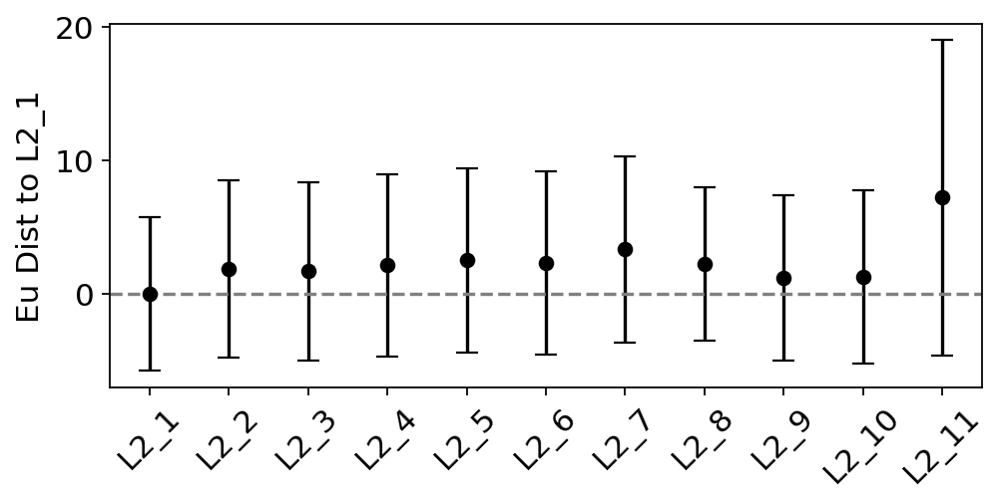

In [129]:
fig, ax = plt.subplots(figsize=(7,3))
ax.errorbar(range(df.shape[1]), df.iloc[0,:]-df.iloc[0,0], yerr=df.iloc[1,:], fmt='o', c='black',capsize =5)
ax.grid(False)
ax.axhline(0, c='grey', linestyle='--')
plt.xticks(range(df.shape[1]), cl, rotation=45)
ax.set_ylabel('Eu Dist to L2_1')
plt.savefig('./figures/Act_Dis.pdf')

plot out marker genes

In [37]:
Cmarkers = {#'CD14+ monocytes': ['CD14', 'LYZ'],
           #'FCGR3A+ monocytes': ['FCGR3A', 'MS4A7'],
           'cDC': ['FCER1A', 'CST3'], #Conventional dendritic cells
           #'Plasmacytoid dendritic cells': ['IL3RA', 'GZMB', 'SERPINF1', 'ITM2C'],
           #'B cells': ['CD79A', 'MS4A1'],
           'T cells': ['CD3D'],
           'CD4+ T cells': ['CD4'],
           'CD8+ T cells': ['CD8A'],
           'NK cells': ['GNLY', 'NKG7'],
           'Erythrocytes': ['HBB', 'HBA2']}

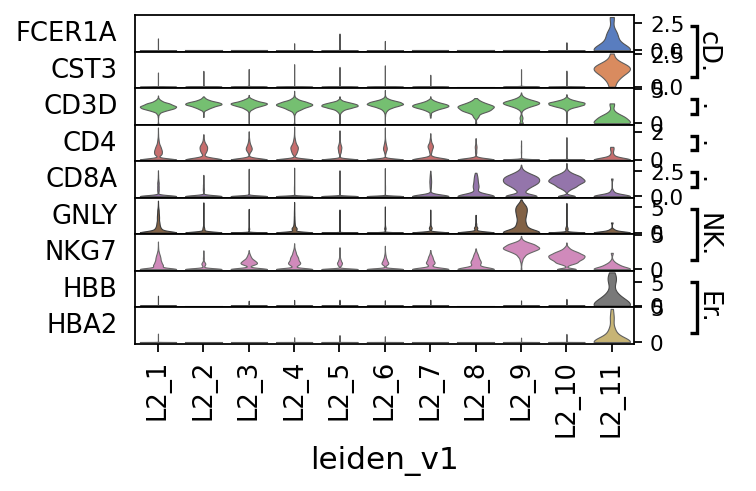

In [39]:
ax = sc.pl.stacked_violin(adata, var_names=Cmarkers, groupby='leiden_v1', swap_axes=True, save='_Tcells_markerGenes.pdf')

In [112]:
geneID = ['CD3E', 'CD8A', 'CCR7', 'SELL', 'IL2RA', 'GZMB', 'CCL5', 'NKG7', 'FOS', 'ISG15', 'ISG20', 'ATF4', 'CD74', 'HLA-DRA', 'FCER1A']

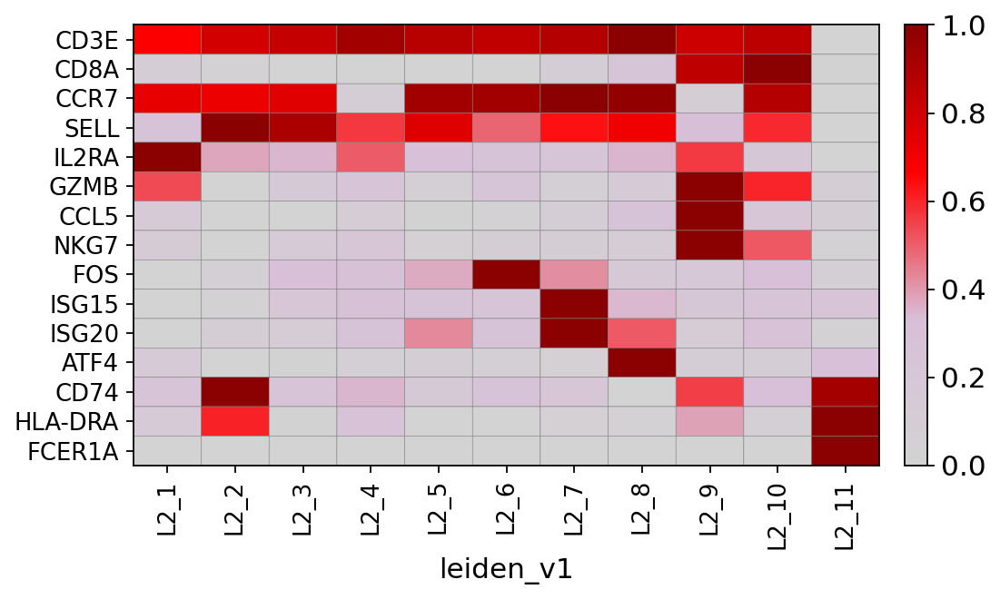

GridSpec(2, 3, height_ratios=[0, 4], width_ratios=[6.8, 0, 0.2])

In [122]:
sc.pl.matrixplot(adata, var_names=geneID, groupby='leiden_v1', cmap=cmap, swap_axes=True, figsize=(7,4), standard_scale='var',save='_Tcells_FernandoGeneList.pdf')

# QC

In [6]:
Tcells_data = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [2]:
Tcells_raw = sc.read('./write/Tcells_raw_afterQC.h5ad')

In [3]:
gene_mean = np.array([])
for column in Tcells_raw.X.T:
    if np.sum(column) != 0:
        gene_mean = np.append(gene_mean,np.mean(column[column!=0]))
gene_mean = np.log2(gene_mean)

In [7]:
vec = Tcells_data.obs['Vector']
vec_mean = np.mean(vec[vec!=0])
CD8A = Tcells_raw[:, 'CD8A'].X.toarray().flatten()
CD8A_mean = np.mean(CD8A[CD8A!=0])
CD4 = Tcells_raw[:, 'CD4'].X.toarray().flatten()
CD4_mean = np.mean(CD4[CD4!=0])
CD3D = Tcells_raw[:, 'CD3D'].X.toarray().flatten()
CD3D_mean = np.mean(CD3D[CD3D!=0])

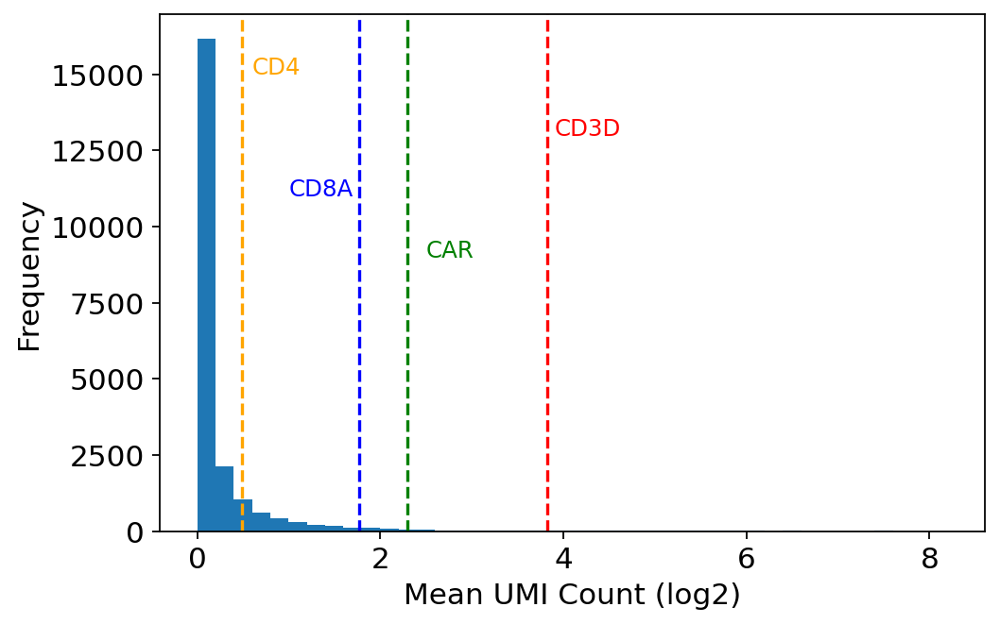

In [8]:
plt.figure(figsize=(7,4.5))
plt.hist(gene_mean, bins=np.arange(min(gene_mean), max(gene_mean) + 0.2, 0.2))
plt.xlabel("Mean UMI Count (log2)")
plt.ylabel("Frequency")
plt.axvline(np.log2(vec_mean), color='green', linestyle='--')
plt.axvline(np.log2(CD8A_mean), color='blue', linestyle='--')
plt.axvline(np.log2(CD3D_mean), color='red', linestyle='--')
plt.axvline(np.log2(CD4_mean), color='orange', linestyle='--')
plt.text(2.5, 9000, 'CAR',
        color='green', fontsize=11)
plt.text(1.0, 11000, 'CD8A',
        color='blue', fontsize=11)
plt.text(3.9, 13000, 'CD3D',
        color='red', fontsize=11)
plt.text(0.6, 15000, 'CD4',
        color='orange', fontsize=11)
plt.xlabel('Mean UMI Count (log2)')
plt.ylabel('Frequency')
plt.grid(False)
plt.savefig('./figures/Tcells_meanUMIcount.pdf')

In [9]:
gene_max = np.array([])
for column in Tcells_raw.X.T:
    if np.sum(column) != 0:
        gene_max = np.append(gene_max,np.max(column[column!=0]))
gene_max = np.log2(gene_max)

In [10]:
vec_max = np.max(vec[vec!=0])
CD8A_max = np.max(CD8A[CD8A!=0])
CD4_max = np.max(CD4[CD4!=0])
CD3D_max = np.max(CD3D[CD3D!=0])

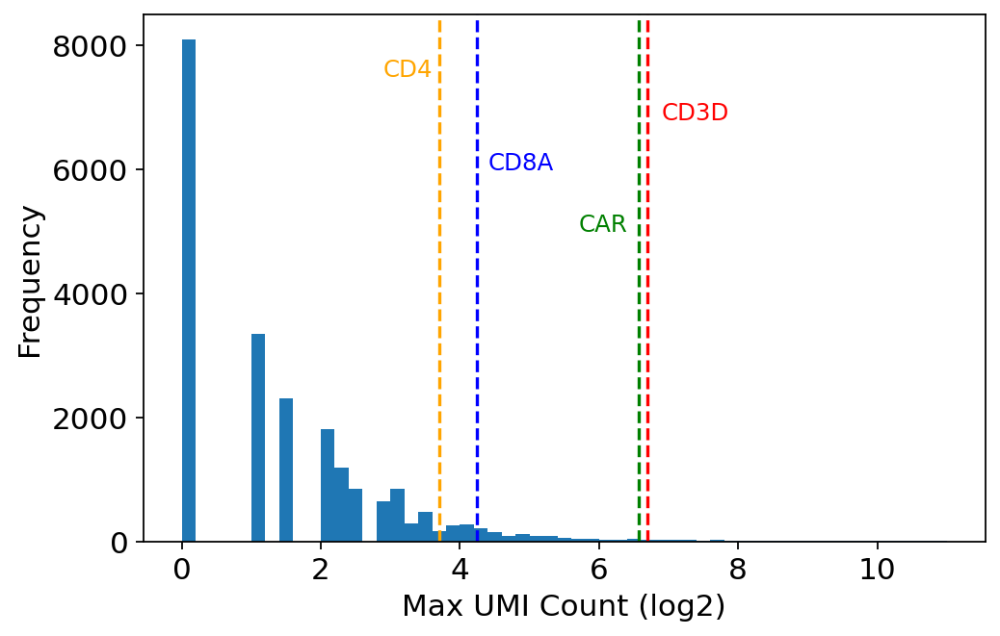

In [11]:
plt.figure(figsize=(7,4.5))
plt.hist(gene_max, bins=np.arange(min(gene_max), max(gene_max) + 0.2, 0.2))
plt.xlabel("Max UMI Count (log2)")
plt.ylabel("Frequency")
plt.axvline(np.log2(vec_max), color='green', linestyle='--')
plt.axvline(np.log2(CD8A_max), color='blue', linestyle='--')
plt.axvline(np.log2(CD3D_max), color='red', linestyle='--')
plt.axvline(np.log2(CD4_max), color='orange', linestyle='--')
plt.text(5.7, 5000, 'CAR',
        color='green', fontsize=11)
plt.text(4.4, 6000, 'CD8A',
        color='blue', fontsize=11)
plt.text(6.9, 6800, 'CD3D',
        color='red', fontsize=11)
plt.text(2.9, 7500, 'CD4',
        color='orange', fontsize=11)
plt.xlabel('Max UMI Count (log2)')
plt.ylabel('Frequency')
plt.grid(False)
plt.savefig('./figures/Tcells_maxUMIcount.pdf')

# PAGA connectivity check

Look at L2_6 vs L2_1

In [29]:
adata = sc.read('./write/Tcells_processed_regressedout.h5ad')

In [31]:
sc.tl.paga(adata, groups='leiden_v1')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:01)


--> added 'pos', the PAGA positions (adata.uns['paga'])


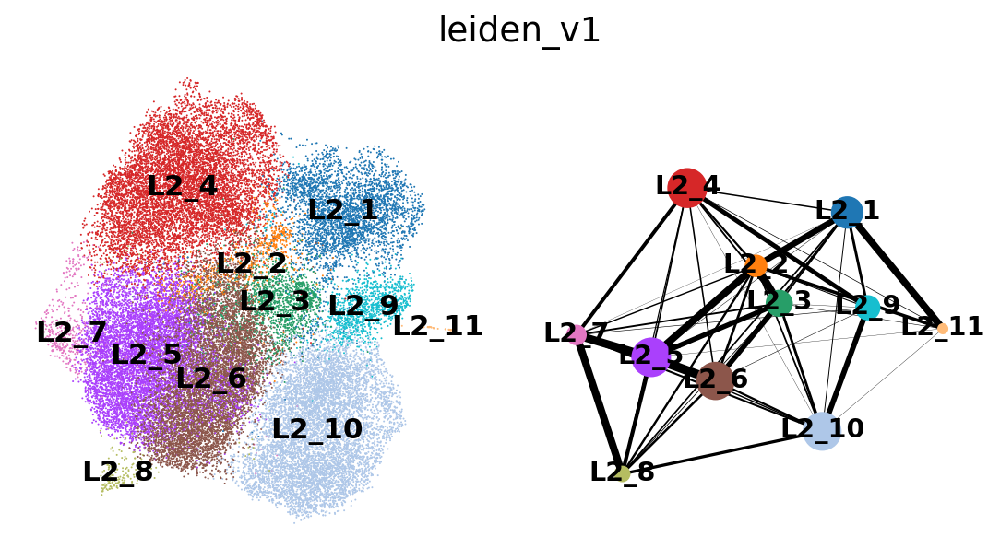

In [32]:
sc.pl.paga_compare(adata, basis='umap')

L2_1 cells: 3398
L2_6 cells: 6907
ranking genes
    finished: added to `.uns['DE_L2_1vsL2_6']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
(37898, 1104)
(37898, 21801)


/home/xw251/miniconda3/envs/scanpy_py368/lib/python3.6/site-packages/smqpp/__init__.py:716: RuntimeWarning: divide by zero encountered in log2
  logExp = np.log2(normExp)


upRegulated gene: 2182
downRegulated gene: 479


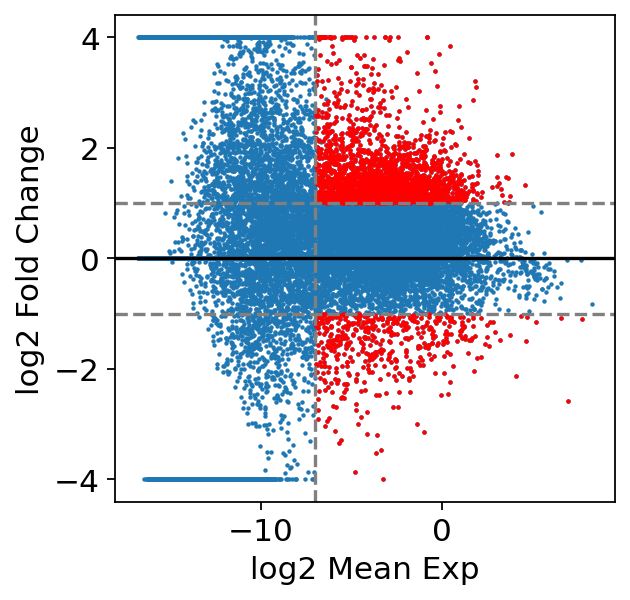

,Pathway,k,M,n,N,pval,OLGenes,padj
635,REACTOME_CELL_CYCLE,209,21801,588,2182,8.453176e-65,AHCTF1;AKT3;ANAPC1;ANKLE2;AURKA;AURKB;BIRC5;BR...,1.862235e-61
782,REACTOME_CELL_CYCLE_MITOTIC,176,21801,483,2182,2.473937e-56,AHCTF1;AKT3;ANAPC1;ANKLE2;AURKA;AURKB;BIRC5;BU...,2.725042e-53
888,REACTOME_METABOLISM_OF_RNA,171,21801,642,2182,3.103530e-34,ADAT2;ALYREF;APOBEC3B;BMS1;BYSL;CHERP;CNOT6;CS...,2.279026e-31


,Pathway,k,M,n,N,pval,OLGenes,padj
949,REACTOME_INTERFERON_ALPHA_BETA_SIGNALING,16,21801,56,479,4.275064e-14,EGR1;IFI6;IFIT1;IFIT2;IFIT3;IFITM1;IFITM2;IFIT...,9.417966e-11
1006,REACTOME_CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM,51,21801,762,479,1.623042e-12,ALOX5;ANXA1;B2M;CASP1;CISH;CNKSR1;CNN2;DDX58;D...,1.787781e-09
955,REACTOME_INTERFERON_SIGNALING,23,21801,177,479,8.327280e-12,B2M;DDX58;EGR1;GBP1;GBP3;GBP5;IFI6;IFIT1;IFIT2...,6.114999e-09


,Pathway,k,M,n,N,pval,OLGenes,padj
3081,GSE16450_IMMATURE_VS_MATURE_NEURON_CELL_LINE_DN,148,21801,188,2182,2.924068e-111,ABCF2;AGK;ALYREF;AMD1;AURKA;BCL2L1;C17ORF58;C1...,1.424606e-107
1519,GSE36476_CTRL_VS_TSST_ACT_40H_MEMORY_CD4_TCELL...,133,21801,190,2182,1.603309e-88,AIM2;AIMP2;ASPM;AURKB;BATF;BATF3;BIRC5;BRCA1;B...,3.905660e-85
1013,GSE22886_UNSTIM_VS_IL2_STIM_NKCELL_DN,125,21801,190,2182,4.257952e-78,ABCF2;ACACA;ALDH18A1;ASNS;AUNIP;BCCIP;BCL2L1;B...,6.914915e-75


,Pathway,k,M,n,N,pval,OLGenes,padj
4561,GSE42021_CD24HI_VS_CD24INT_TREG_THYMUS_DN,37,21801,184,479,5.448472e-25,B2M;CALCOCO2;CASP1;CTSL;CTSS;DDX58;DDX60;FLT3L...,1.989592e-21
209,GSE13485_PRE_VS_POST_YF17D_VACCINATION_PBMC_DN,37,21801,186,479,8.167456e-25,C1ORF162;C3AR1;CMPK2;CYSLTR1;DDX58;DDX60;DDX60...,1.989592e-21
191,GSE13485_CTRL_VS_DAY3_YF17D_VACCINE_PBMC_DN,36,21801,184,479,6.531514e-24,C1ORF162;C3AR1;CMPK2;CTSL;CYSLTR1;DDX58;DDX60;...,1.060718e-20


In [34]:
print("L2_1 cells: "+str(np.sum(adata.obs['leiden_v1']=='L2_1')))
print("L2_6 cells: "+str(np.sum(adata.obs['leiden_v1']=='L2_6')))
import smqpp
sc.tl.rank_genes_groups(adata, groupby='leiden_v1', reference='L2_6', groups=['L2_1'], n_genes=adata.raw.shape[1], key_added='DE_L2_1vsL2_6', method='t-test')
upG, downG, tableG = smqpp.plot_ma(adata, 'DE_L2_1vsL2_6', cidx=0, padj_cutoff=0.05, logFC_cutoff=1, exp_cutoff=-7)
np.savetxt('./DEres/Tcells_L2_1vsL2_6/L2_1vsL2_6_upG.txt', upG, delimiter='\t', fmt='%s')
np.savetxt('./DEres/Tcells_L2_1vsL2_6/L2_1vsL2_6_downG.txt', downG, delimiter='\t', fmt='%s')
tableG.to_csv('./DEres/Tcells_L2_1vsL2_6/L2_1vsL2_6_table.csv')

# pathway analysis c2
import smqpp
with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c2.all.v7.1.symbols.gmt') as f:
    DBcont = f.readlines()
    
DBcont = np.array(DBcont)
DBcont = DBcont[[(('BIOCARTA_' in x) | ('REACTOME_' in x) | ('PID_' in x) | ('KEGG_' in x) | ('HALLMARK_' in x)) for x in DBcont]]

TotalGenes = adata.raw.var_names

GL_up_pathway = smqpp.pathway_analysis(upG, TotalGenes, DBcont)
GL_down_pathway = smqpp.pathway_analysis(downG, TotalGenes, DBcont)

display(GL_up_pathway.head(3))
display(GL_down_pathway.head(3)) 

GL_up_pathway.to_csv('./Pathway/Tcells_L2_1vsL2_6/up_c2.csv')
GL_down_pathway.to_csv('./Pathway/Tcells_L2_1vsL2_6/down_c2.csv')

with open('/home/xw251/rds/rds-bg200-hphi-gottgens/users/xw251/Files/Pathway_DB/c7.all.v7.2.symbols.gmt') as f:
    DBcont = f.readlines()
    
GL_up_pathway = smqpp.pathway_analysis(upG, TotalGenes, DBcont)
GL_down_pathway = smqpp.pathway_analysis(downG, TotalGenes, DBcont)

display(GL_up_pathway.head(3))
display(GL_down_pathway.head(3))

GL_up_pathway.to_csv('./Pathway/Tcells_L2_1vsL2_6/up_c7.csv')
GL_down_pathway.to_csv('./Pathway/Tcells_L2_1vsL2_6/down_c7.csv')